# Preamble

## import

In [107]:
import os

import numpy as np

import nengo
from nengo.params import Default, NumberParam
from nengo.utils.matplotlib import rasterplot
from nengo.dists import Uniform
from nengo.solvers import LstsqL2, NoSolver
from nengo.neurons import *
from nengo.builder.neurons import *

from nengolib.signal import s, nrmse, LinearSystem
from nengolib.synapses import Lowpass

from hyperopt import fmin, tpe, hp, STATUS_OK, Trials

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(context='poster', style='whitegrid')
%matplotlib inline

## utilities

In [108]:
def norms(signal, freq, amp, ss, tau, t, dt=0.001, plot=False):
    lpf=nengo.Lowpass(tau)
    with nengo.Network() as model:
        if signal == 'cos':
            stim = nengo.Node(output=lambda t: amp*np.cos(freq*t))
        elif signal == 'white_noise':
            stim = nengo.Node(nengo.processes.WhiteSignal(period=t/2, high=freq, rms=amp, seed=ss))
        p_stim = nengo.Probe(stim, synapse=None)
        p_integral = nengo.Probe(stim, synapse=1/s)
    with nengo.Simulator(model, progress_bar=False, dt=dt) as sim:
        sim.run(t, progress_bar=False)
    stimulus = sim.data[p_stim]
    target = sim.data[p_integral]
    target_f = lpf.filt(sim.data[p_integral], dt=dt)
    norm_s = np.max(np.abs(stimulus))
    norm = np.max(np.abs(target))
    norm_f = np.max(np.abs(target_f))
    if plot:
        plt.plot(sim.trange(), stimulus, label='stim', alpha=0.5)
        plt.plot(sim.trange(), target, label='integral', alpha=0.5)
        plt.plot(sim.trange(), lpf.filt(sim.data[p_integral]/norm_f, dt=dt), label='target', alpha=0.5)
        plt.legend()
        plt.show()
    return norm, norm_s, norm_f

In [109]:
def get_ens_attr(n_neurons, seeds, max_rates_target, dim=1, neuron_type=nengo.LIF()):
    syn_enc = np.zeros((n_neurons, n_neurons))
    with nengo.Network(seed=seeds['ns']) as pre_model:
        lif = nengo.Ensemble(n_neurons, dim,
            max_rates=max_rates_target, neuron_type=neuron_type, seed=seeds['es'])
    sim = nengo.Simulator(pre_model, seed=seeds['ss'])
    e_target = sim.data[lif].encoders
    gains = sim.data[lif].gain
    biases = sim.data[lif].bias
    max_rates = sim.data[lif].max_rates
    intercepts = sim.data[lif].intercepts
    for n in range(n_neurons):
        # each synaptic encoder on neuron "n" is initialized identically
        syn_enc[n] = e_target[n] * np.ones((n_neurons, ))
    return syn_enc, gains, biases, max_rates, intercepts

In [110]:
def bin_activities_values_1d(
    xhat_pre,
    act_bio,
    x_min=-1,
    x_max=1,
    n_neurons=10,
    n_eval_points=20):

    def find_nearest(array,value):
        idx = (np.abs(array-value)).argmin()
        return idx

    x_bins = np.linspace(x_min, x_max, num=n_eval_points)
    hz_means = np.empty((n_neurons, n_eval_points))
    hz_stds = np.empty((n_neurons, n_eval_points))
    for i in range(n_neurons):
        bin_act = [[] for _ in range(x_bins.shape[0])]
        for t in range(act_bio.shape[0]):
            idx = find_nearest(x_bins, xhat_pre[t])
            bin_act[idx].append(act_bio[t, i])
        for x in range(len(bin_act)):
            hz_means[i, x] = np.average(bin_act[x])
            hz_stds[i, x] = np.std(bin_act[x])

    return x_bins, hz_means, hz_stds

In [111]:
def synaptic_weights(d, e):
    w = np.zeros((d.shape[0], d.shape[0]))
    for pre in range(d.shape[0]):
        w[:, pre] = d[pre] * e[:, pre]
    return w

In [112]:
def hyperopt_objective(hyps):
    num = 1  # constant term?
    den = 1  # constant term?
    for n in range(hyps['n_num']): # terms in transfer function's numerator
        num += s**(n+1) * hyps['%s_num'%n]
    for d in range(hyps['n_den']): # terms in transfer function's denominator
        den += s**(d+1) * hyps['%s_den'%d]  
    h = num / den
    h /= h.dcgain

    spikes = np.load(hyps['savefile'])['spikes'][:,::int(hyps['dt_sample']/hyps['dt'])]
    target = np.load(hyps['savefile'])['target']
    decoders = np.load(hyps['savefile'])['decoders']
    A_stack = np.zeros((spikes.shape[1]*(hyps['r']), hyps['n_neurons']))
    for n in range(hyps['r']):
        A_stack[n*spikes.shape[1]:(n+1)*spikes.shape[1]] = h.filt(spikes[n], dt=hyps['dt'])
#     xhat = np.dot(A_stack, decoders)
    xhat = np.dot(h.filt(spikes[-1], dt=hyps['dt']), decoders)
    if np.sum(target) != 0:
        loss = nrmse(xhat, target=target)
    else:
        loss = 0.0

    return {'loss': loss, 'h': h, 'status': STATUS_OK }

# Wilson Neuron

In [113]:
import os

import numpy as np

import nengo
from nengo.params import Default, NumberParam
from nengo.dists import Uniform
from nengo.neurons import *
from nengo.builder.neurons import *

__all__ = ['WilsonNeuron']


class WilsonNeuron(NeuronType):
    """
    Wilson Neuron Model.
    
    Description
    -----------
    
    TODO
    
    Paramters
    ---------

    TODO
    
    References
    ----------
    [1] Wilson, Hugh R. "Simplified dynamics of human and mammalian neocortical neurons."
        Journal of theoretical biology 200.4 (1999): 375-388.

    
    """
    
    probeable = ('spikes', 'voltage', 'recovery', 'conductance', 'AP')
    threshold = NumberParam('threshold')
    tau_V = NumberParam('tau_V')
    tau_R = NumberParam('tau_R')
    tau_H = NumberParam('tau_H')
    
    def __init__(self, threshold=-0.20, tau_V=0.00097, tau_R=0.0056, tau_H=0.0990):
        super(WilsonNeuron, self).__init__()
        self.threshold = threshold
        self.tau_V = tau_V
        self.tau_R = tau_R
        self.tau_H = tau_H
        
    @property
    def _argreprs(self):
        args = []
        def add(attr, default):
            if getattr(self, attr) != default:
                args.append("%s=%s" %(attr, getattr(self, attr)))
        add("threshold", -0.20)
        add("tau_V", 0.00097)
        add("tau_R", 0.0056)
        add("tau_H", 0.0990)
        return args
        
    def rates(self, x, gain, bias):
        return x  # todo

    def max_rates_intercepts(self, gain, bias):
        max_rates = self.rates(np.ones_like(gain), gain, bias)
        x_range = np.linspace(-1, 1, 101)
        rates = np.asarray([self.rates(np.ones_like(gain) * x, gain, bias)
                            for x in x_range])
        last_zeros = np.maximum(np.argmax(rates > 0, axis=0) - 1, 0)
        intercepts = x_range[last_zeros]
        return max_rates, intercepts
    
    def step_math(self, dt, J, spiked, voltage, recovery, conductance, AP):

        dV = -(17.81 + 47.58*voltage + 33.80*np.square(voltage))*(voltage - 0.48) - 26*recovery*(voltage + 0.95) - 13*conductance*(voltage + 0.95) + J
        dR = -recovery + 1.29*voltage + 0.79 + 3.30*np.square(voltage + 0.38)
        dH = -conductance + 11*(voltage + 0.754)*(voltage + 0.69)
        
        voltage[:] = (voltage + dV * dt/self.tau_V).clip(-0.9, 0.3)
        recovery[:] = (recovery + dR * dt/self.tau_R)  # .clip(0.18, 0.42)
        conductance[:] = (conductance + dH * dt/self.tau_H)  # .clip(0, 0.23)
        spiked[:] = (voltage > self.threshold) & (~AP)
        spiked /= dt
        AP[:] = voltage > self.threshold


@Builder.register(WilsonNeuron)
def build_wilsonneuron(model, neuron_type, neurons):
    model.sig[neurons]['voltage'] = Signal(
        -0.754*np.ones(neurons.size_in), name="%s.voltage" % neurons)
    model.sig[neurons]['recovery'] = Signal(
        0.279*np.ones(neurons.size_in), name="%s.recovery" % neurons)
    model.sig[neurons]['conductance'] = Signal(
        0.0*np.ones(neurons.size_in), name="%s.conductance" % neurons)
    model.sig[neurons]['AP'] = Signal(
        np.zeros(neurons.size_in, dtype=bool), name="%s.AP" % neurons)
    model.add_op(SimNeurons(
        neurons=neuron_type,
        J=model.sig[neurons]['in'],
        output=model.sig[neurons]['out'],
        states=[model.sig[neurons]['voltage'],
            model.sig[neurons]['recovery'],
            model.sig[neurons]['conductance'],
            model.sig[neurons]['AP']]))

# Network

In [114]:
def simulate(  
    w,
    w_pre,
    d,
    d_pre,
    gains,
    biases,
    h,
    n_unroll,
    t=1,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    signal='cos',
    freq=1,
    amp=1,
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    neuron_type=nengo.LIF(),
    max_rates=Default,
    **kwargs):
    
    # transform input signal u so that the integral x is normalized to np.max(x)==1
    norm, norm_s, norm_f = norms(signal, freq, amp, seeds['ss'], taus['network'], t, dt=dt, plot=False)
    
    # Simulate the full network, skipping simulation of supv or bio when possible.
    with nengo.Network(seed=seeds['ns']) as model:

        # Nodes
        model.T = t
        def flip(t, x):
            if t<model.T/2: return x
            elif t>=model.T/2: return -1.0*x
        if signal == 'cos':
            u_raw = nengo.Node(output=lambda t: amp*np.cos(freq*t))
        elif signal == 'white_noise':
            u_raw = nengo.Node(nengo.processes.WhiteSignal(period=model.T/2, high=freq, rms=amp, seed=seeds['ss']))
        u = nengo.Node(output=flip, size_in=1)
                                              
        # Ensembles
        pre_u = nengo.Ensemble(n_neurons, 1, max_rates=max_rates, seed=seeds['es'], radius=norm_s)
        pre_x = nengo.Ensemble(n_neurons, 1, max_rates=max_rates, seed=seeds['es'], radius=norm)
        ens_list = [pre_x]
        for r in range(n_unroll):
            ens_list.append(
                nengo.Ensemble(n_neurons, 1,
                    gain=gains, bias=biases,
                    neuron_type=neuron_type, seed=seeds['es'], label='%s'%r))
        unsupv = nengo.Ensemble(n_neurons, 1,
            gain=gains, bias=biases,
            neuron_type=neuron_type, seed=seeds['es'], label='unsupv')
        lif = nengo.Ensemble(n_neurons, 1, max_rates=max_rates, neuron_type=nengo.LIF(), seed=seeds['es'])
        tar = nengo.Ensemble(1, 1, neuron_type=nengo.Direct())

        # normal connections
        nengo.Connection(u_raw, u, synapse=None, seed=seeds['cs'])
        nengo.Connection(u, pre_u, synapse=None, seed=seeds['cs'])
        nengo.Connection(u, tar, synapse=1/s, transform=1.0/norm_f)
        nengo.Connection(pre_u, lif, synapse=taus['network'], transform=taus['network']/norm_f)
        nengo.Connection(lif, lif, synapse=taus['network'])
        
        # supervised connections
        for r in range(n_unroll+1):
            if r == 0:
                nengo.Connection(u, ens_list[0],
                    synapse=1/s,
                    seed=seeds['cs'])
            else:
                nengo.Connection(pre_u, ens_list[r],
                    synapse=taus['network'],
                    transform=taus['network']/norm_f,
                    seed=seeds['cs'])
        for r in range(n_unroll):
            if r == 0:
                nengo.Connection(ens_list[0].neurons, ens_list[1].neurons,
                    transform=w_pre,
                    synapse=h,
                    seed=seeds['cs'])
#                 nengo.Connection(ens_list[0], ens_list[1],
#                     solver=NoSolver(w_pre, weights=True),
#                     synapse=h,
#                     seed=seeds['cs'])
            else:
                nengo.Connection(ens_list[r].neurons, ens_list[r+1].neurons,
                    transform=w,
                    synapse=h,
                    seed=seeds['cs'])
#                 nengo.Connection(ens_list[r], ens_list[r+1],
#                     solver=NoSolver(w, weights=True),
#                     synapse=h,
#                     seed=seeds['cs'])
        
        # unsupervised connections (test)
        nengo.Connection(pre_u, unsupv,
            synapse=taus['network'],
            transform=taus['network']/norm_f,
            seed=seeds['cs'])
        nengo.Connection(unsupv.neurons, unsupv.neurons,
            transform=w,
            synapse=h,
            seed=seeds['cs'])
#         nengo.Connection(unsupv, unsupv,
#             solver=NoSolver(w, weights=True),
#             synapse=h,
#             seed=seeds['cs'])

        # probes (down sample to dt_sample in post-processing for spiking ensembles)
        p_stim = nengo.Probe(u, synapse=None, sample_every=dt)
        p_target = nengo.Probe(tar, synapse=None, sample_every=dt)
        p_spk_list = []
        for r in range(n_unroll+1):
            p_spk_list.append(nengo.Probe(ens_list[r].neurons, synapse=None, sample_every=dt))
        p_spk_unsupv = nengo.Probe(unsupv.neurons, synapse=None, sample_every=dt)
        p_spk_lif = nengo.Probe(lif.neurons, synapse=None, sample_every=dt)
        p_lif = nengo.Probe(lif, synapse=taus['readout'], sample_every=dt)
        

    # Run the simulation
    with nengo.Simulator(model, seed=seeds['ss'], dt=dt, progress_bar=False) as sim:
        sim.run(t, progress_bar=True)
        
    spk_list = [sim.data[p_spk_list[r]] for r in range(n_unroll+1)]
        
    return sim.data[p_stim], sim.data[p_target], spk_list, sim.data[p_spk_unsupv], sim.data[p_spk_lif], sim.data[p_lif]

## Decoder, Encoder, and Filter Learning

In [115]:
def train(
    d,
    e,
    h,
    n_unroll,
    stim_data,
    target_data,
    spk_list_data,
    spk_unsupv_data,
    lif_spk_data,
    lif_data,
    n_neurons=100,
    reg=1e-2,
    eta=1e-5,
    taus={'network': 0.1, 'readout': 0.1},
    dt=0.001,
    dt_sample=0.001,
    n_num=1,
    n_den=3,
    num_min=2, 
    num_max=3, 
    den_min=1, 
    den_max=2, 
    max_evals=100,
    update=None,
    plot=False,
    **kwargs):
    
    ''' Collect spikes, activities and lif estimates '''
    lpf = nengo.Lowpass(taus['readout'])
    stim = lpf.filt(stim_data, dt=dt)[::int(dt_sample/dt)]
    target = lpf.filt(target_data, dt=dt)[::int(dt_sample/dt)]
    a_target = lpf.filt(lif_spk_data, dt=dt)[::int(dt_sample/dt)]
    times = dt_sample * np.arange(0, len(target), 1)
    A = np.zeros((n_unroll+1, target.shape[0], n_neurons))  # (unrollings, times, neurons)
    S = np.array([spk_list_data[n] for n in np.arange(1, n_unroll+1)])
    A_stack = np.zeros((n_unroll*times.shape[0], n_neurons))  # stack all unrollings after pre_x=lif into 1d
    A_unsupv = h.filt(spk_unsupv_data, dt=dt)[::int(dt_sample/dt)]  # unsupervised activities
    Y_stack = np.zeros((n_unroll*times.shape[0], 1))
    for r in range(n_unroll+1):
        A[r] = h.filt(spk_list_data[r], dt=dt)[::int(dt_sample/dt)]
    for r in range(n_unroll):
        A_stack[r*len(times):(r+1)*len(times)] = A[r+1]
        Y_stack[r*len(times):(r+1)*len(times)] = np.array(target)
    # observed tuning curves
    x_bins_first, hz_means_first, hz_stds_first = bin_activities_values_1d(
        target, A[0], n_neurons=n_neurons)
    x_bins_last, hz_means_last, hz_stds_last = bin_activities_values_1d(
        target, A[-1], n_neurons=n_neurons)
    x_bins_unsupv, hz_means_unsupv, hz_stds_unsupv = bin_activities_values_1d(
        target, A_unsupv, n_neurons=n_neurons)

    ''' update encoders, decoders, and/or filters '''
    rng = np.random.RandomState(seed=kwargs['seeds']['ls'])
    d_new = d
    e_new = e
    h_new = h

    d_pre = LstsqL2(reg=reg)(A[0], target)[0]
    if update == "d_stack" and n_unroll > 0:  # activities from all unrollings
        d_new = LstsqL2(reg=reg)(A_stack, Y_stack)[0]
    elif update == "d_last" and n_unroll > 0:  # activities from last unrolling
        d_new = LstsqL2(reg=reg)(A[-1], target)[0]
    
    # plot estimates with old decoders
    xhat_lif = lif_data[::int(dt_sample/dt)]
    nrmse_lif = nrmse(xhat_lif, target=target)
    xhats = np.zeros((n_unroll+1, times.shape[0], 1))
    nrmses = np.zeros((n_unroll+1))
    for r in range(n_unroll+1):
        if r == 0:  # use d_pre
            xhats[r] = np.dot(A[r], d_pre)
        else:  # use d
            xhats[r] = np.dot(A[r], d)
        nrmses[r] = nrmse(xhats[r], target=target)
    xhat_unsupv = np.dot(A_unsupv, d)
    nrmse_unsupv = nrmse(xhat_unsupv, target=target)
    
    times_sparse = np.arange(0, len(target), 10)
    if update == 'e_stack':
        for t in times_sparse:
            for n in range(n_neurons):
                a_error = np.average(A[1:, t, n] - np.ones((n_unroll))*a_target[t, n])
                delta = eta * np.abs(a_error)  # fixed update
                # todo: handle encoder learning on r0-r1
                for pre in range(n_neurons):
                    if a_error > 0 and d[pre] >= 0:  # overactive, positive dec => reduce enc reduce weight
                        e_new[n, pre] -= delta
                    elif a_error > 0 and d[pre] < 0:  # overactive, negative dec => increase enc reduce weight
                        e_new[n, pre] += delta
                    elif a_error < 0 and d[pre] >= 0:  # underactive, positive dec => increase enc increase weight
                        e_new[n, pre] += delta
                    elif a_error < 0 and d[pre] < 0:  # underactive, negative dec => reduce enc increase weight
                        e_new[n, pre] -= delta
    elif update == 'e_last':
        for t in times_sparse:
            for n in range(n_neurons):
                a_error = A[-1, t, n] - a_target[t, n]
                delta = eta * np.abs(a_error)  # fixed update
                # todo: handle encoder learning on r0-r1
                for pre in range(n_neurons):
                    if a_error > 0 and d_pre[pre] >= 0:  # overactive, positive dec => reduce enc reduce weight
                        e_new[n, pre] -= delta
                    elif a_error > 0 and d_pre[pre] < 0:  # overactive, negative dec => increase enc reduce weight
                        e_new[n, pre] += delta
                    elif a_error < 0 and d_pre[pre] >= 0:  # underactive, positive dec => increase enc increase weight
                        e_new[n, pre] += delta
                    elif a_error < 0 and d_pre[pre] < 0:  # underactive, negative dec => reduce enc increase weight
                        e_new[n, pre] -= delta
                        
    w = synaptic_weights(d_new, e_new)
    w_pre = synaptic_weights(d_pre, e_new)
        
    if update == "h":
        savefile = "/home/pduggins/nengo_bioneurons/nengo_bioneurons/tests/data/trinity/stacked_spikes_targets.npz"
        np.savez(savefile, spikes=S, target=Y_stack, decoders=d)
        hyps = dict(
            savefile=savefile,
            n_num=n_num,
            n_den=n_den,
            r=n_unroll,
            n_neurons=n_neurons,
            dt=dt,
            dt_sample=dt_sample)
        for num in range(n_num):  
            hyps['%s_num'%num] = hp.uniform('%s_num'%num, num_min, num_max)
        for den in range(n_den):
            hyps['%s_den'%den] = hp.uniform('%s_den'%den, den_min, den_max)
        trials = Trials()
        best = fmin(hyperopt_objective,
            rstate=np.random.RandomState(seed=kwargs['seeds']['ss']+r),
            space=hyps,
            algo=tpe.suggest,
            max_evals=max_evals,
            trials=trials)
        best_idx = np.array(trials.losses()).argmin()
        h_new = trials.trials[best_idx]['result']['h']

    ''' Plot 'em, mash 'em, stick 'em in a stew: filters, tuning curve match, decoded values'''
    if plot:
        impulse_time = np.arange(0, 1, 0.001)
        fig, ax = plt.subplots(1, 1, figsize=(8, 4))
        ax.plot(impulse_time, Lowpass(taus['readout']).impulse(len(impulse_time)), label='lowpass')
        ax.plot(impulse_time, h_new.impulse(len(impulse_time)), label='optimized')
        ax.legend()
        plt.tight_layout()
        plt.show()
        
#         fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 16), sharex=True)
#         times_spk = dt_sample * np.arange(0, len(spk_list_data[-1]), 1)
#         rasterplot(times_spk, spk_list_data[-1], ax=ax1)
#         rasterplot(times_spk, spk_unsupv_data, ax=ax2)
#         ax1.set(xlabel='time', ylabel='neuron', title='last unroll')
#         ax2.set(xlabel='time', title='unsupv')
#         plt.tight_layout()
        
        cmap = sns.color_palette('hls', 10)
        a_error_unsupv = np.average(np.abs(A_unsupv - A[0]))
        a_error_last = np.average(np.abs(A[-1] - A[0]))
        fig, (ax4, ax5, ax6) = plt.subplots(1, 3, figsize=(12, 8), sharey=True)
        for n in range(10):  # n_neurons
            ax4.plot(x_bins_first, hz_means_first[n], c=cmap[n])
            ax4.fill_between(x_bins_first,
                hz_means_first[n]+hz_stds_first[n],
                hz_means_first[n]-hz_stds_first[n],
                alpha=0.5, facecolor=cmap[n])
            ax5.plot(x_bins_last, hz_means_last[n], c=cmap[n])
            ax5.fill_between(x_bins_last,
                hz_means_last[n]+hz_stds_last[n],
                hz_means_last[n]-hz_stds_last[n],
                alpha=0.5, facecolor=cmap[n])
            ax6.plot(x_bins_unsupv, hz_means_unsupv[n], c=cmap[n])
            ax6.fill_between(x_bins_unsupv,
                hz_means_unsupv[n]+hz_stds_unsupv[n],
                hz_means_unsupv[n]-hz_stds_unsupv[n],
                alpha=0.5, facecolor=cmap[n])

        ax4.set(xlim=((-1,1)), xlabel='$\mathbf{x}$', ylabel='activity (Hz)',
            title='first unroll \n (target)')
        ax5.set(xlim=((-1,1)), xlabel='$\mathbf{x}$', title='last unroll \n rmse=%.3f' %a_error_last)
        ax6.set(xlim=((-1,1)), xlabel='$\mathbf{x}$', title='unsupv \n rmse=%.3f' %a_error_unsupv)
        plt.tight_layout()

        cmap = sns.color_palette('hls', r)
        fig, ax = plt.subplots(1, 1, figsize=(8, 4))
        ax.plot(times, target, label='target', linestyle='--')
        ax.plot(times, xhat_lif, alpha=0.5, label='lif, nrmse=%.3f' %nrmse_lif)
        for n in range(r+1):
            ax.plot(times, xhats[n], alpha=0.5, label='unroll %s, nrmse=%.3f' %(n, nrmses[n]))
        ax.plot(times, xhat_unsupv, label='unsupervised, nrmse=%.3f' %nrmse_unsupv)
#         if d_JL.shape[1] > 0:
#             ax.plot(times, np.dot(A_unsupv, d_JL), label='JL dim')
        ax.set(xlabel='time', ylabel='$\mathbf{x}$')
        ax.legend(loc='lower left')
        plt.tight_layout()
        plt.show()

#         fig, ax1 = plt.subplots(1, 1, figsize=(8, 4))
#         for n in range(r+1):
#             sns.distplot(np.ravel(A[n]), ax=ax1, label='%s unrolling' %n)
#         sns.distplot(np.ravel(A_unsupv), ax=ax1, label='unsupervised', hist=True)
#         ax1.set(xlim=((1, 400)), ylim=((0, 0.03)), xlabel='firing rate (Hz)', ylabel='frequency')
#         plt.legend()
#         plt.tight_layout()

    return d_new, d_pre, e_new, w, w_pre, h_new

## Control Structure

In [116]:
def run(updates, plot=False, signal='cos', **kwargs):
    
    rng = np.random.RandomState(seed=kwargs['seeds']['ls'])
    d = np.zeros((kwargs['n_neurons'], 1))
    d_pre = np.zeros((kwargs['n_neurons'], 1))
    h = Lowpass(kwargs['taus']['readout'])
    n_unroll = 0

    e, gains, biases, max_rates, intercepts = get_ens_attr(
        kwargs['n_neurons'], kwargs['seeds'], kwargs['max_rates'])
    gains *= kwargs['alpha']
    biases *= kwargs['beta']
    
    w = synaptic_weights(d, e)
    w_pre = synaptic_weights(d_pre, e)
            
    for update in updates:
        print("updating %s" %update)
        if update == 'r':
            n_unroll += 1
            continue
        sd, td, sld, sud, lsd, ld = simulate(
            w, w_pre, d, d_pre, gains, biases, h, n_unroll, signal=signal, **kwargs)
        d, d_pre, e, w, w_pre, h = train(
            d, e, h, n_unroll, sd, td, sld, sud, lsd, ld, update=update, plot=plot, **kwargs)
        
    print("testing")
    kwargs['seeds']['ss'] = kwargs['seeds']['ss'] + 1
    sd, td, sld, sud, lsd, ld = simulate(
        w, w_pre, d, d_pre, gains, biases, h, 1, signal='white_noise', **kwargs)
    _, _, _, _, _, _ = train(
        d, e, h, 1, sd, td, sld, sud, lsd, ld, plot=True, **kwargs)    
    
    return d, d_pre, e, w, w_pre, h

# Simulations

## LIF

### decoder

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

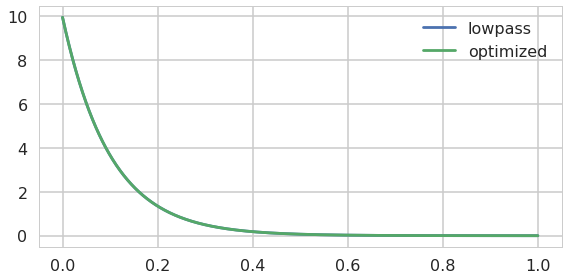

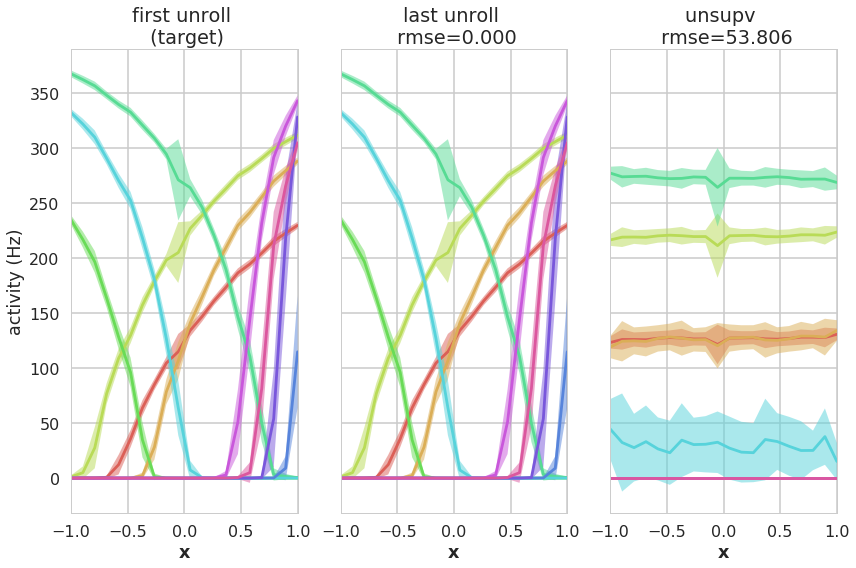

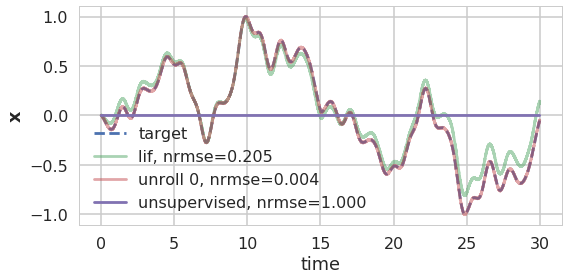

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

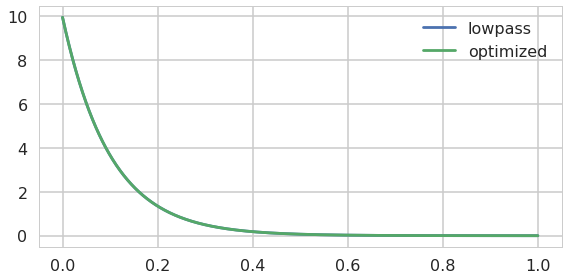

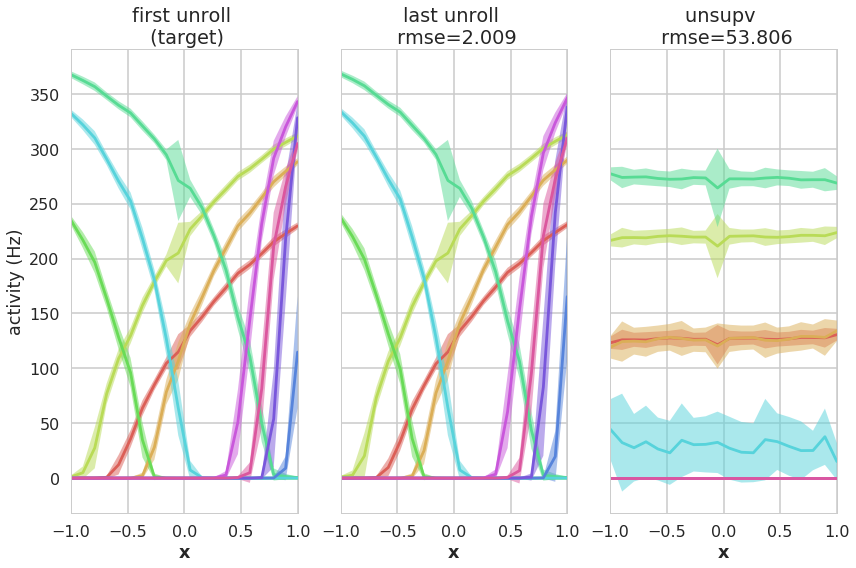

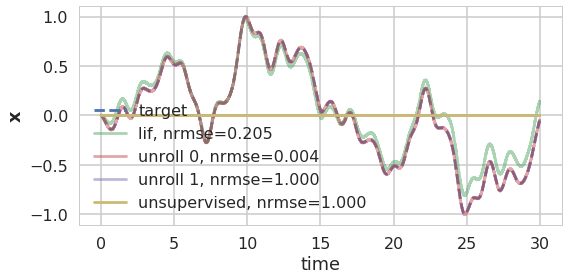

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

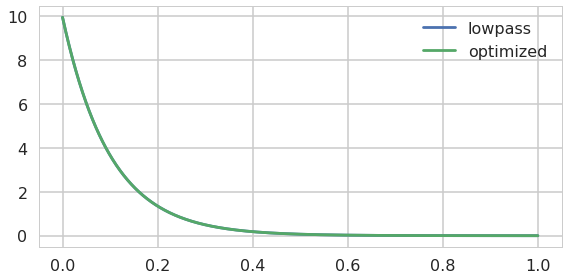

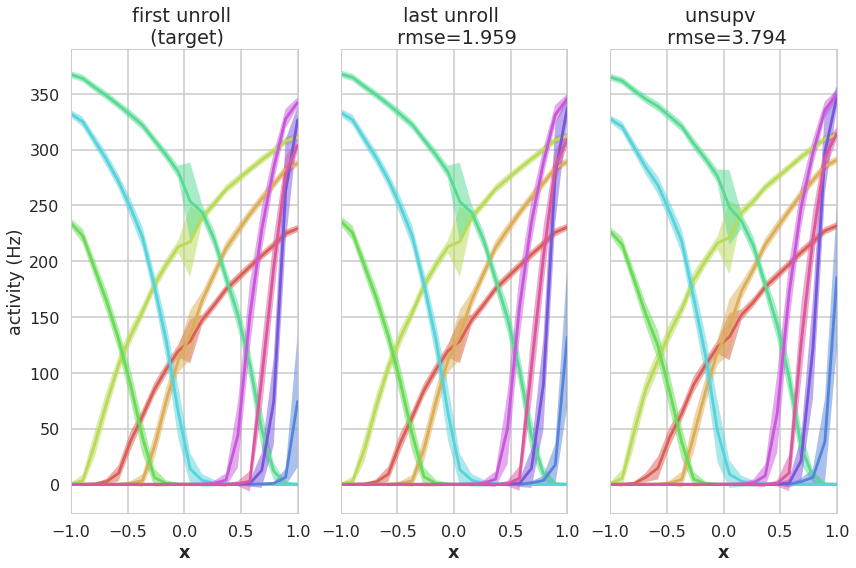

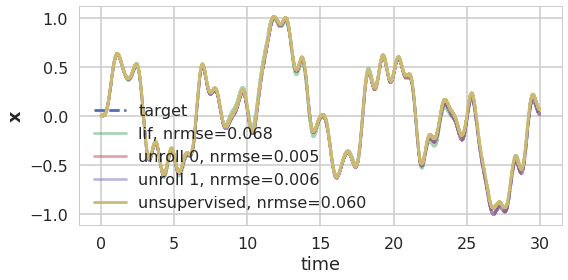

In [94]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### encoder

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

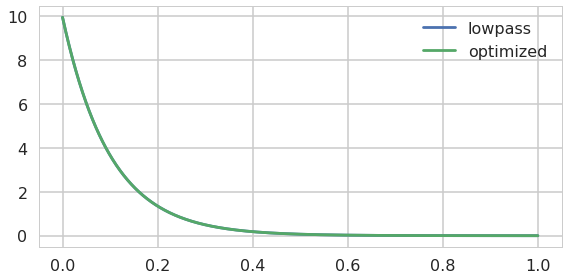

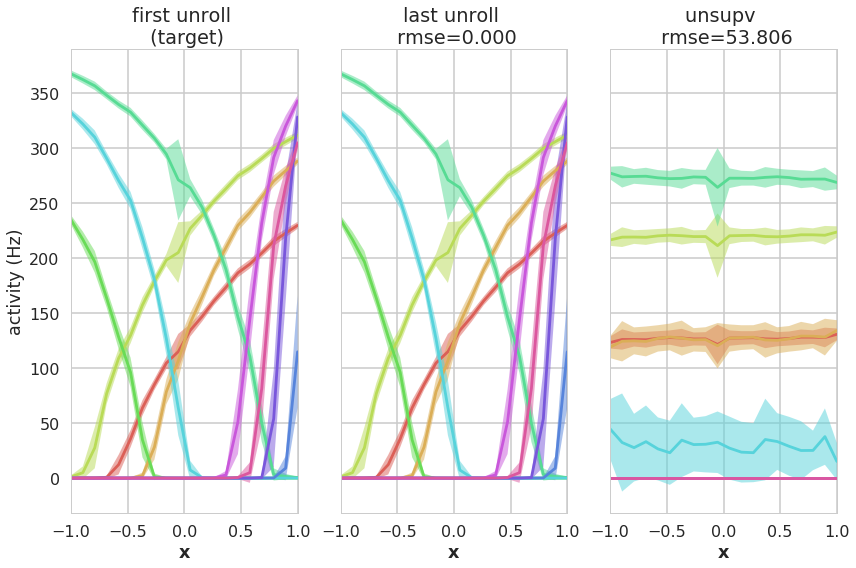

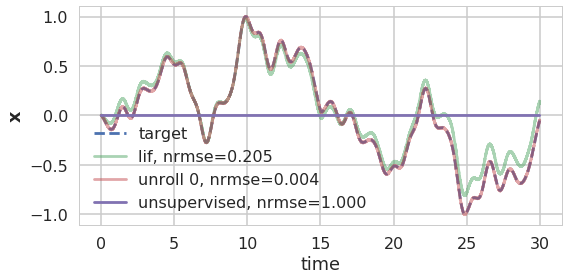

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

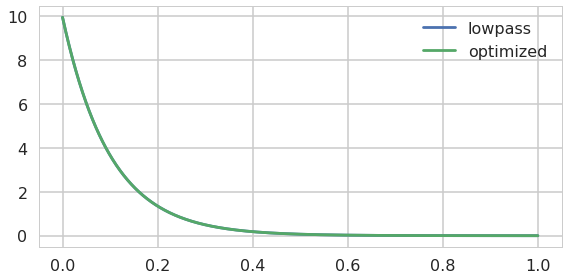

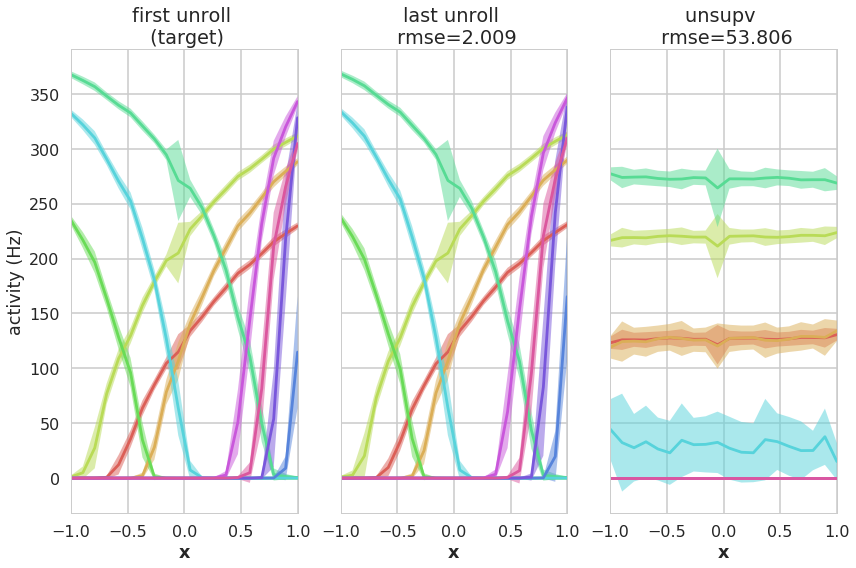

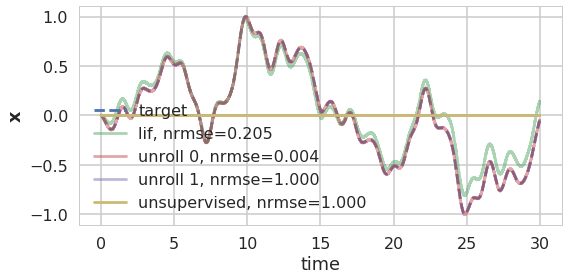

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

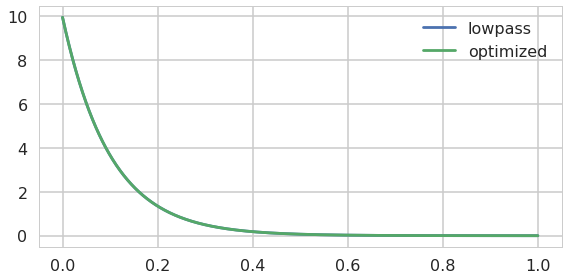

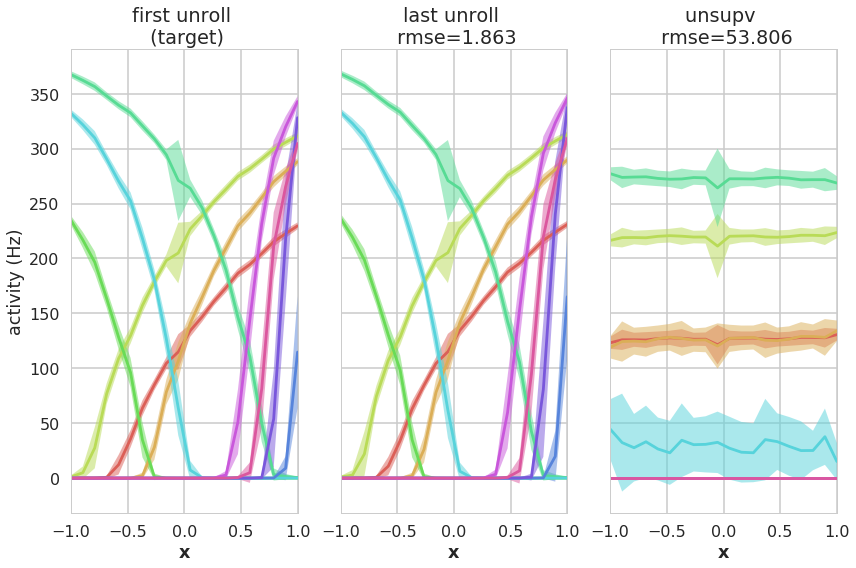

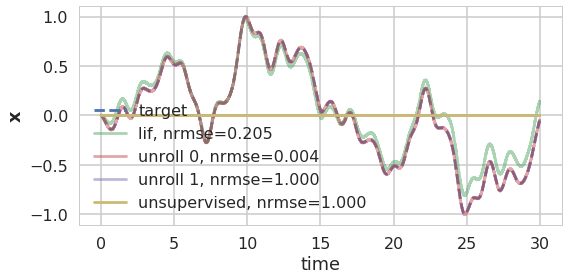

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

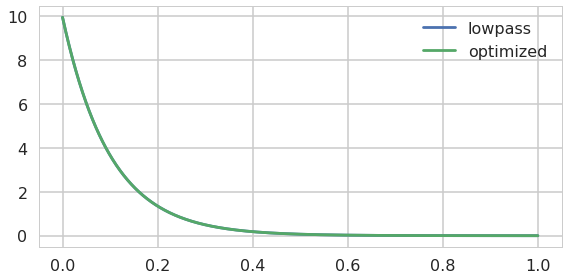

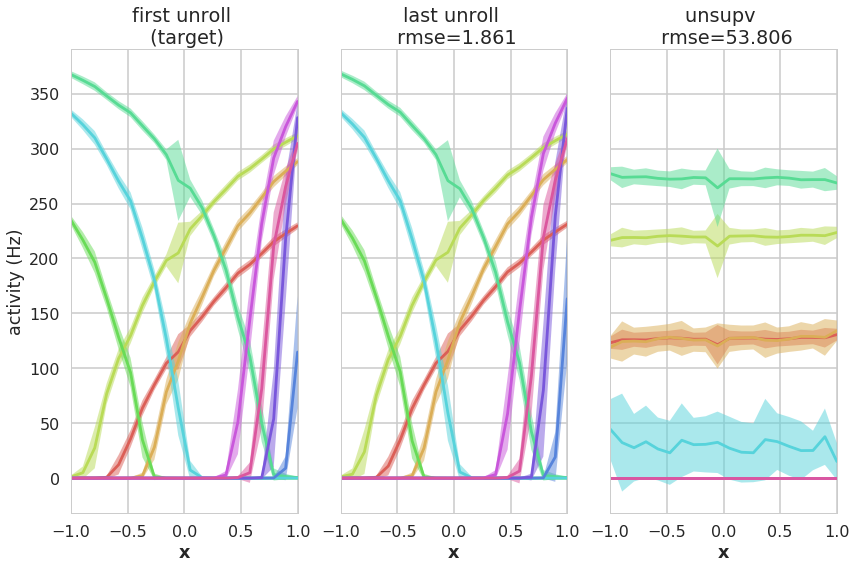

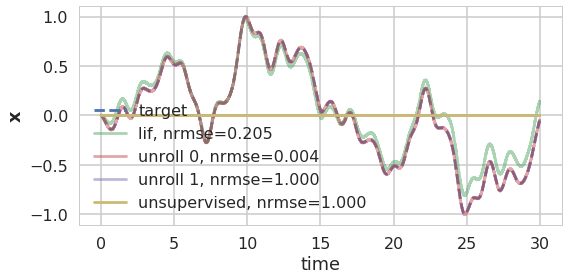

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

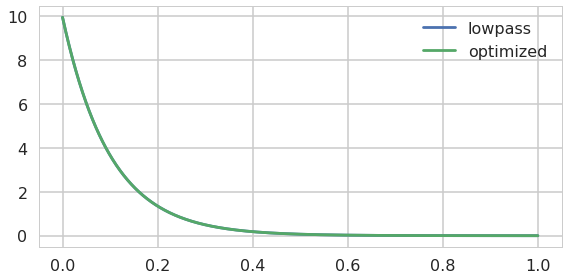

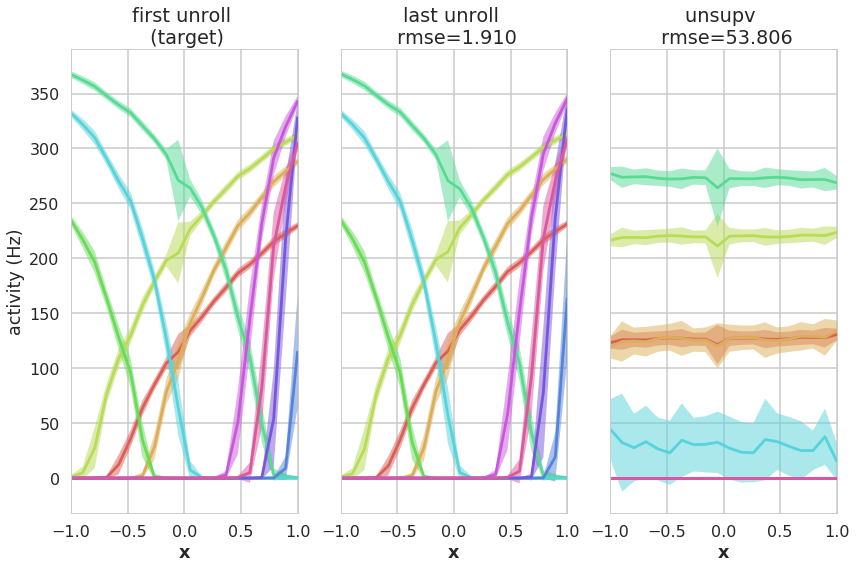

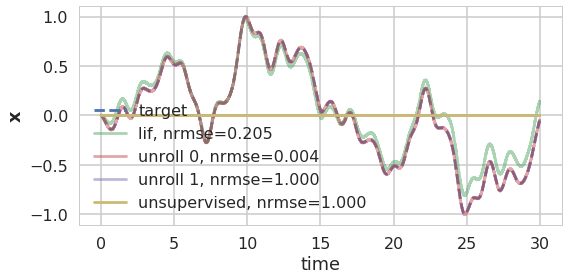

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

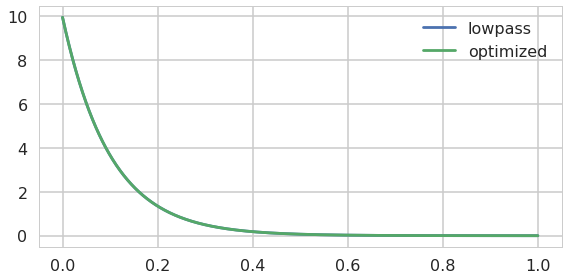

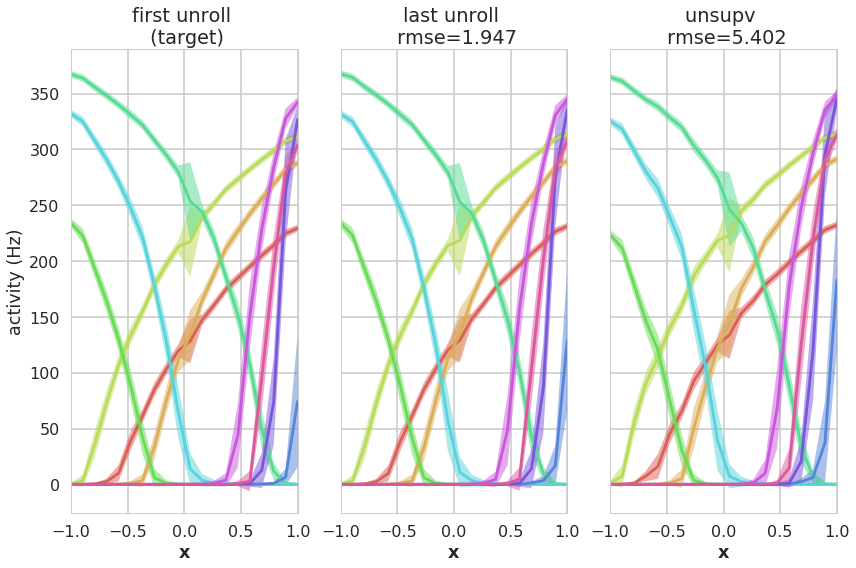

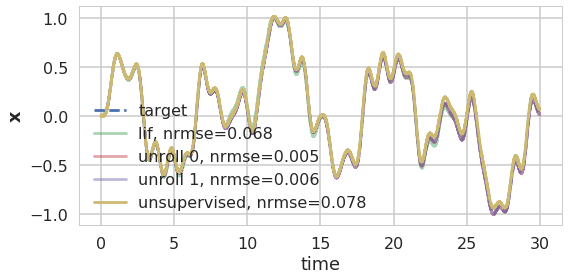

In [76]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-7,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'e_last', 'e_last', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

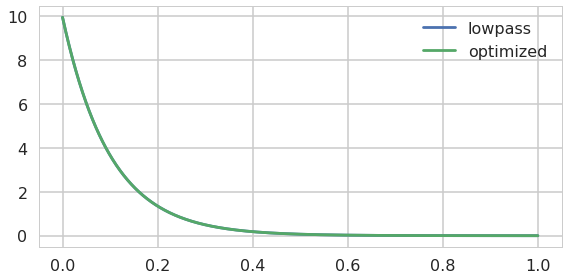

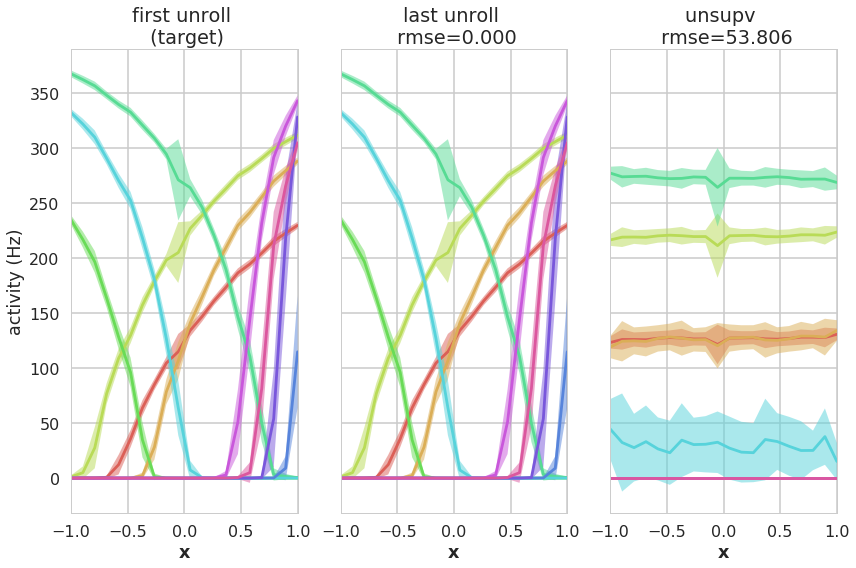

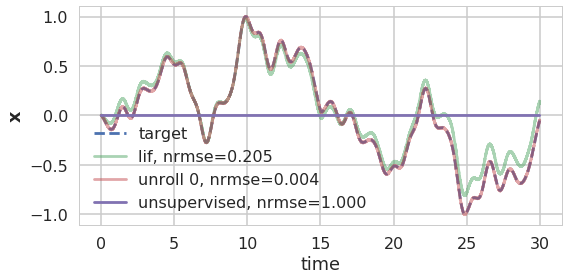

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

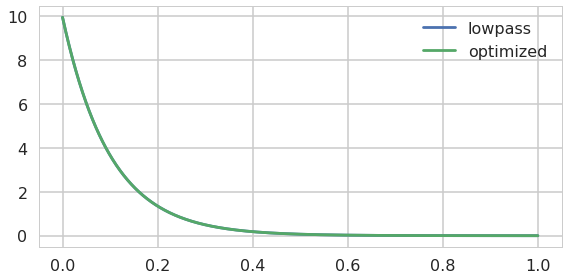

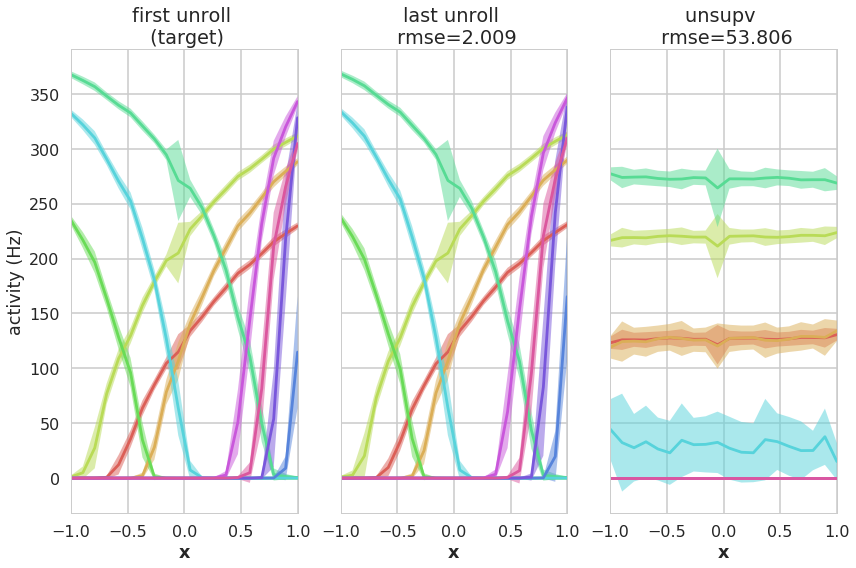

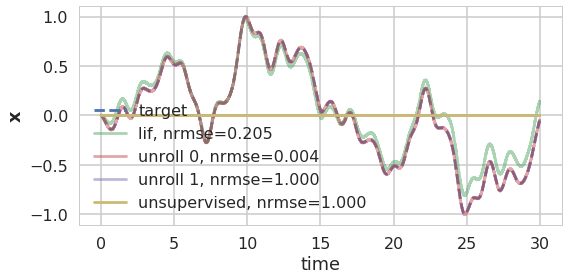

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

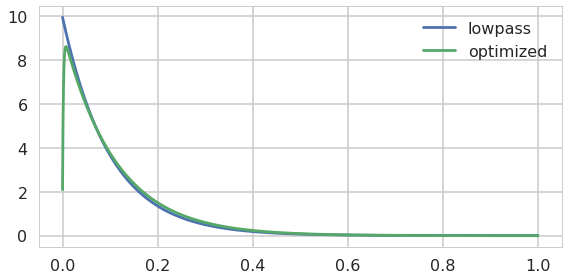

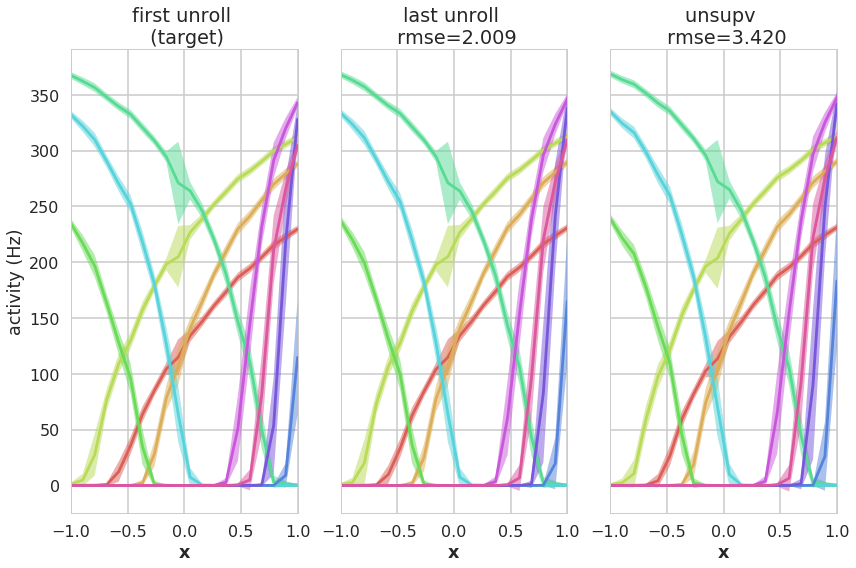

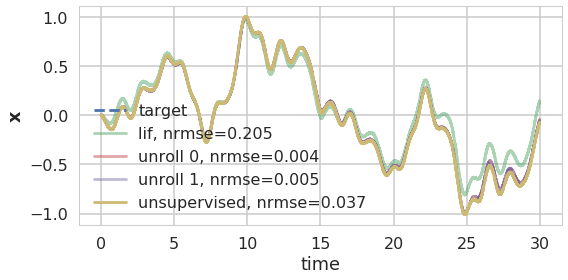

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

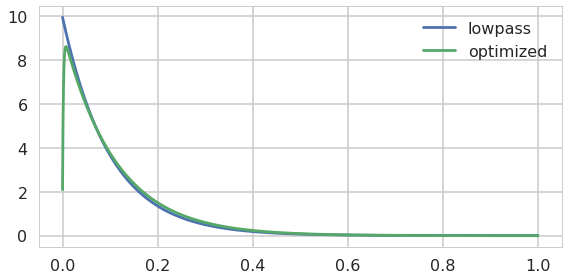

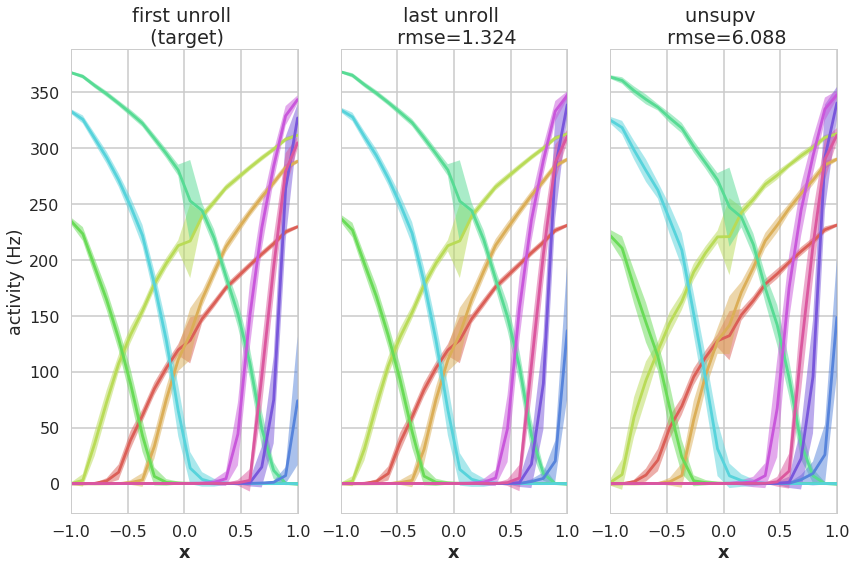

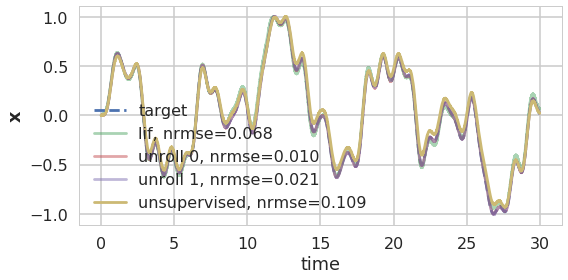

In [11]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-7,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'h']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### decoder, encoder, filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

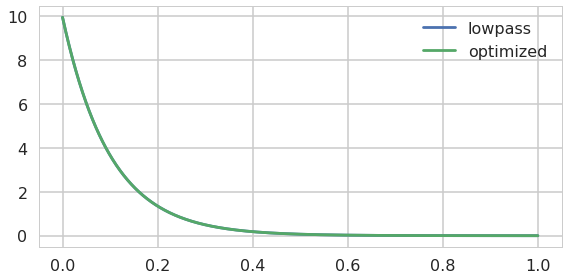

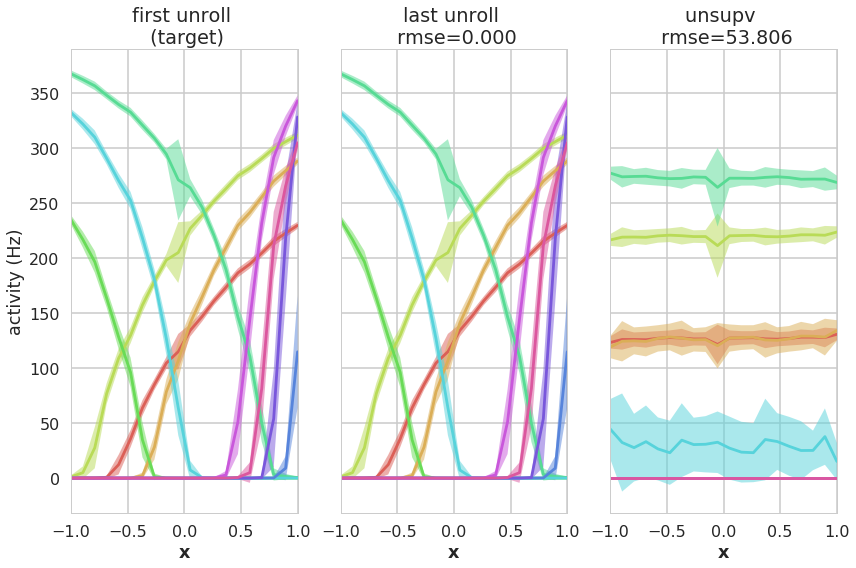

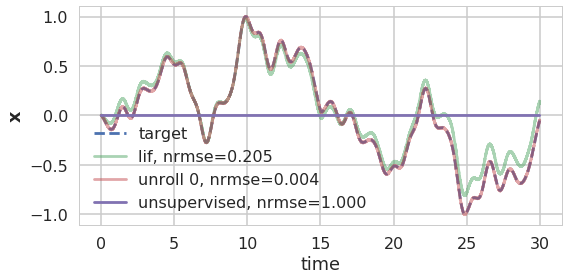

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

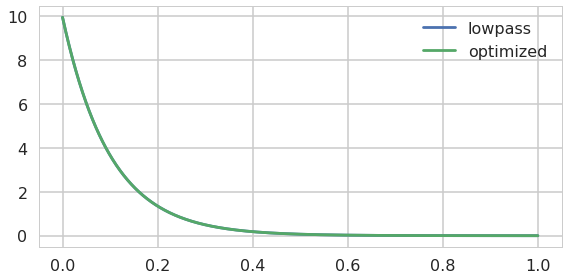

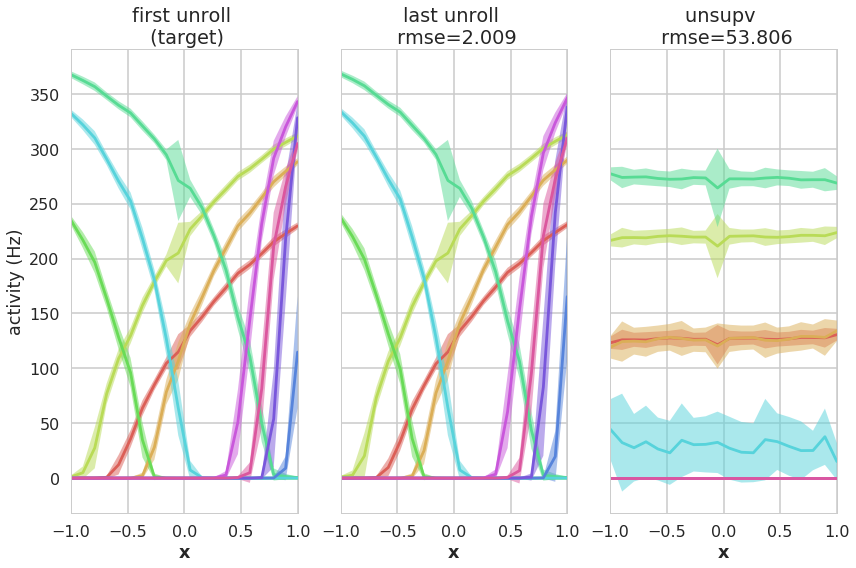

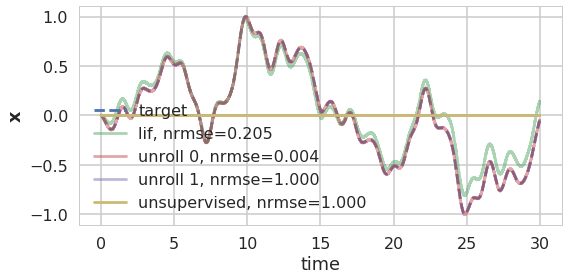

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

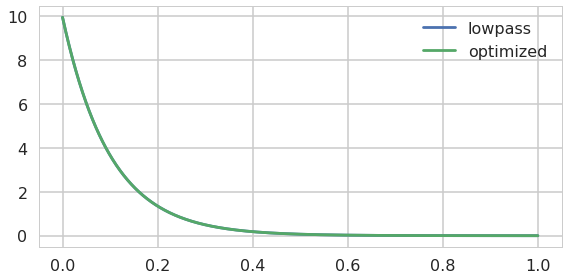

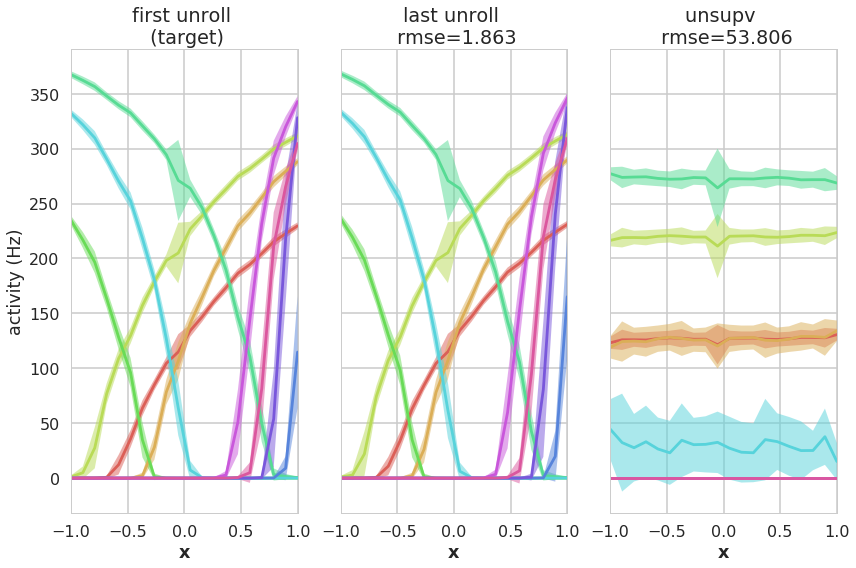

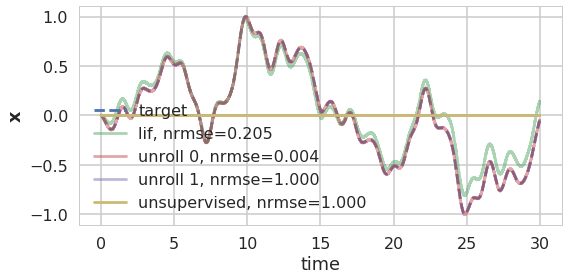

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

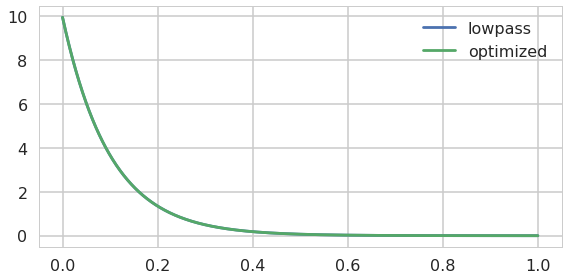

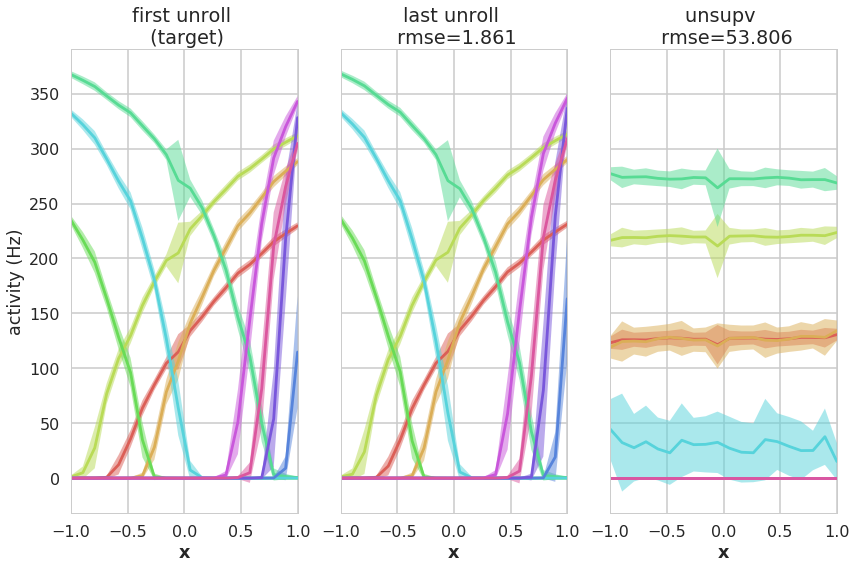

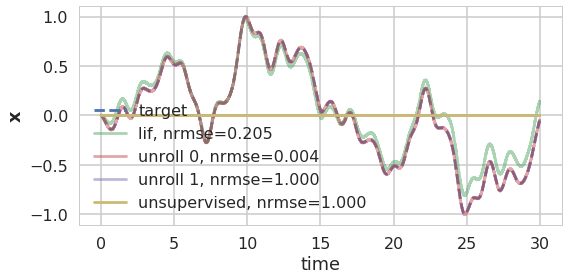

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

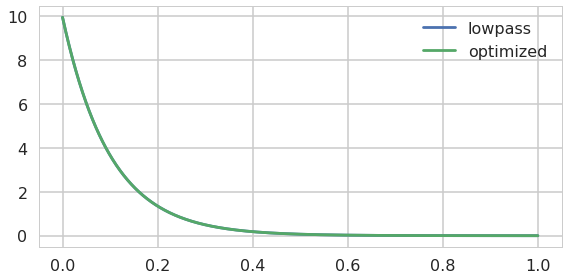

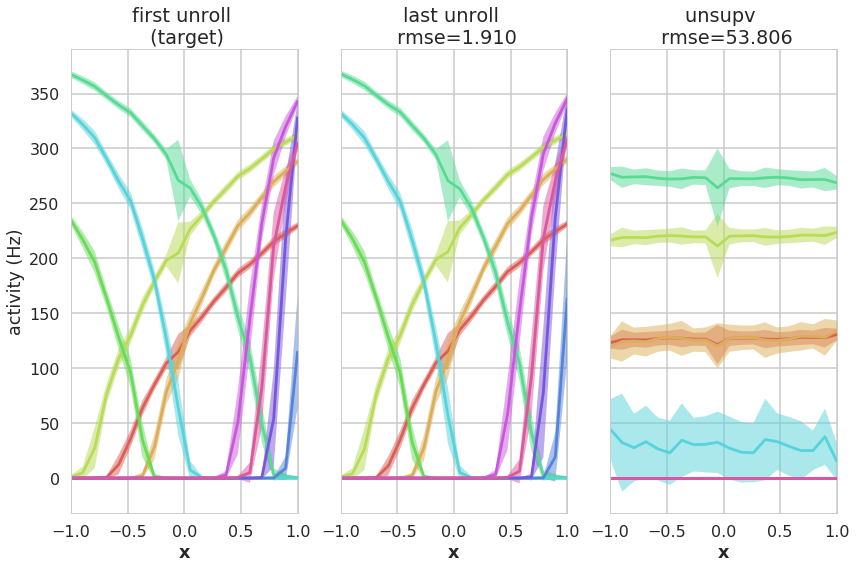

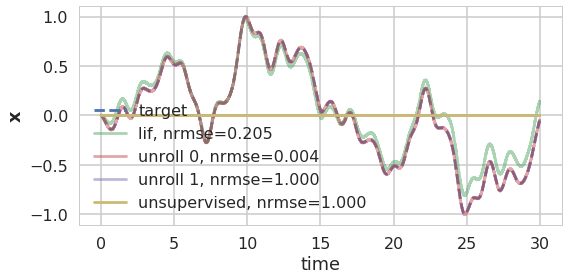

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

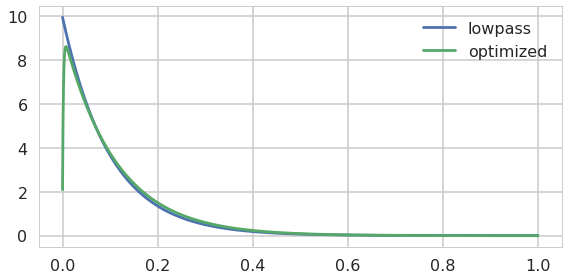

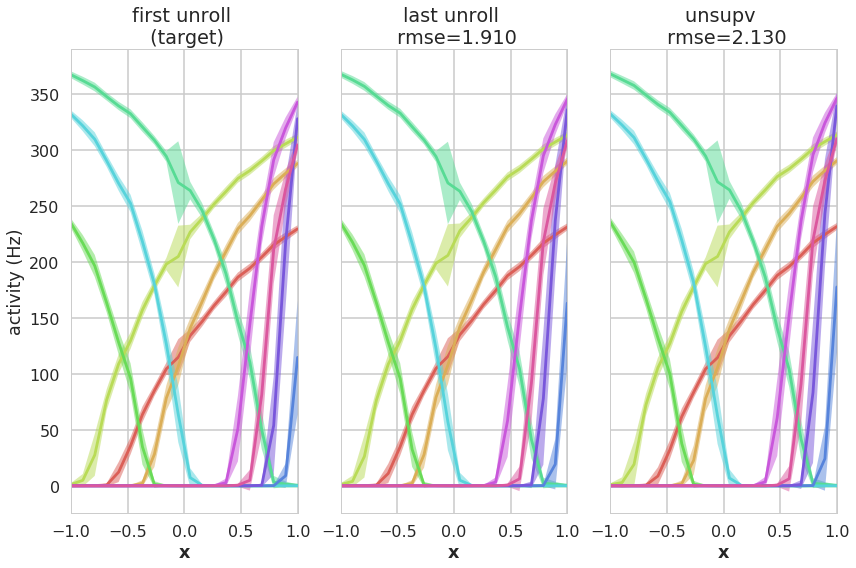

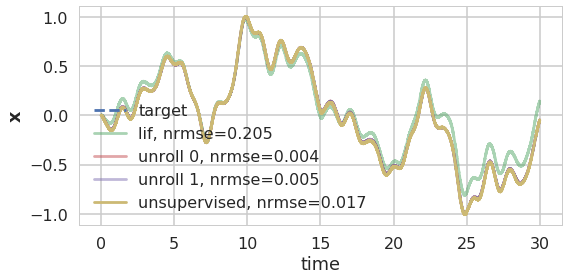

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

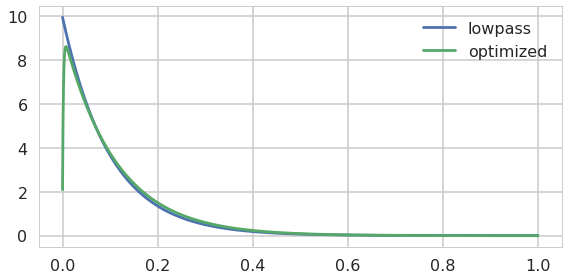

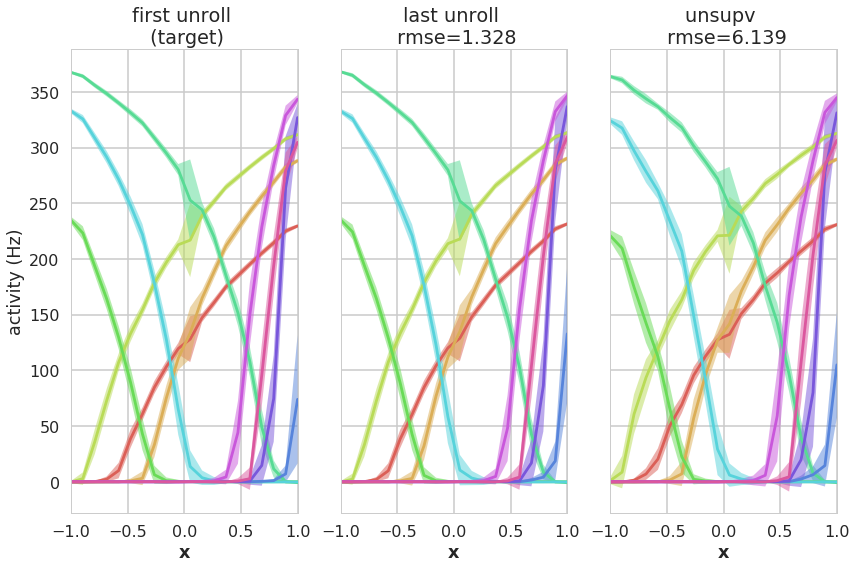

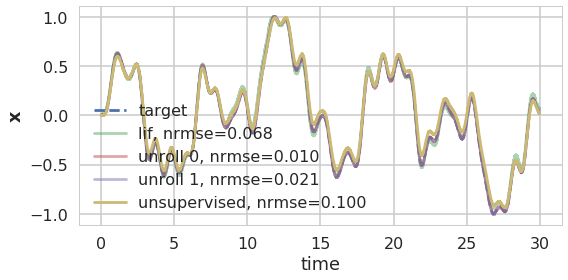

In [12]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-7,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'e_last', 'e_last', 'd_last', 'h']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### unroll with decoders and filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

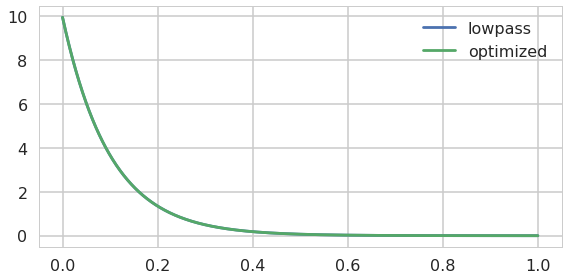

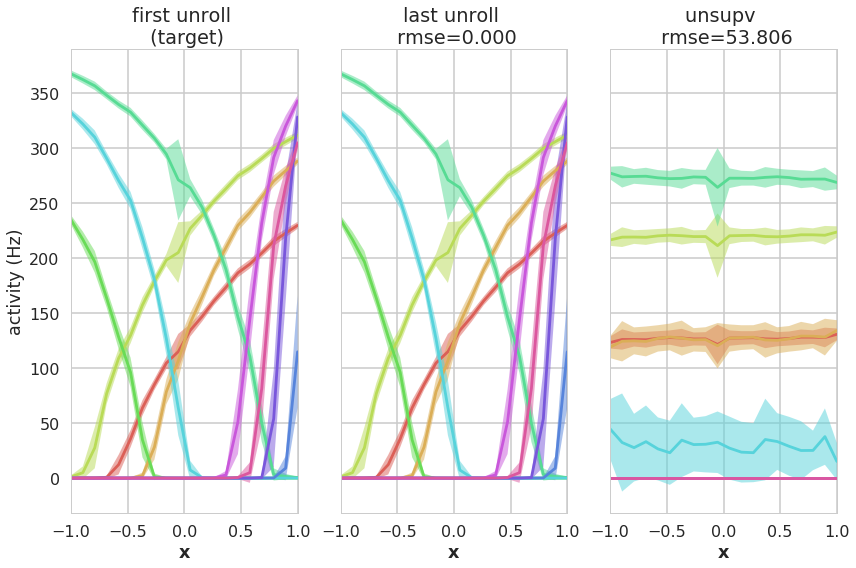

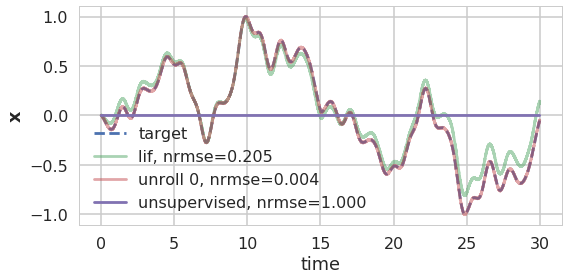

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

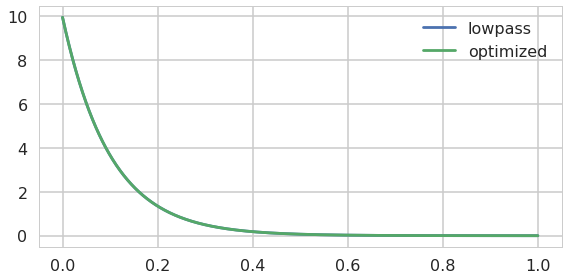

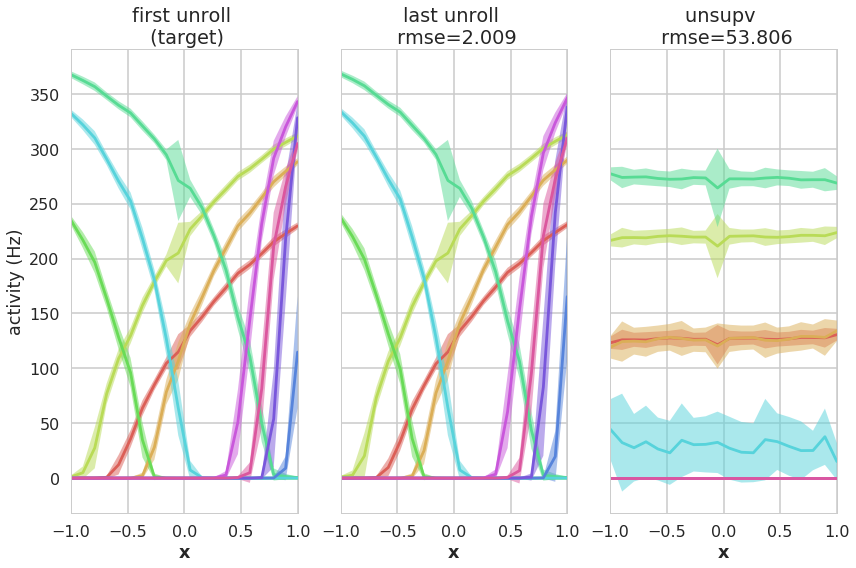

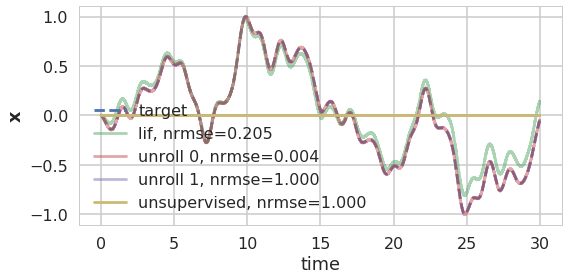

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

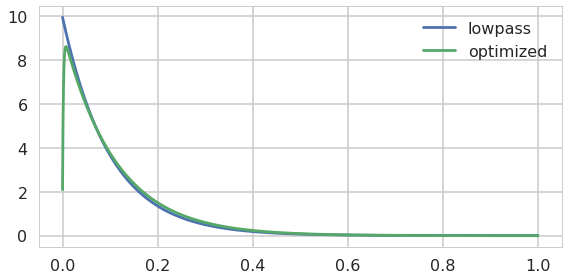

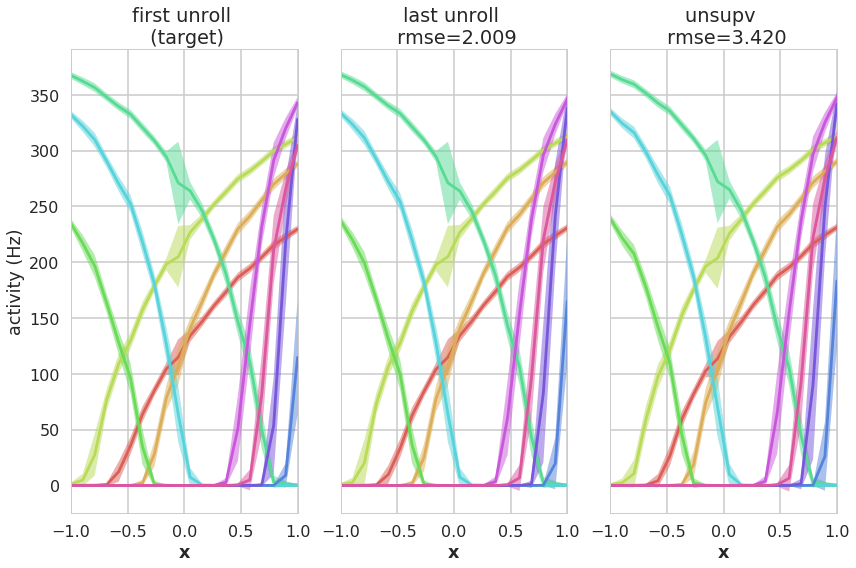

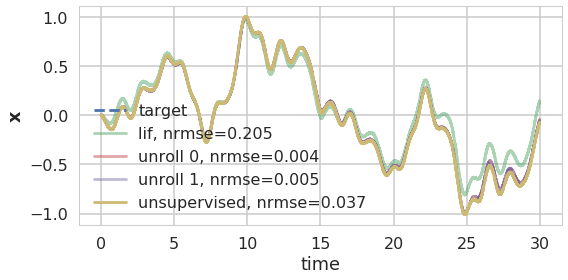

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

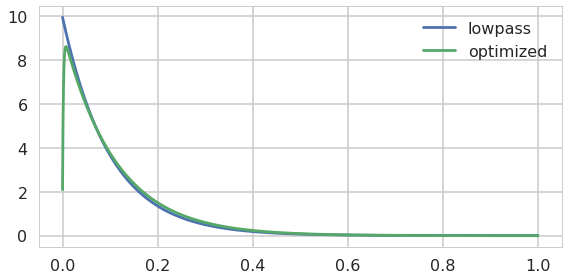

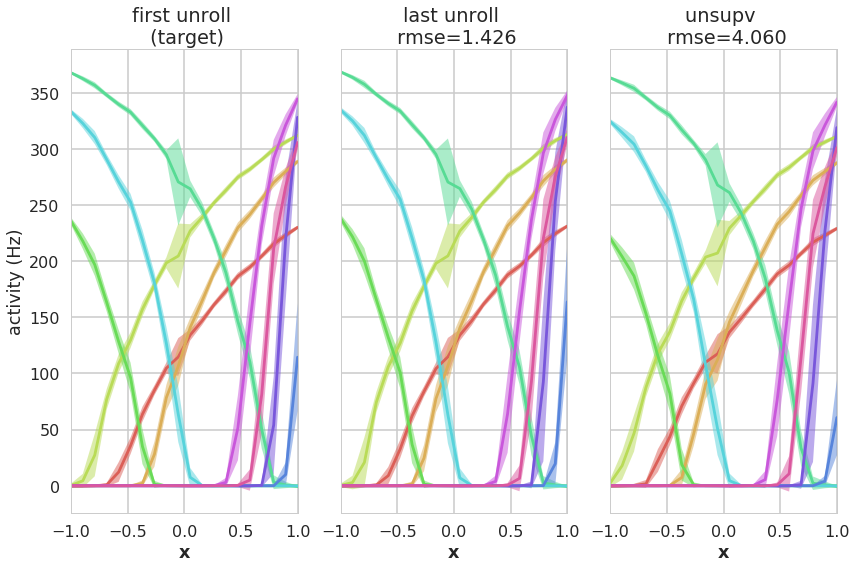

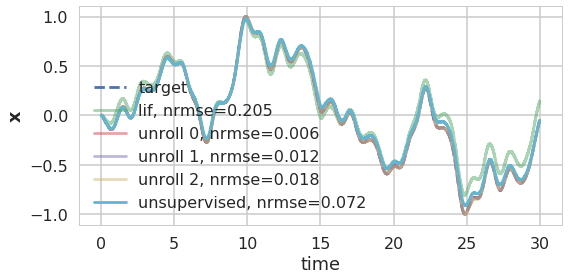

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

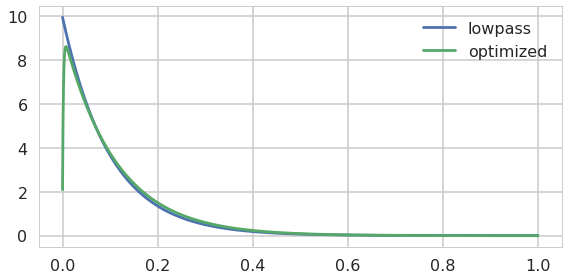

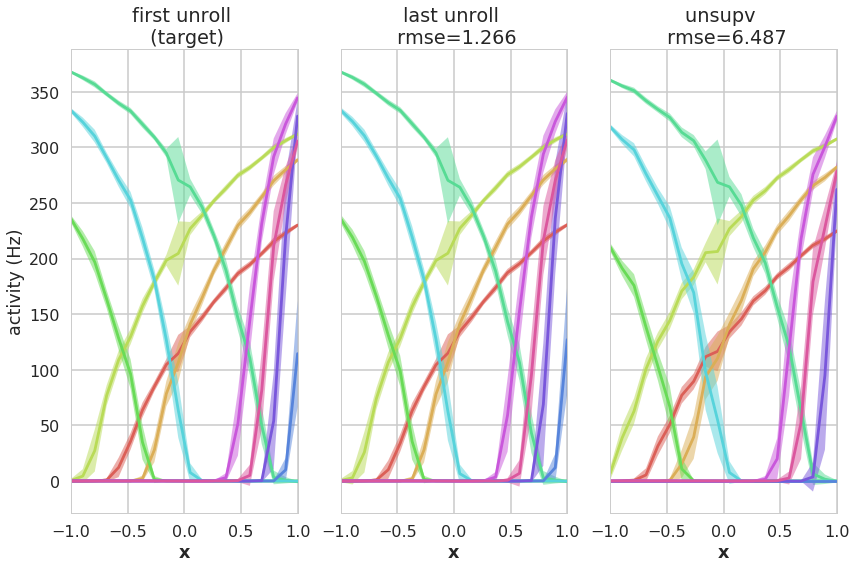

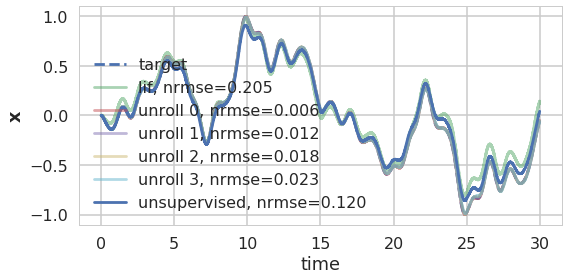

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

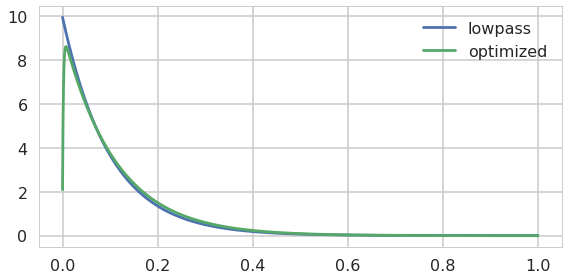

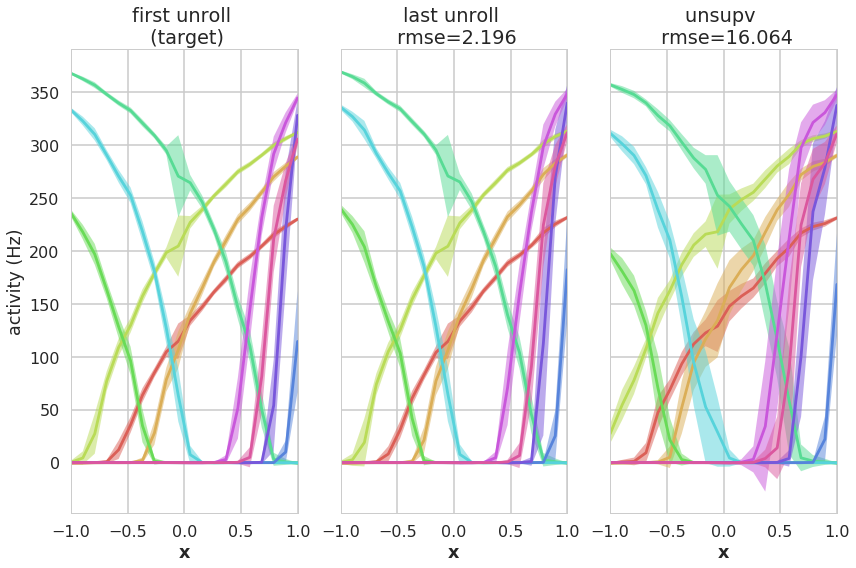

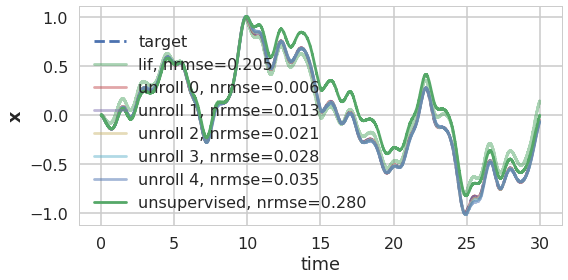

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

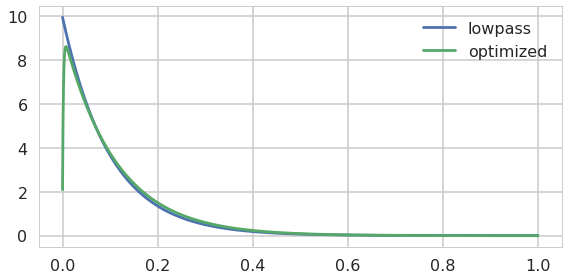

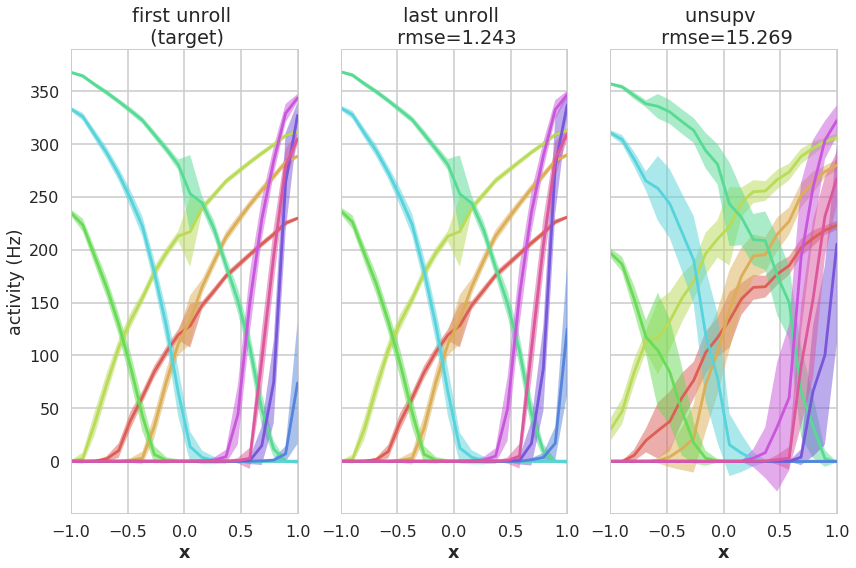

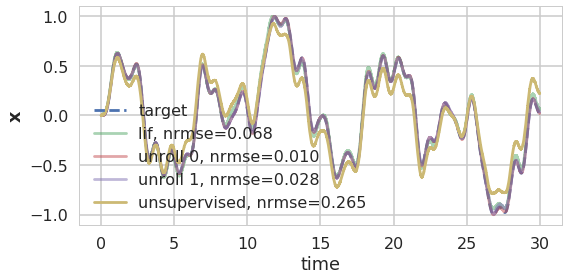

In [21]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-7,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'h', 'r', 'd_last', 'r', 'd_last', 'r', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### unrolling with encoders, decoders, and filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

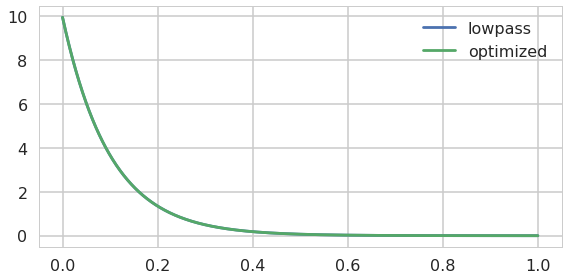

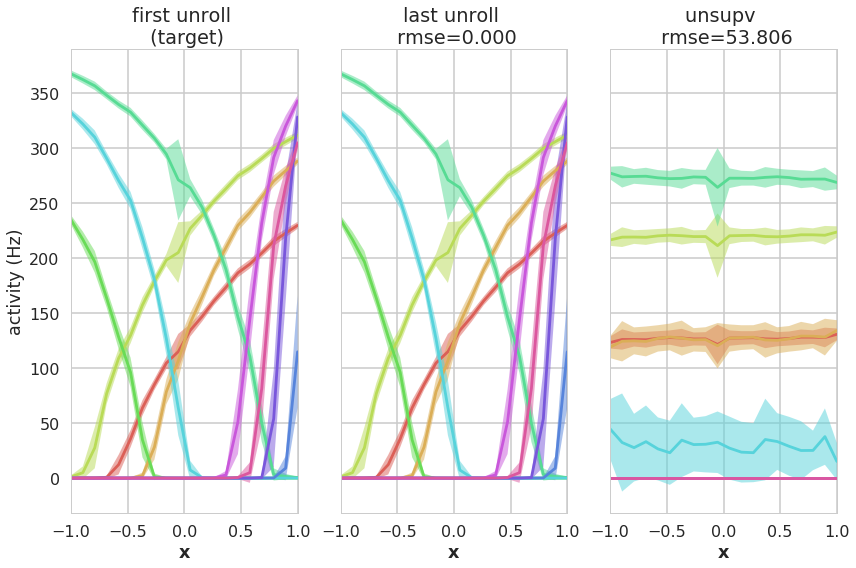

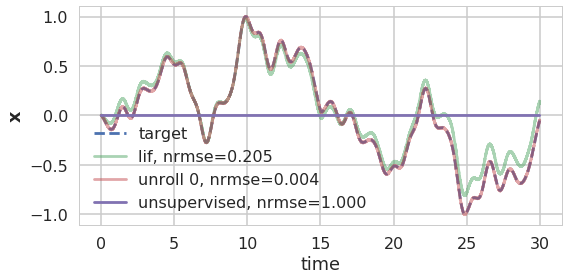

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

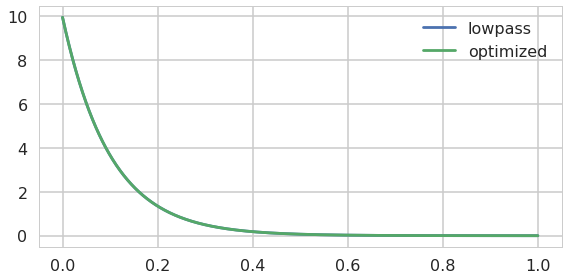

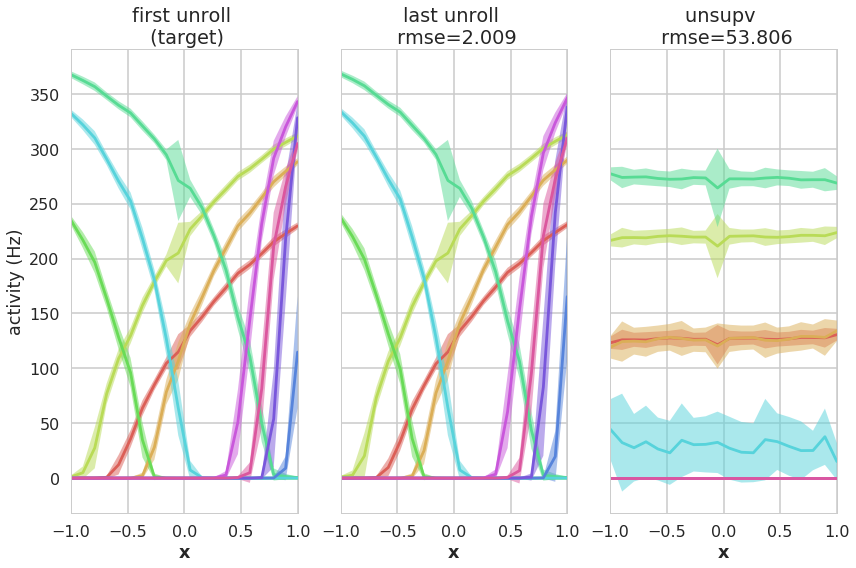

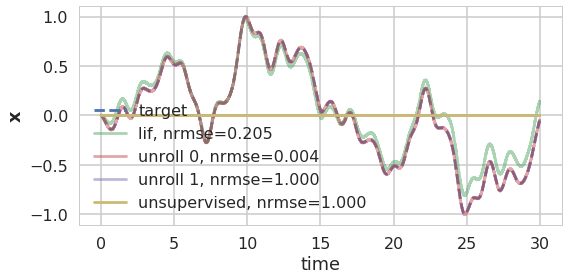

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

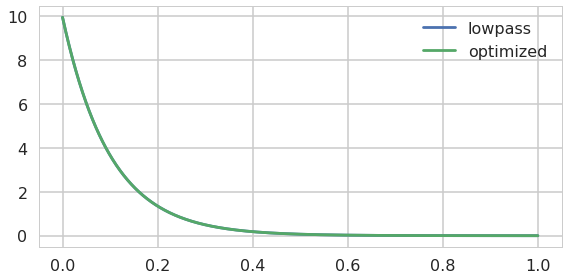

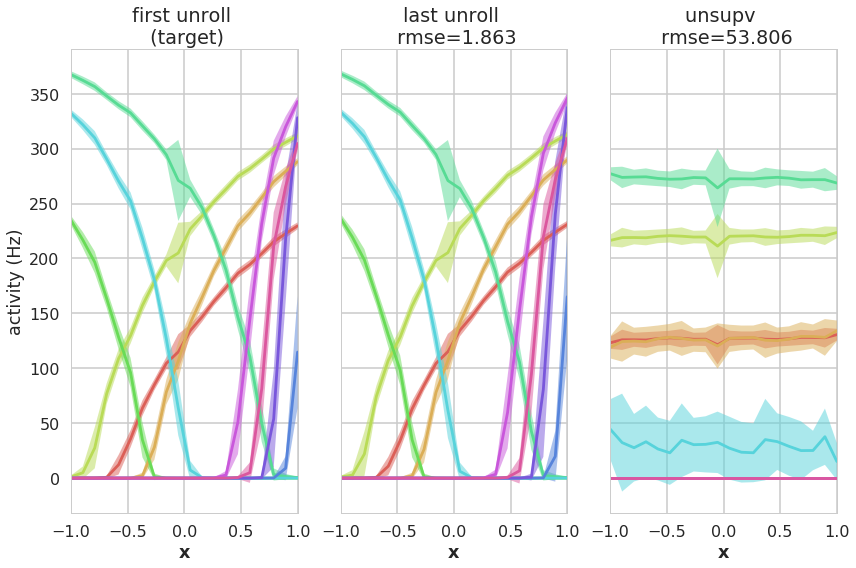

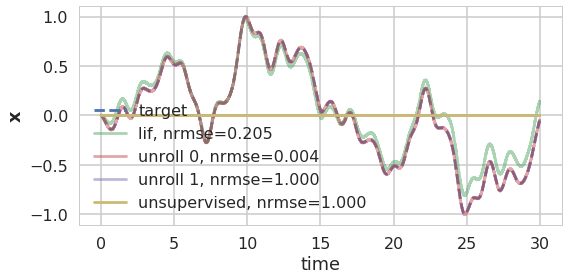

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

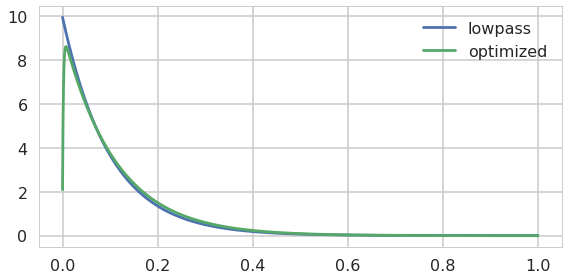

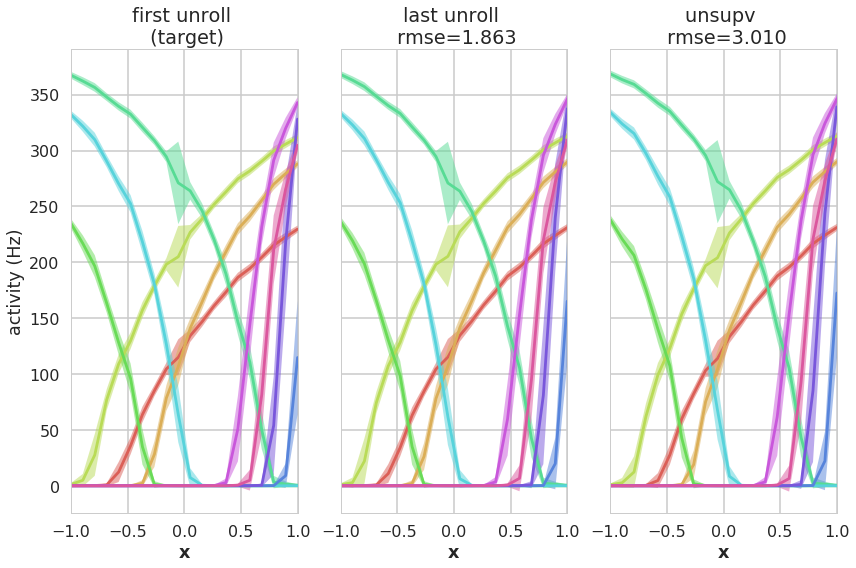

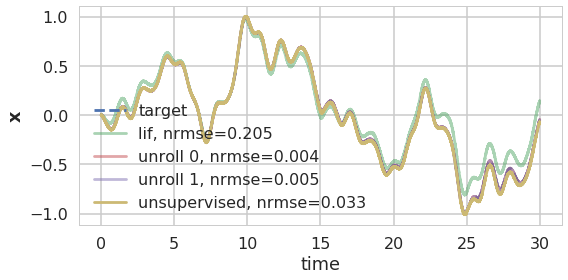

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

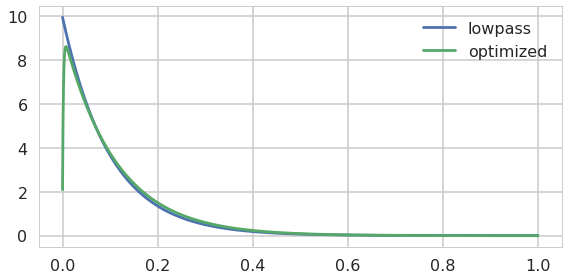

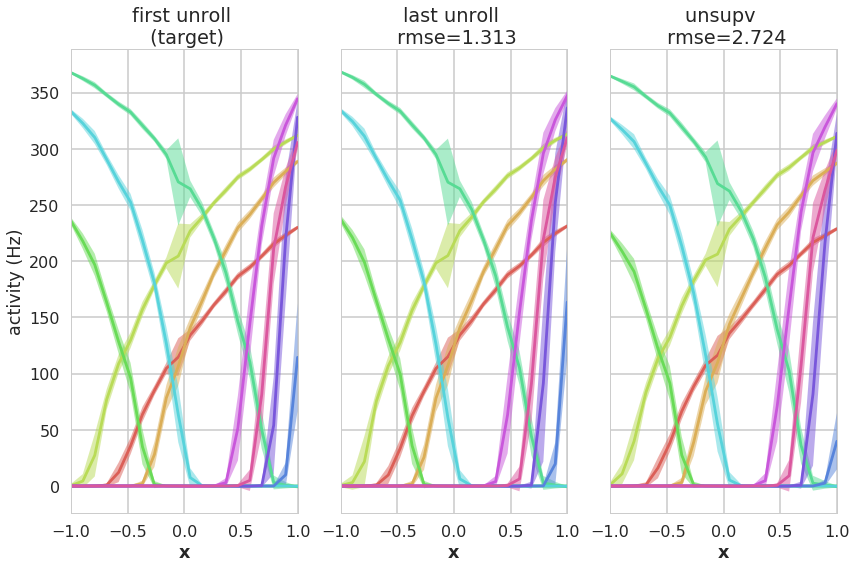

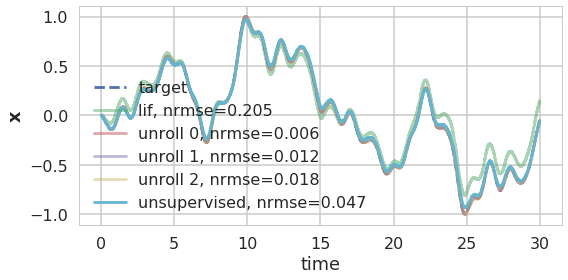

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

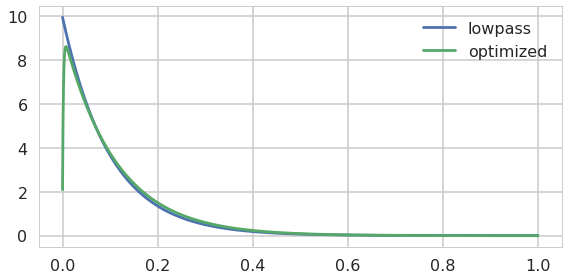

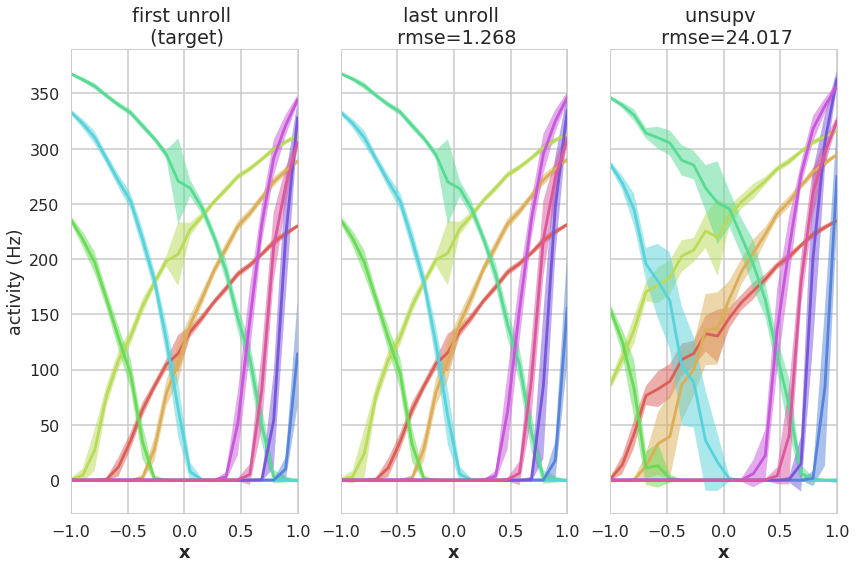

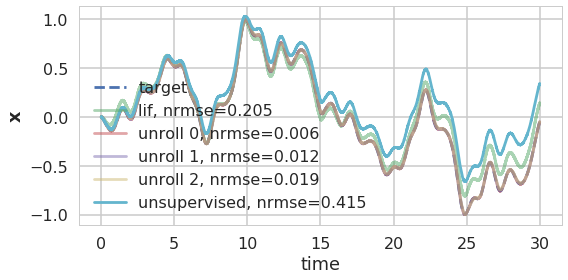

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

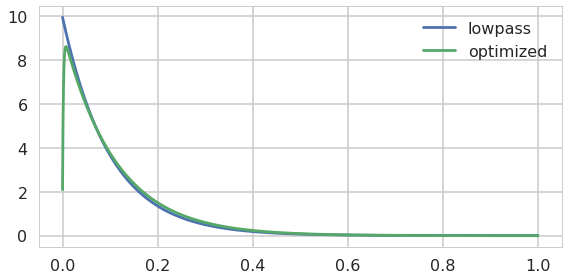

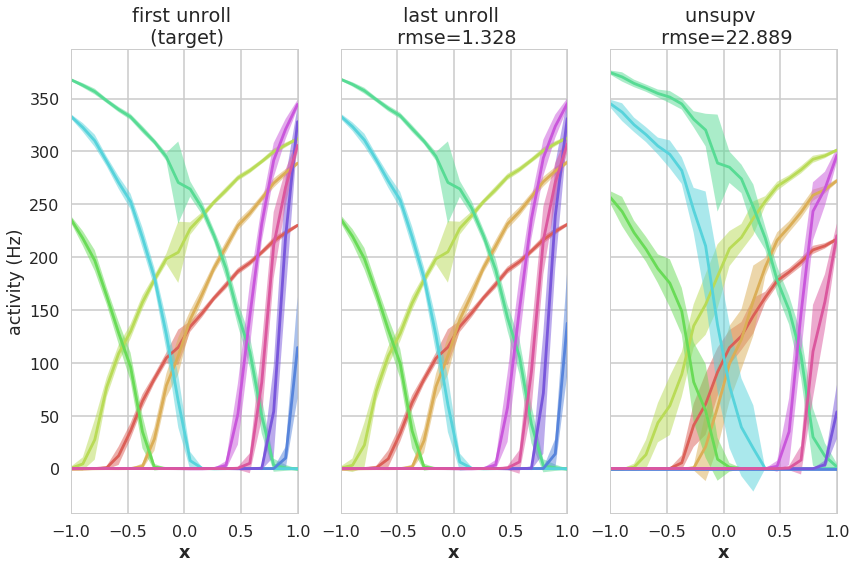

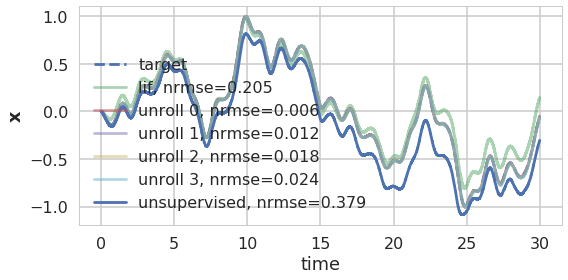

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

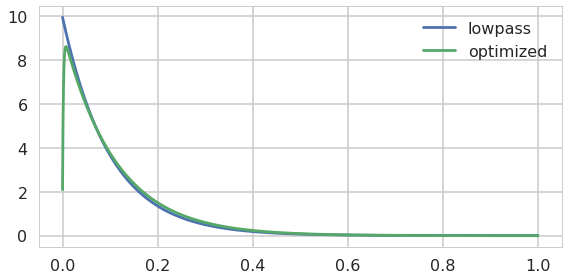

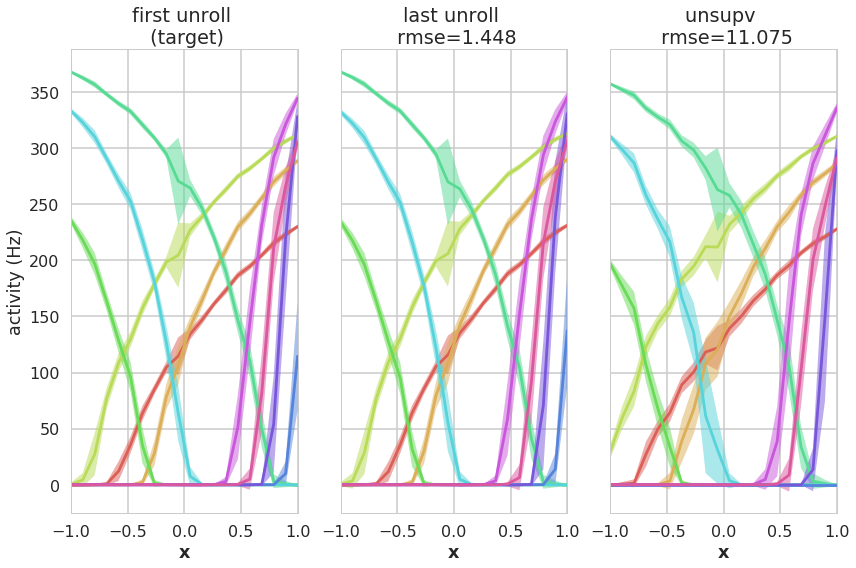

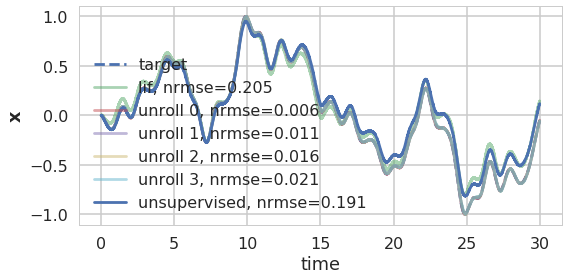

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

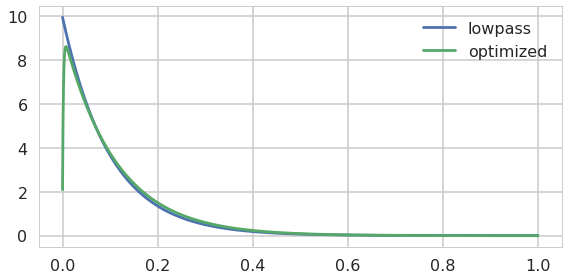

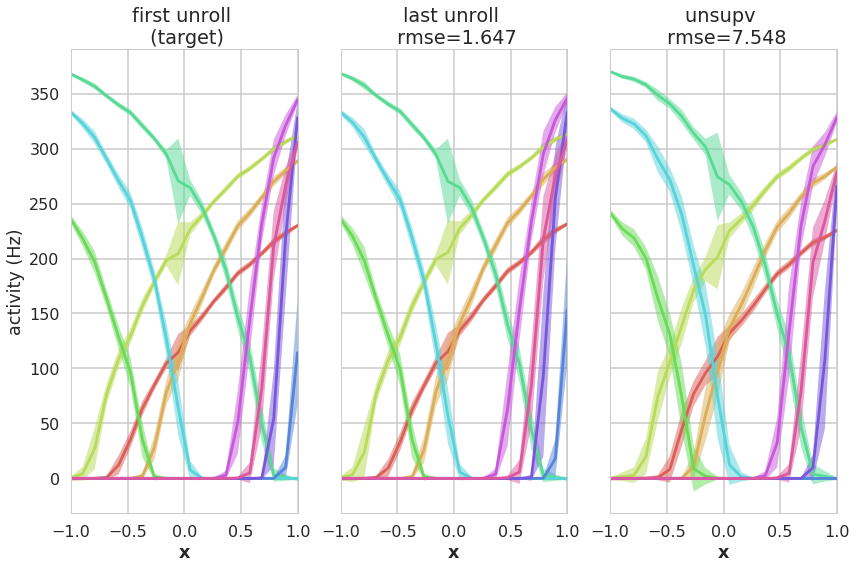

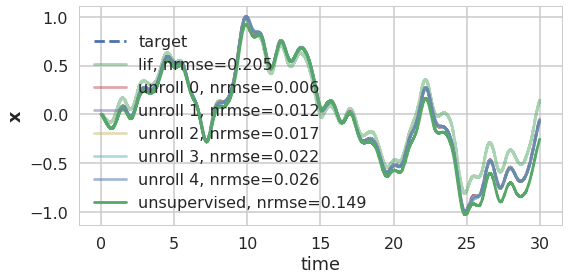

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

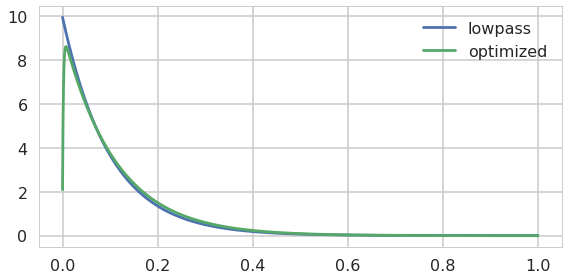

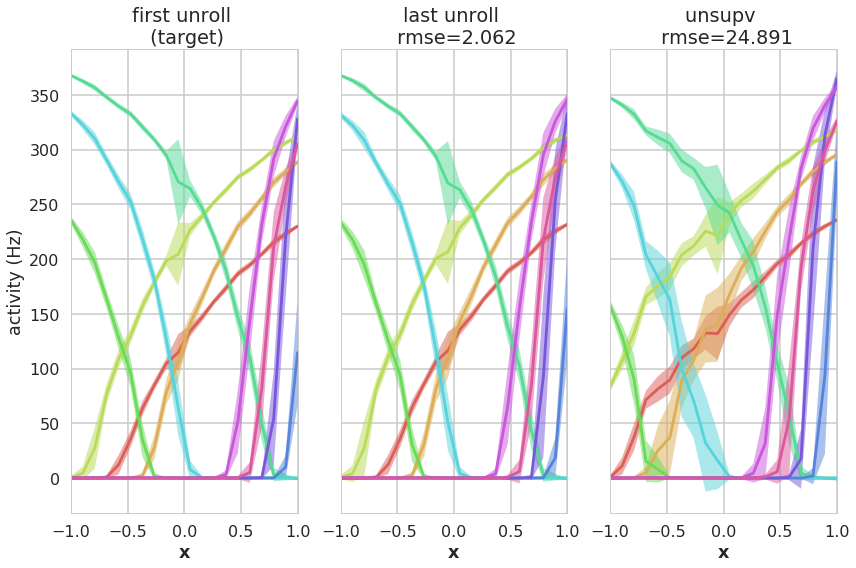

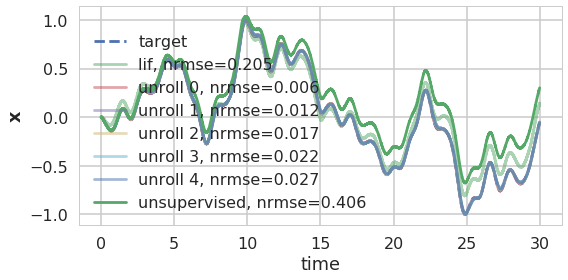

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

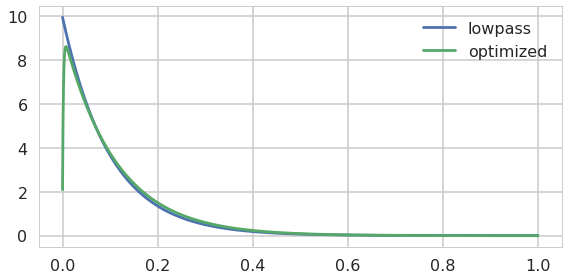

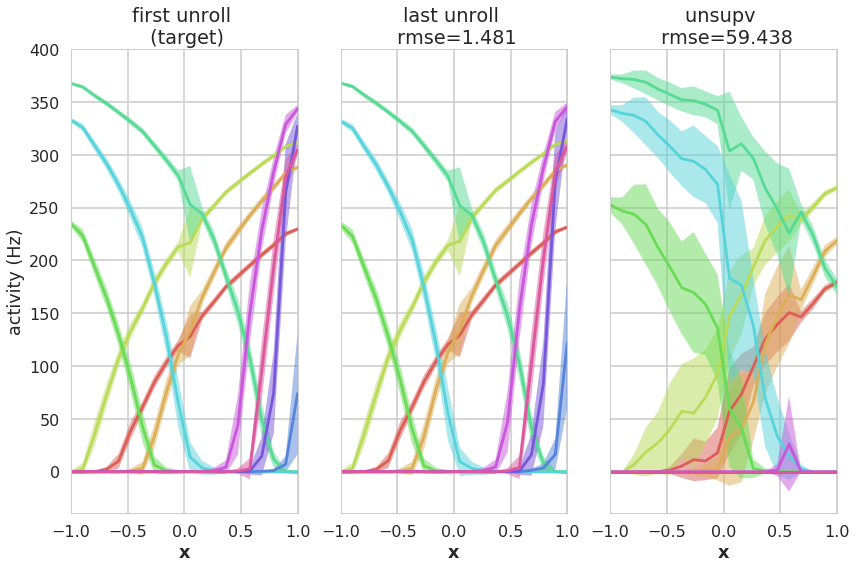

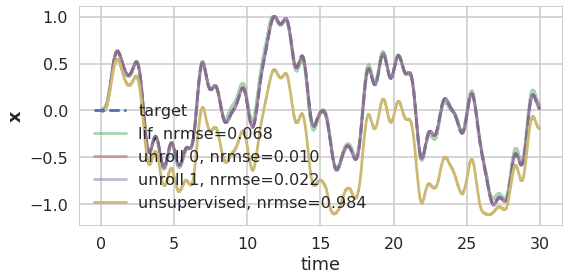

In [13]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Default,
    neuron_type=nengo.LIF(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-7,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'd_last', 'h', 'r', 'e_last', 'd_last', 'r', 'e_last', 'd_last', 'r', 'e_last', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

## ALIF

### decoder

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

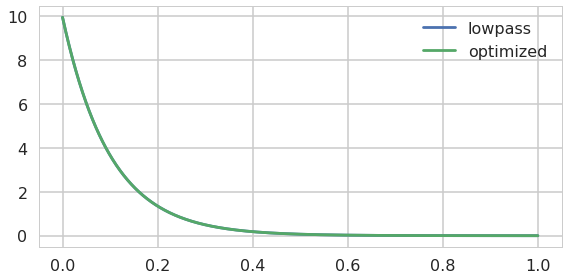

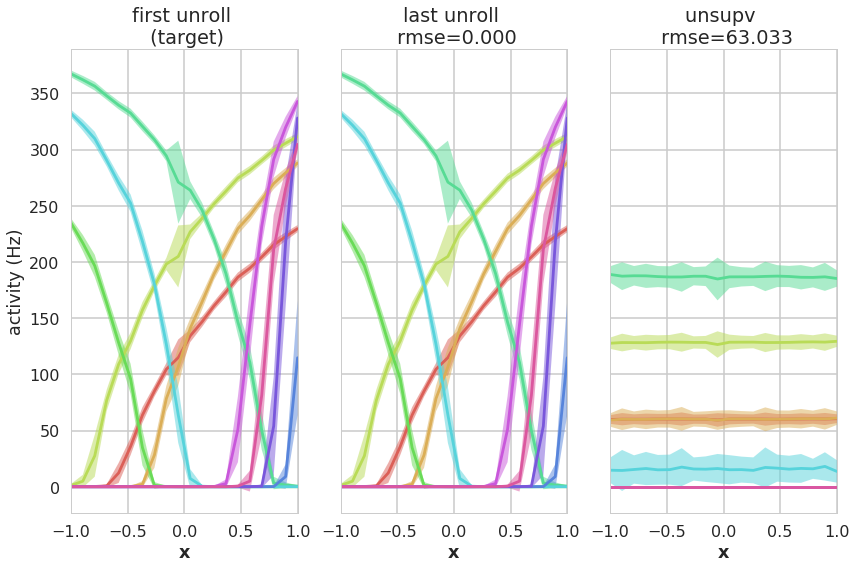

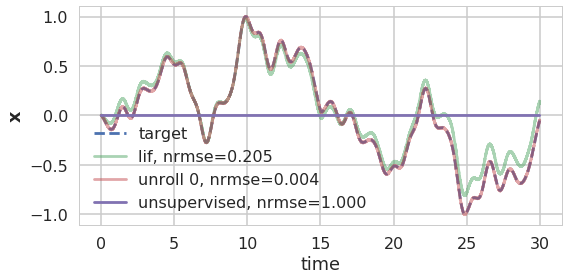

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

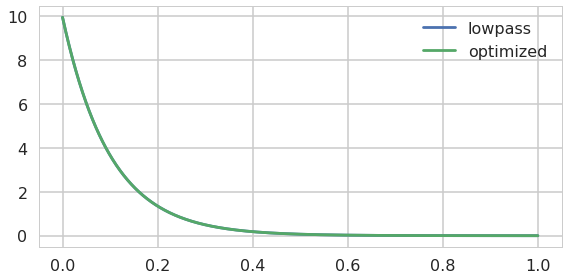

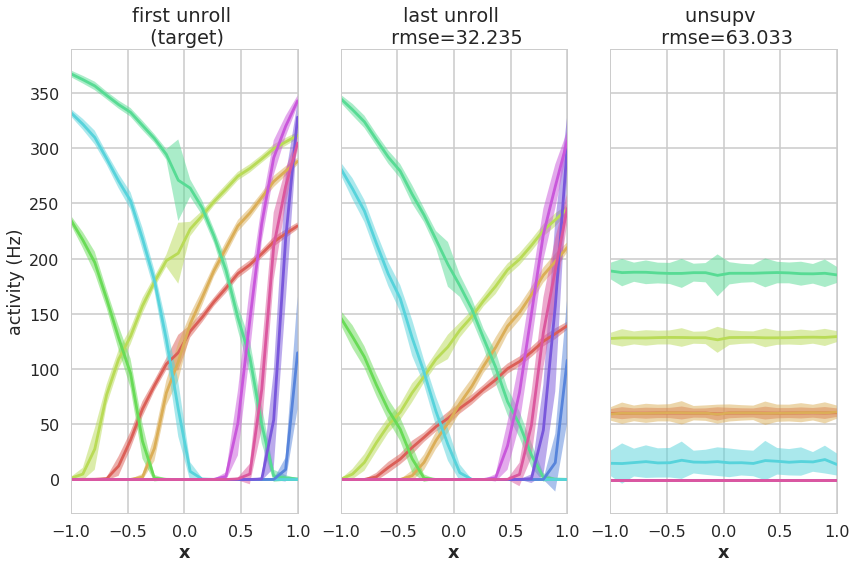

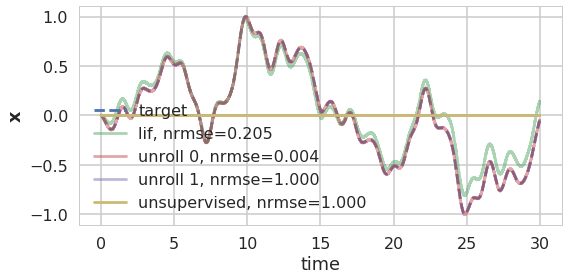

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

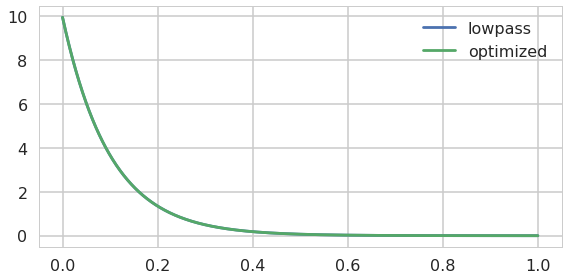

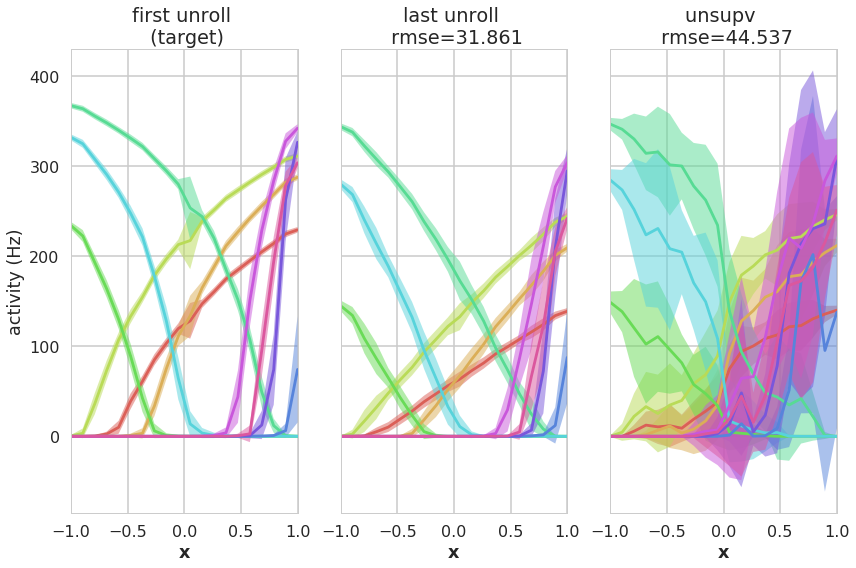

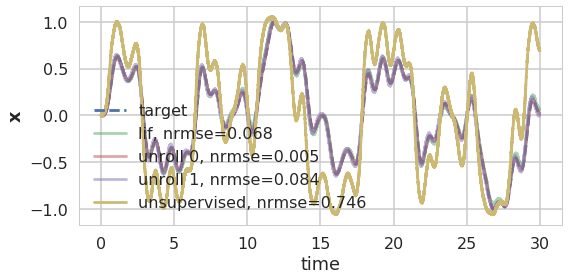

In [15]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### encoder

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

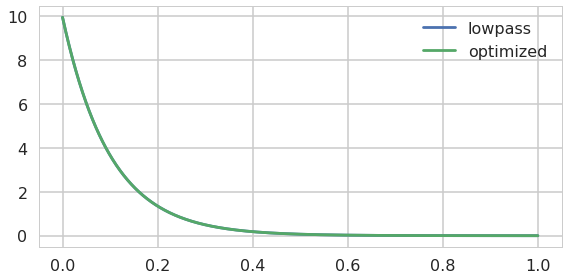

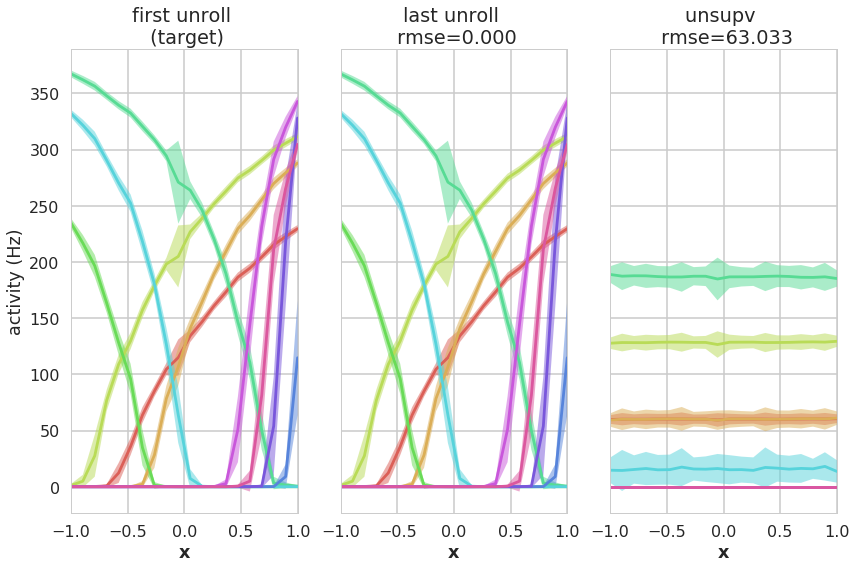

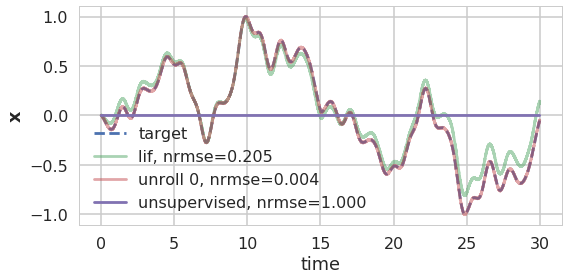

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

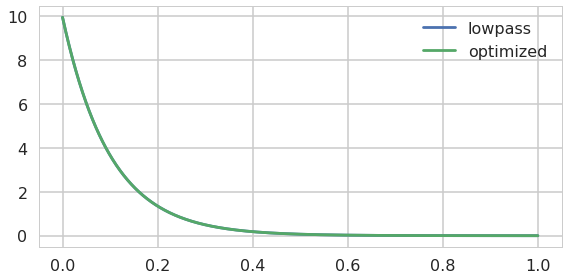

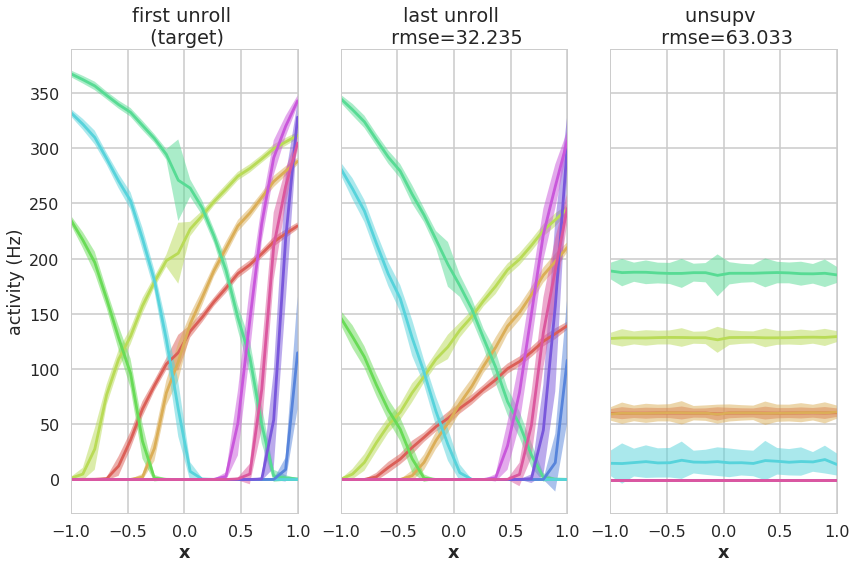

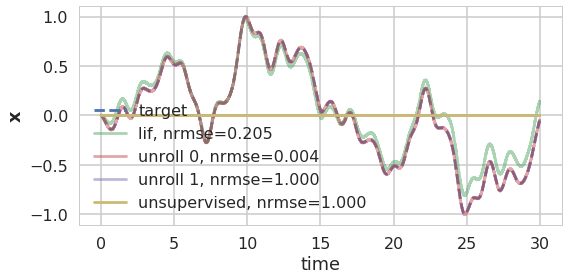

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

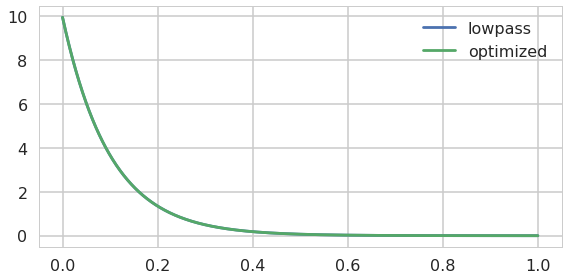

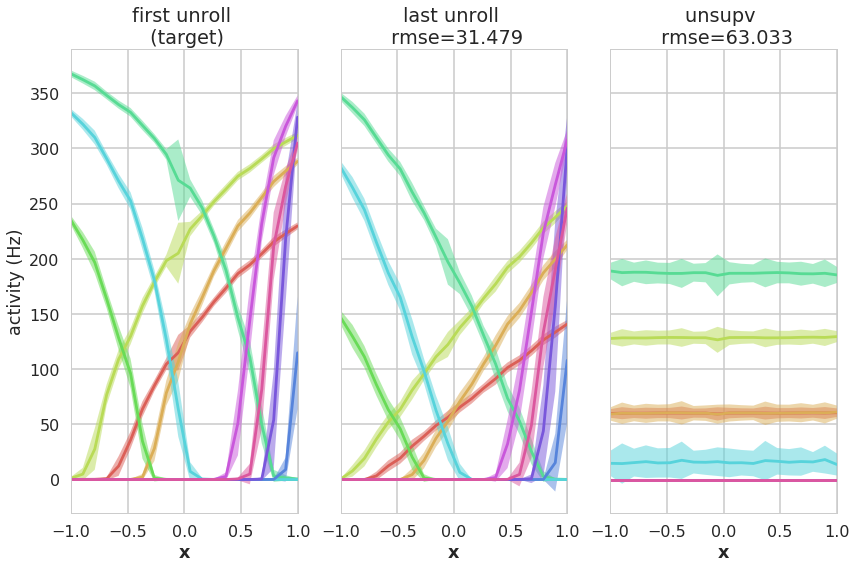

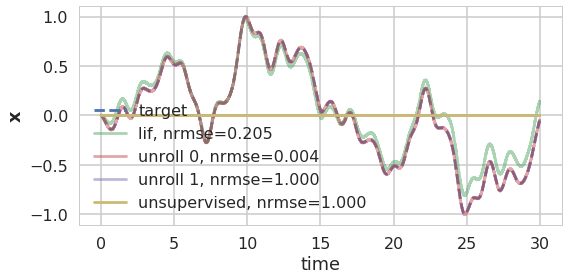

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

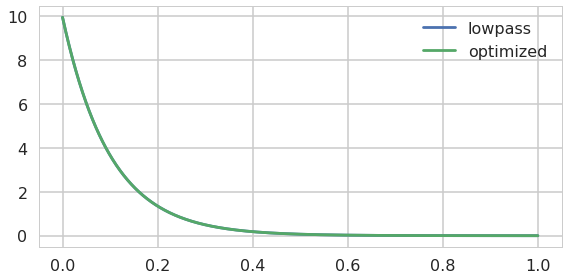

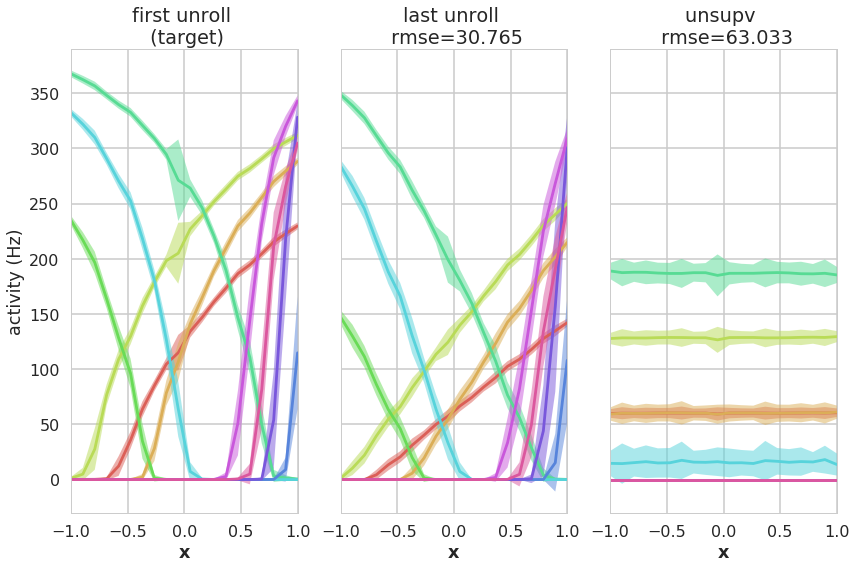

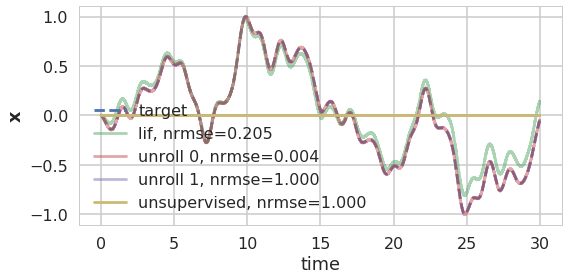

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

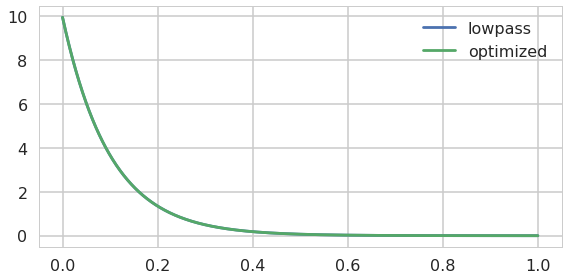

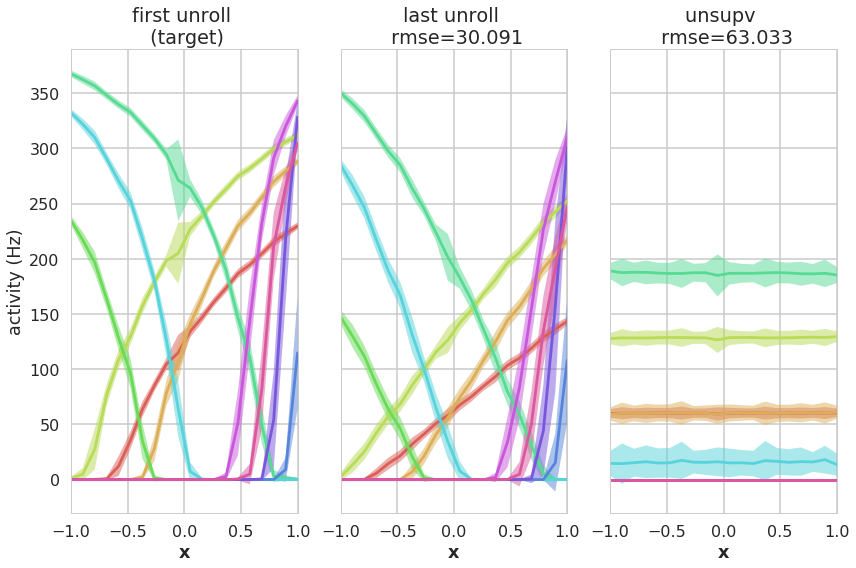

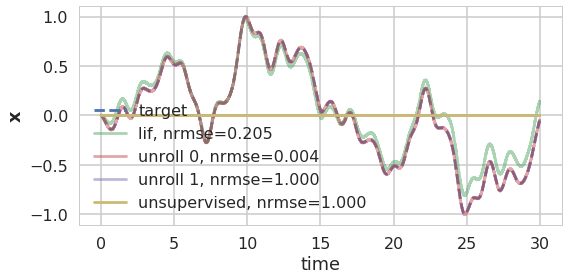

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

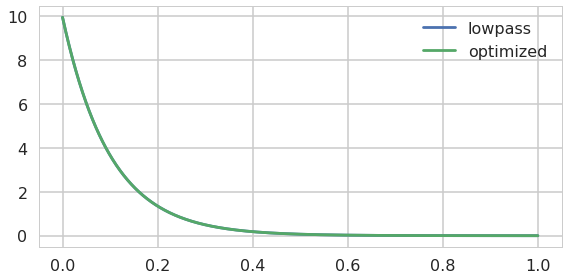

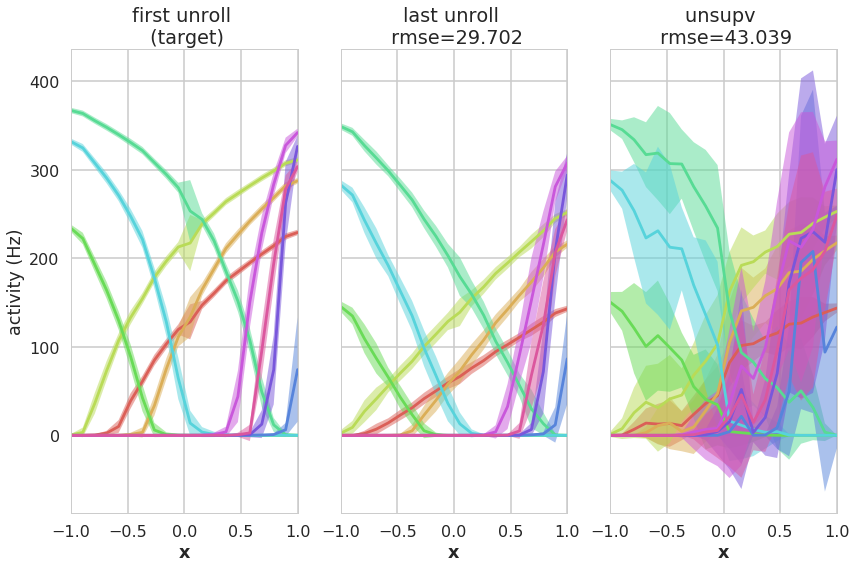

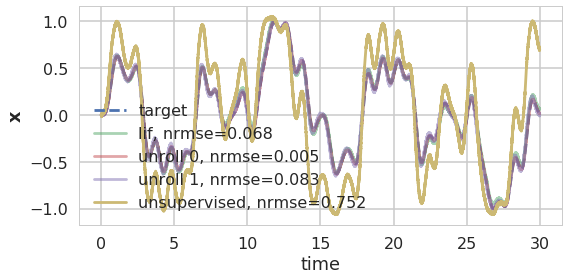

In [16]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-7,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'e_last', 'e_last', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

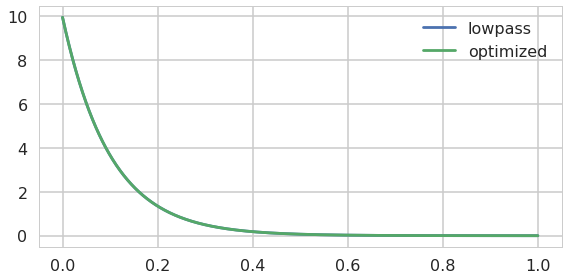

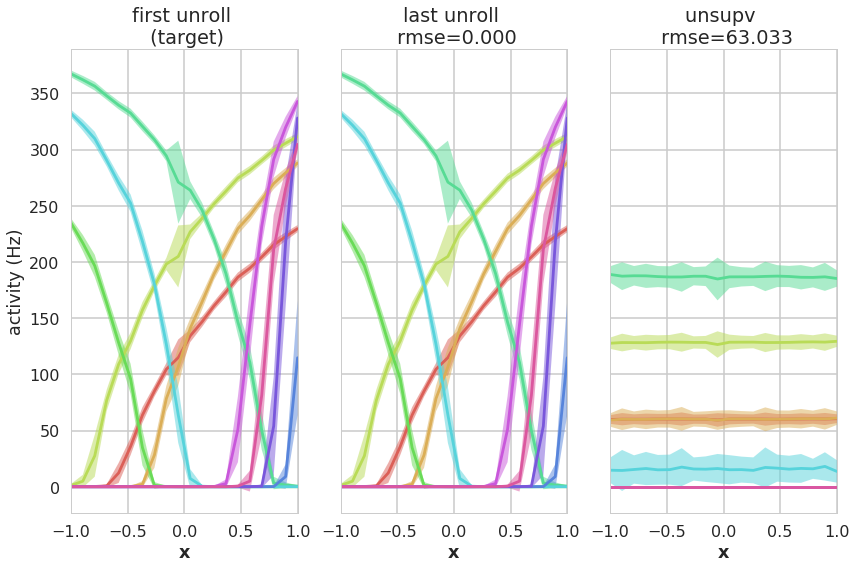

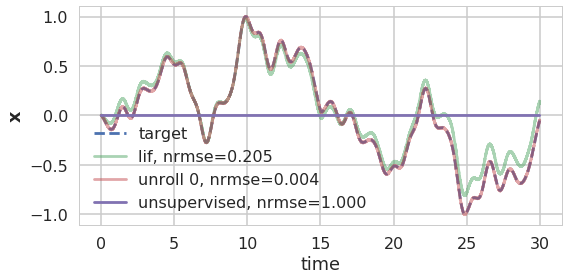

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

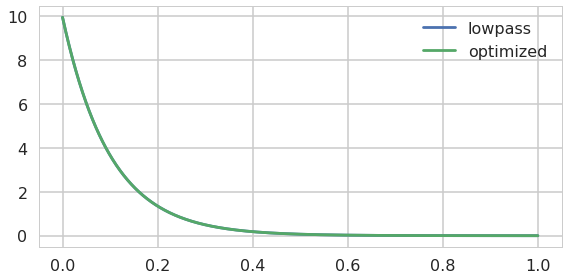

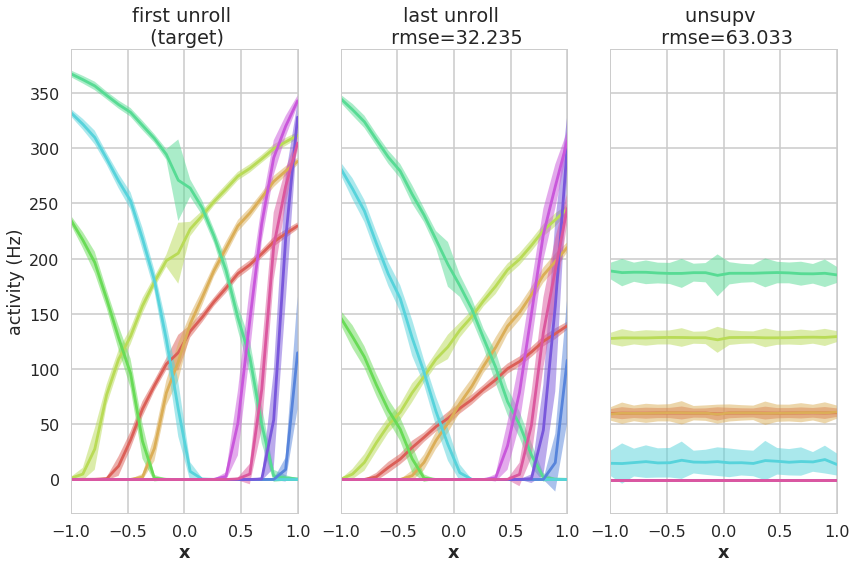

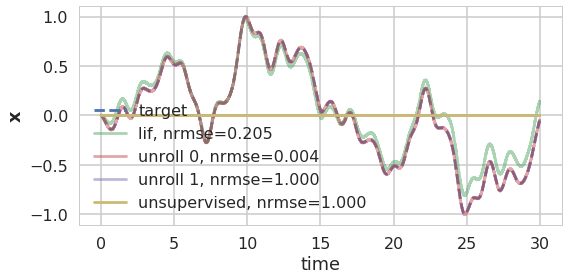

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

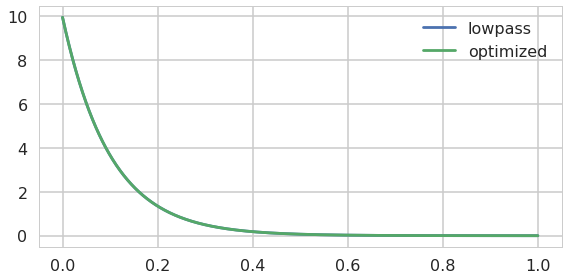

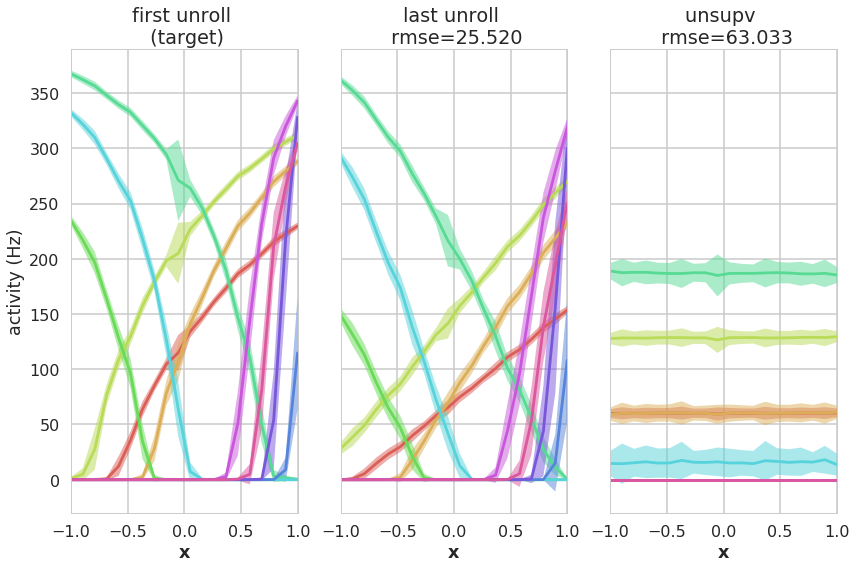

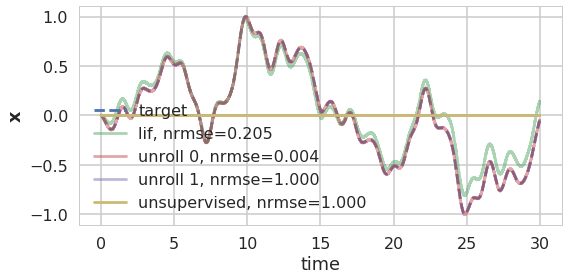

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

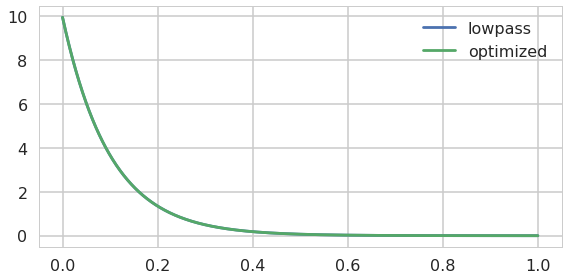

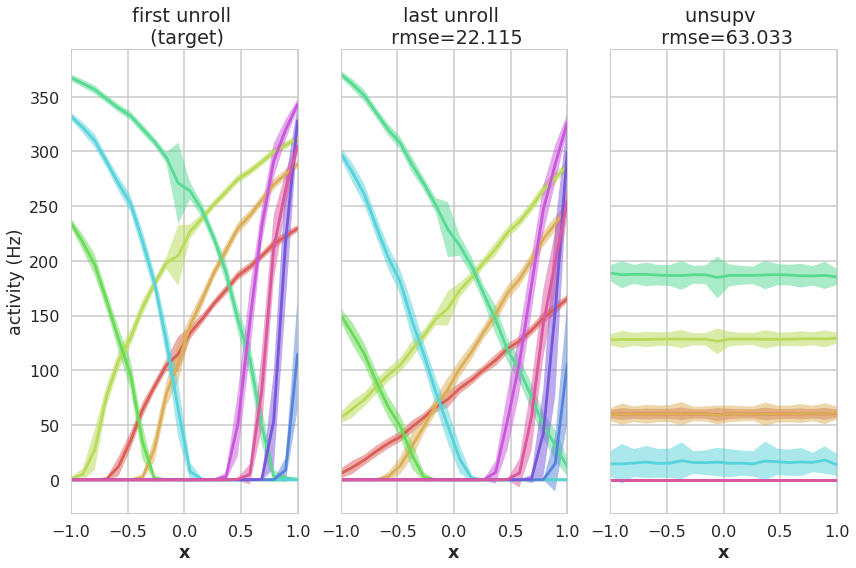

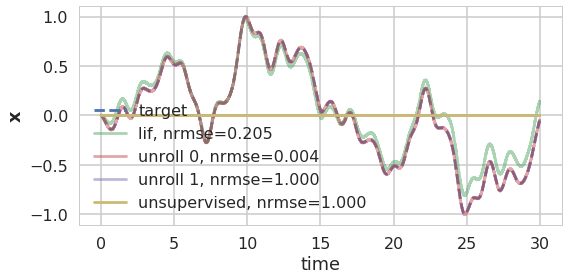

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

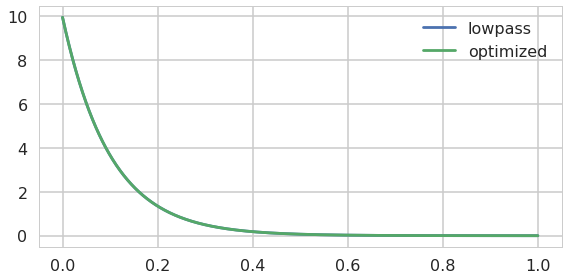

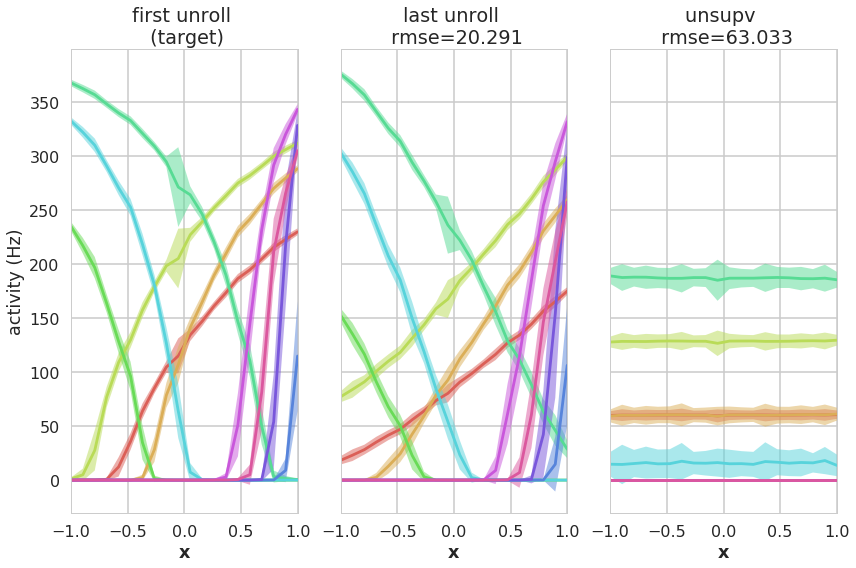

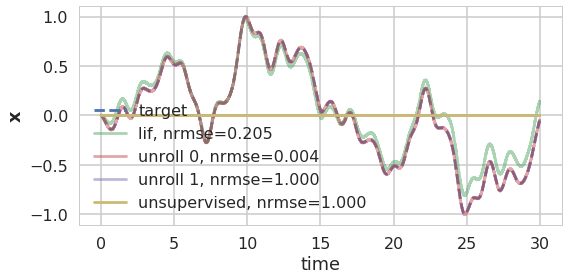

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

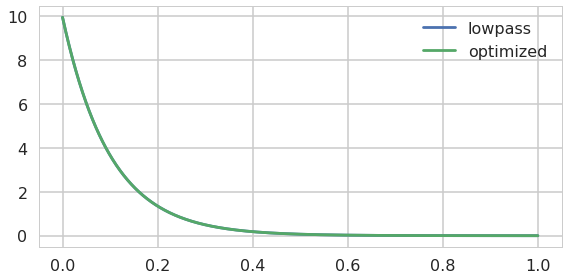

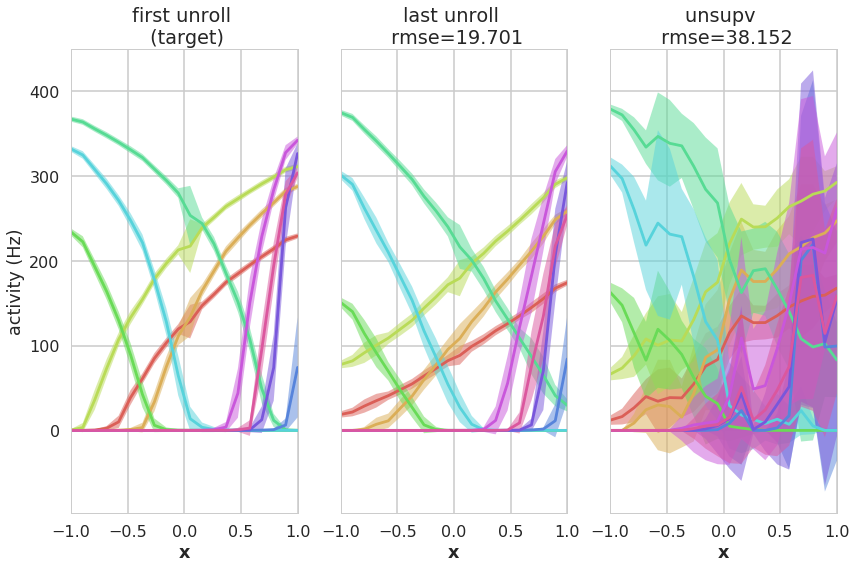

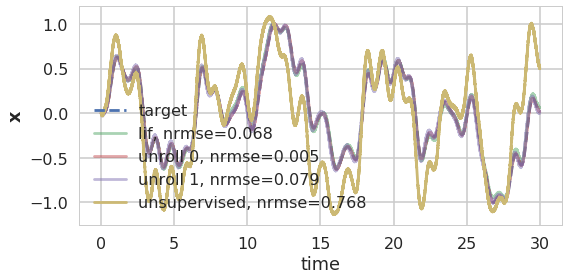

In [17]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-6,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'e_last', 'e_last', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

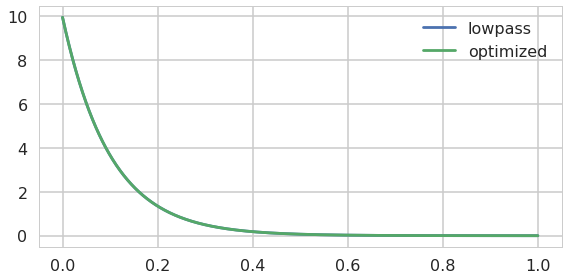

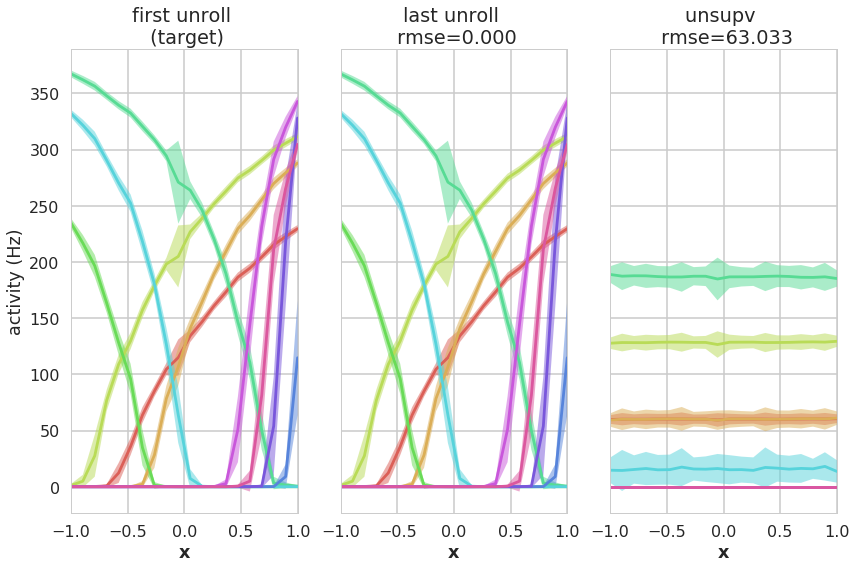

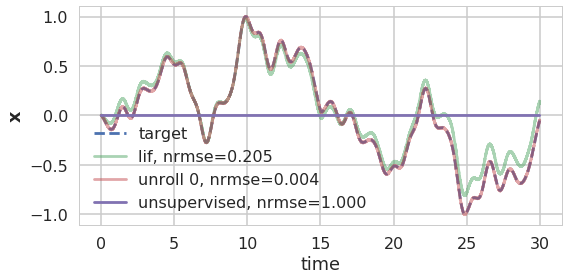

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

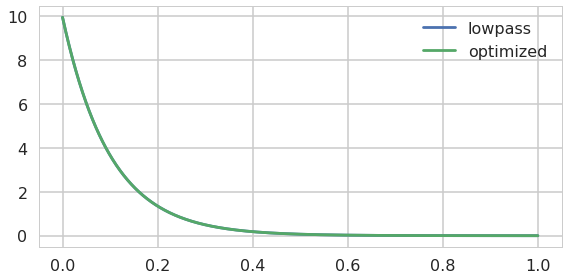

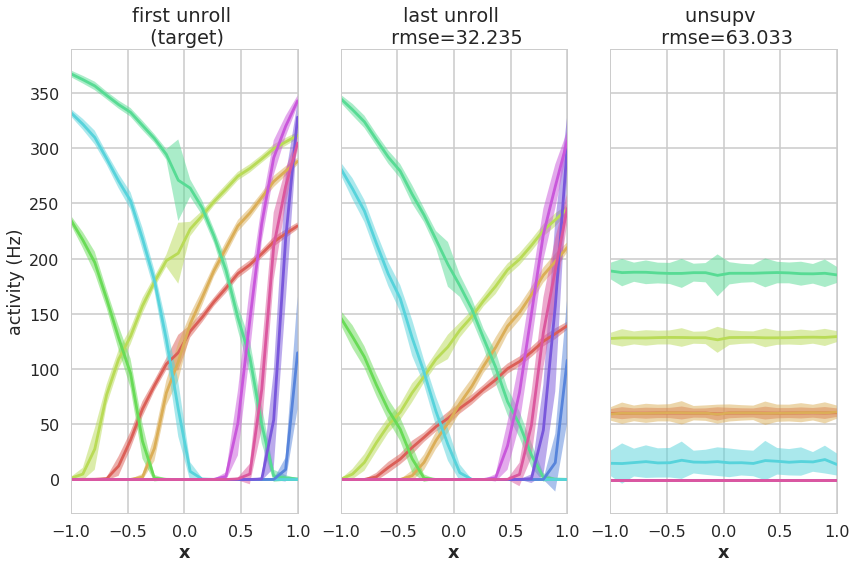

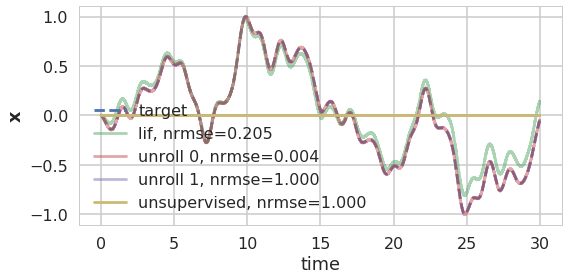

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

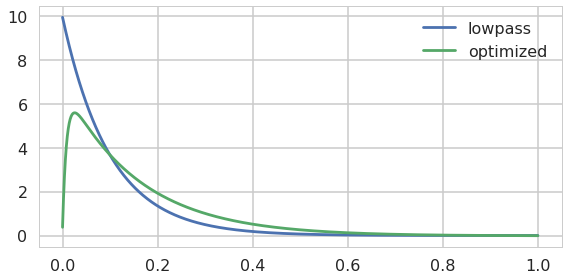

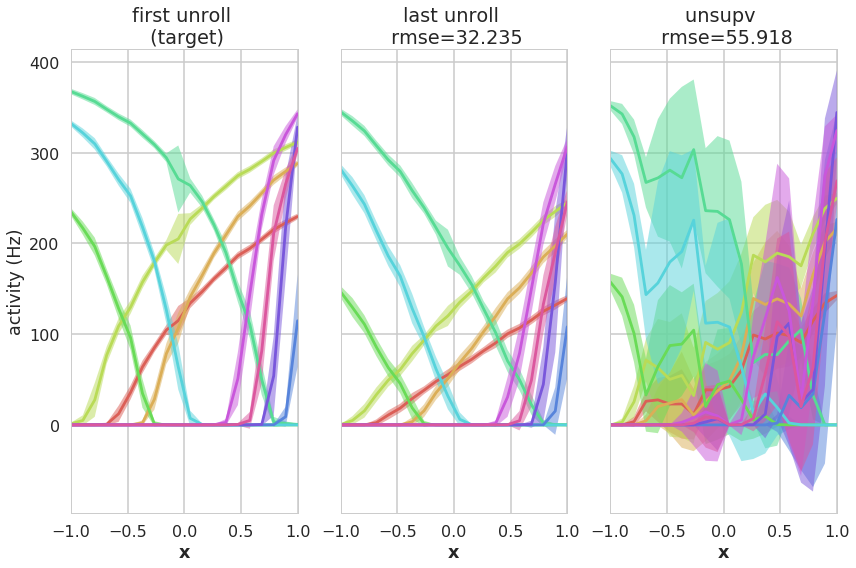

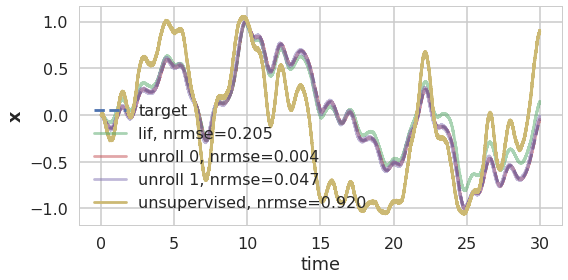

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

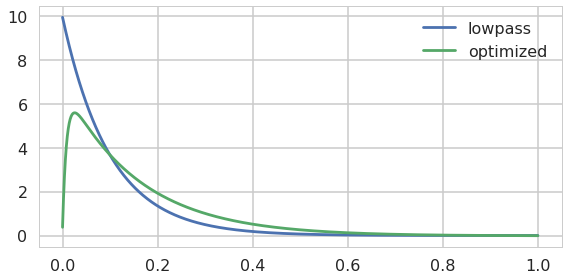

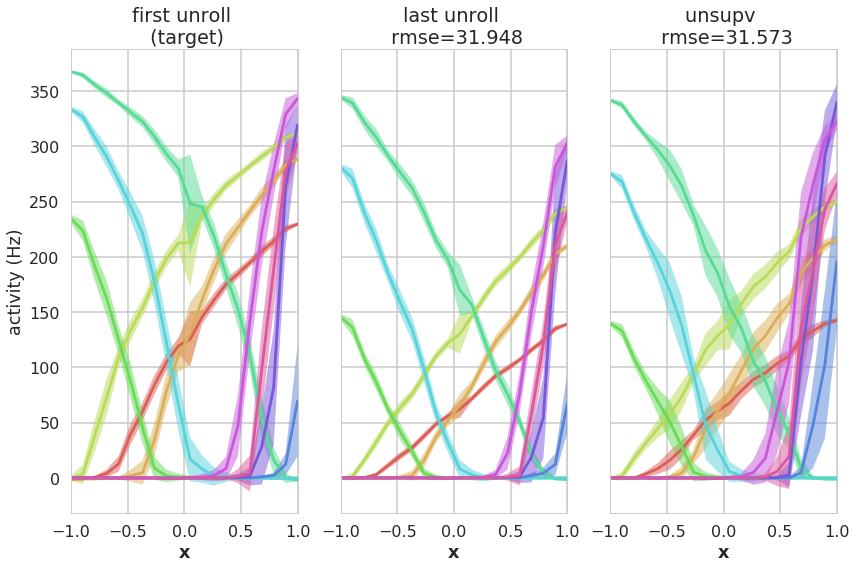

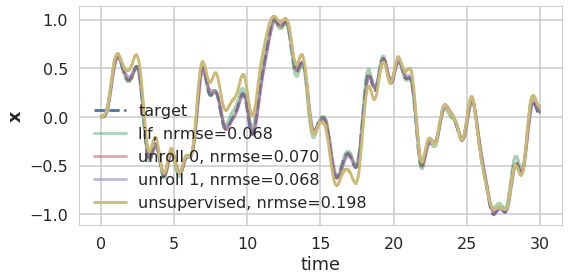

In [18]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'h']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### decoder, encoder, filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

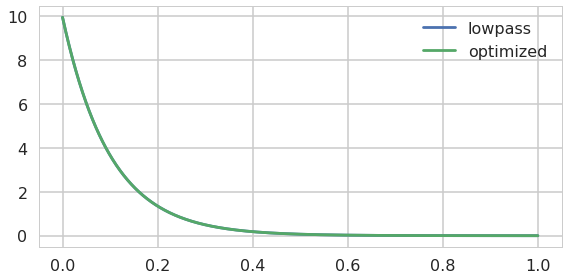

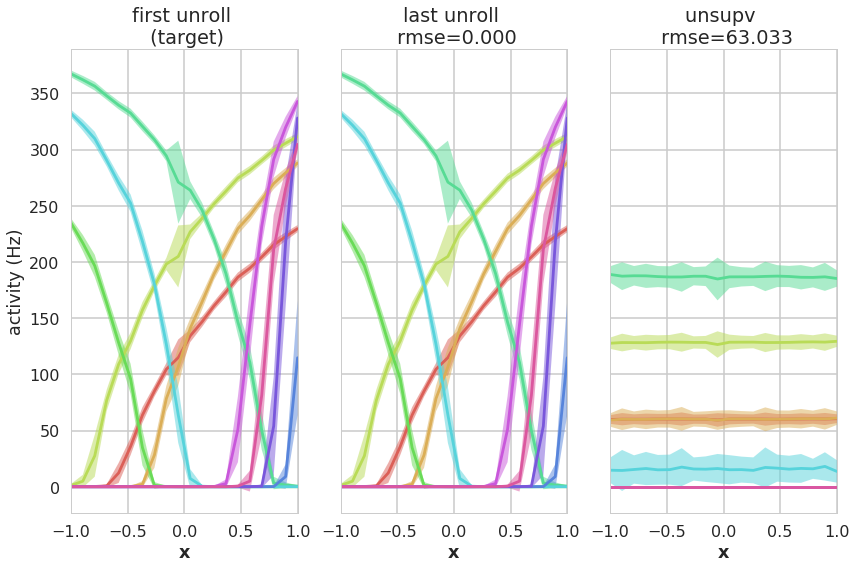

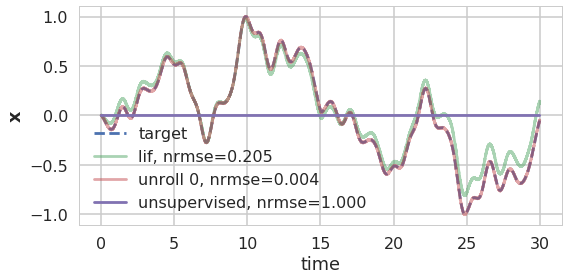

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

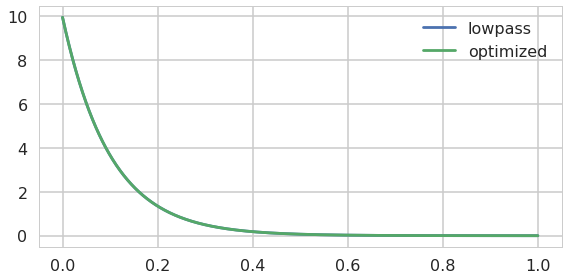

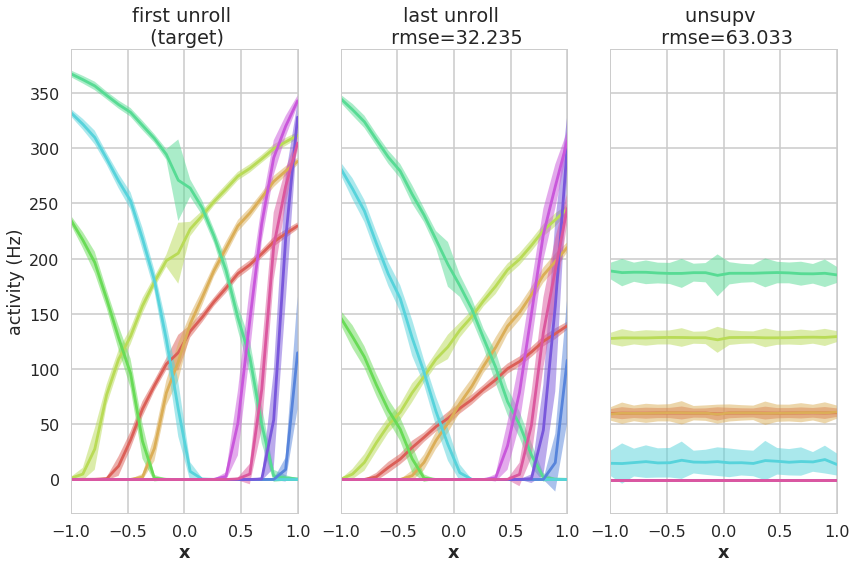

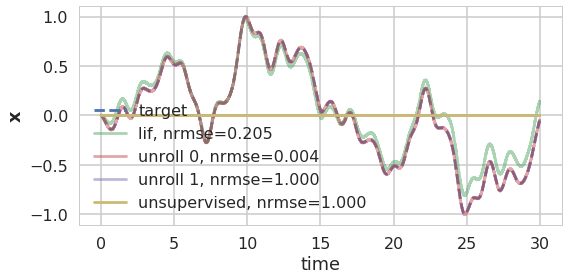

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

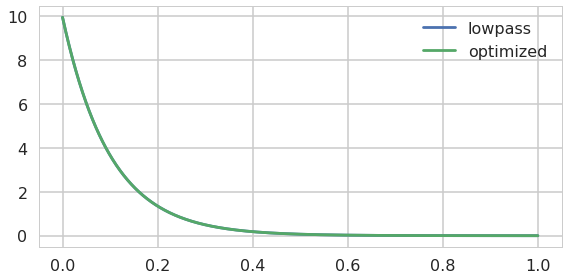

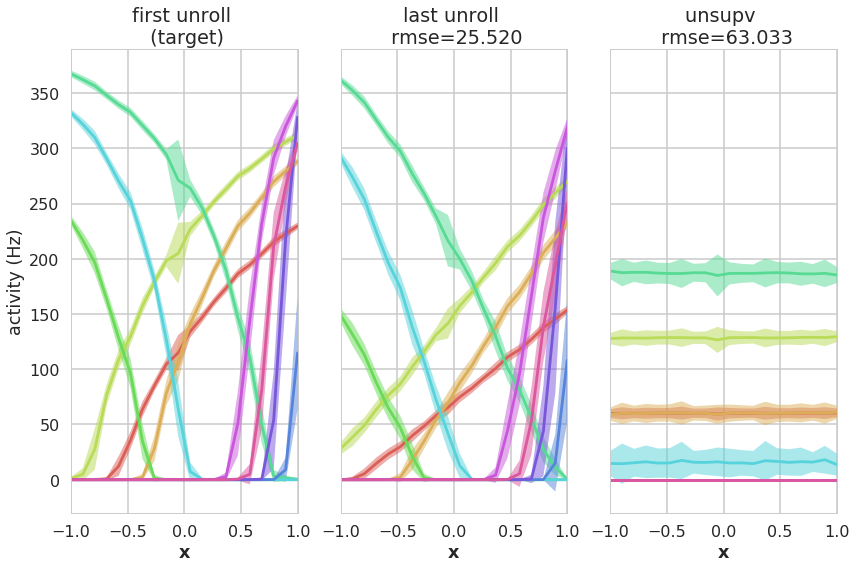

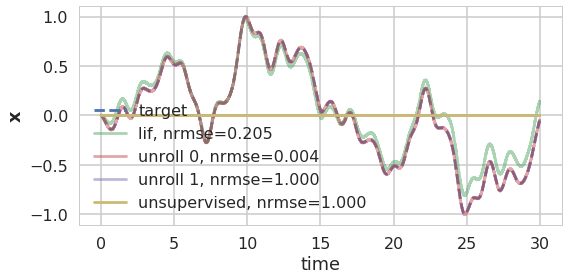

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

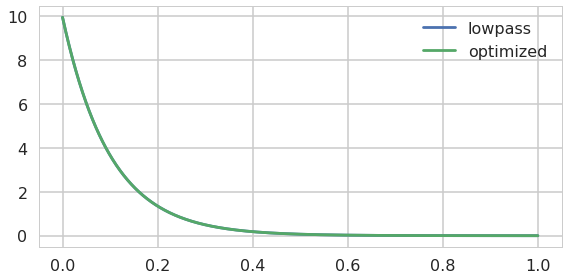

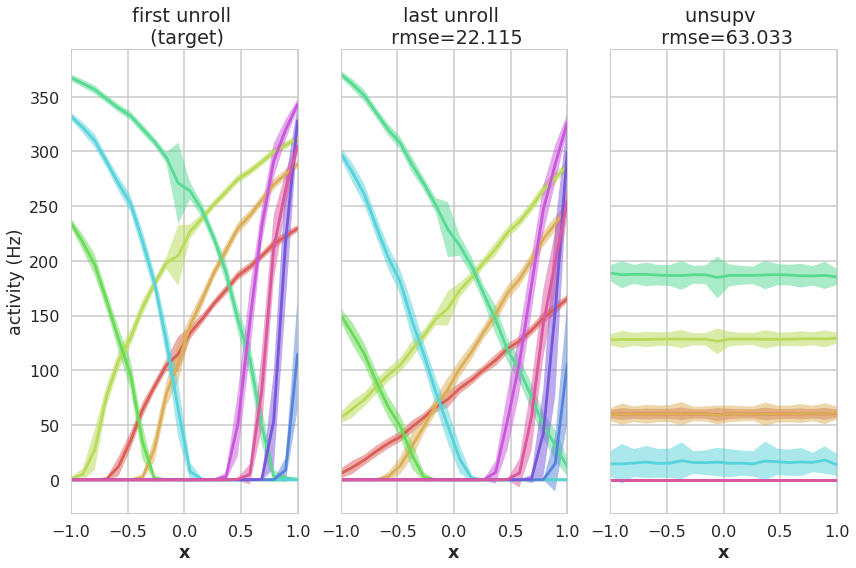

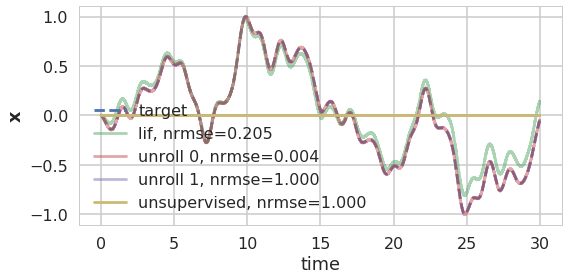

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

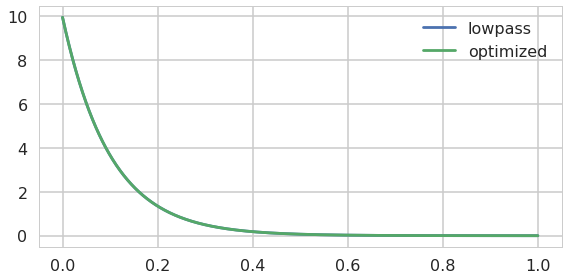

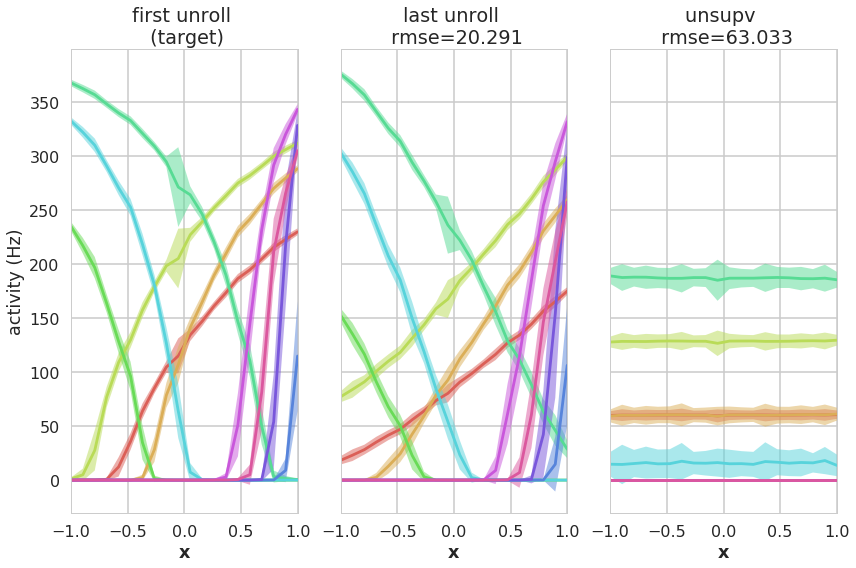

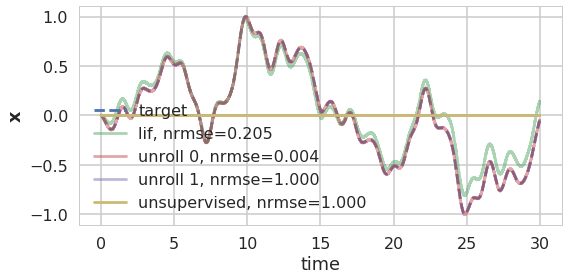

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

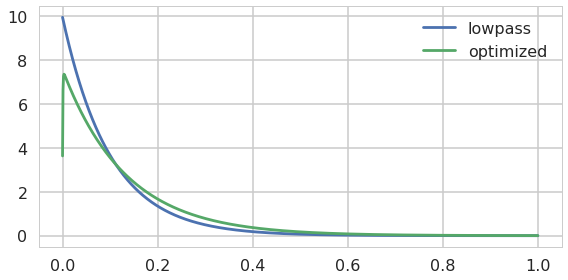

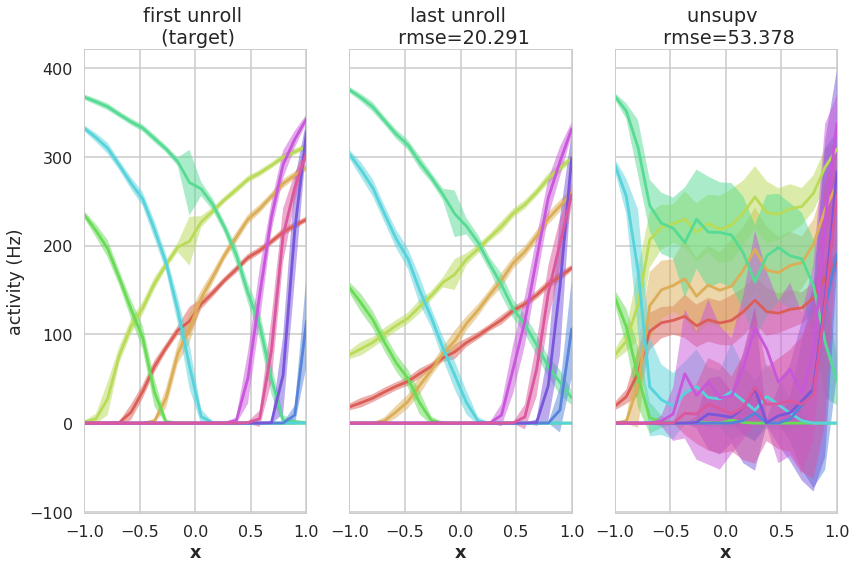

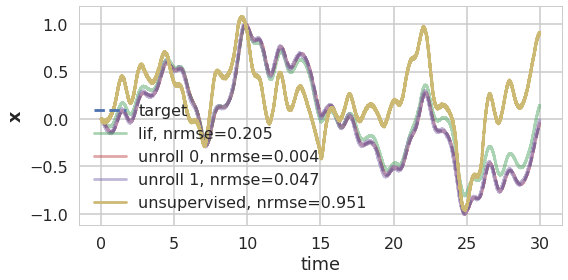

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

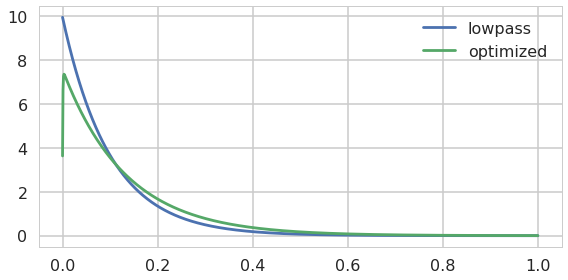

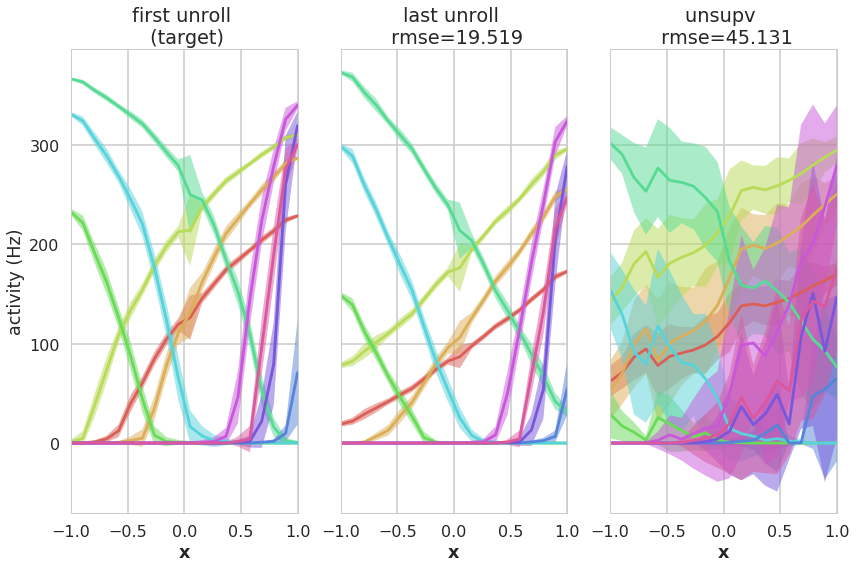

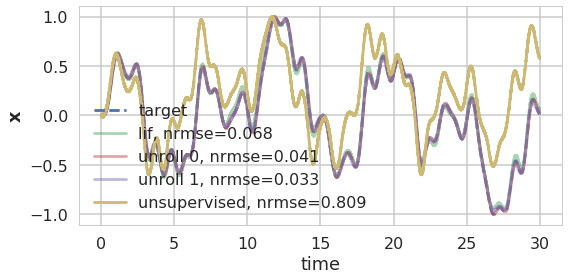

In [19]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-6,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'e_last', 'e_last', 'd_last', 'h']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### unroll with decoders and filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

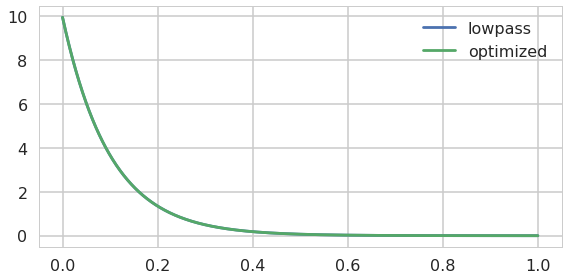

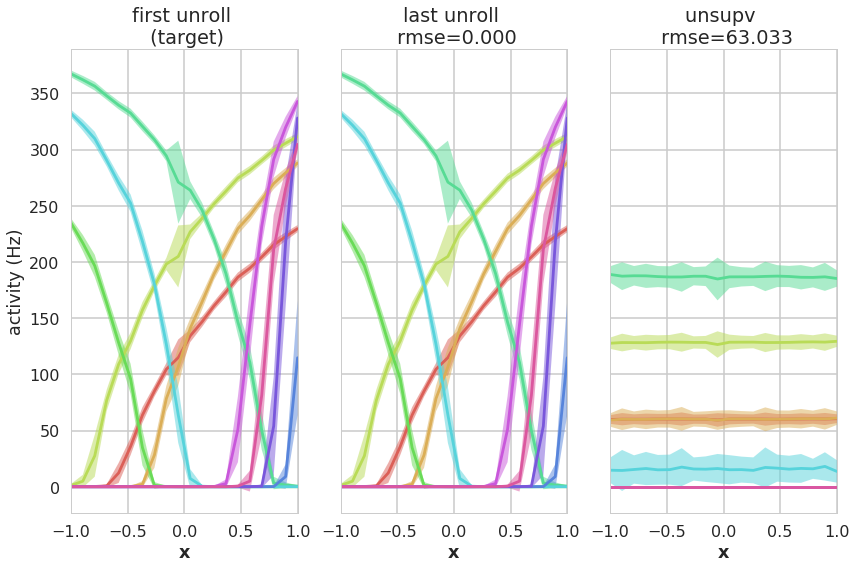

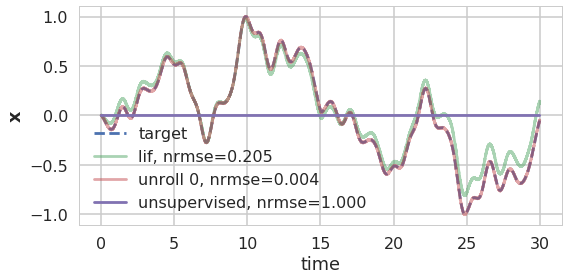

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

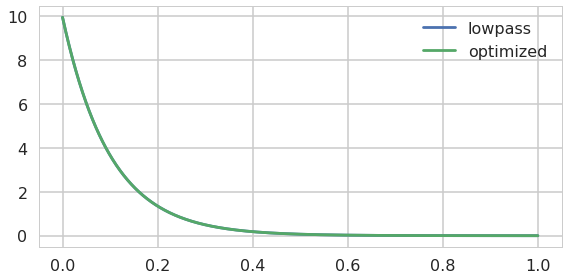

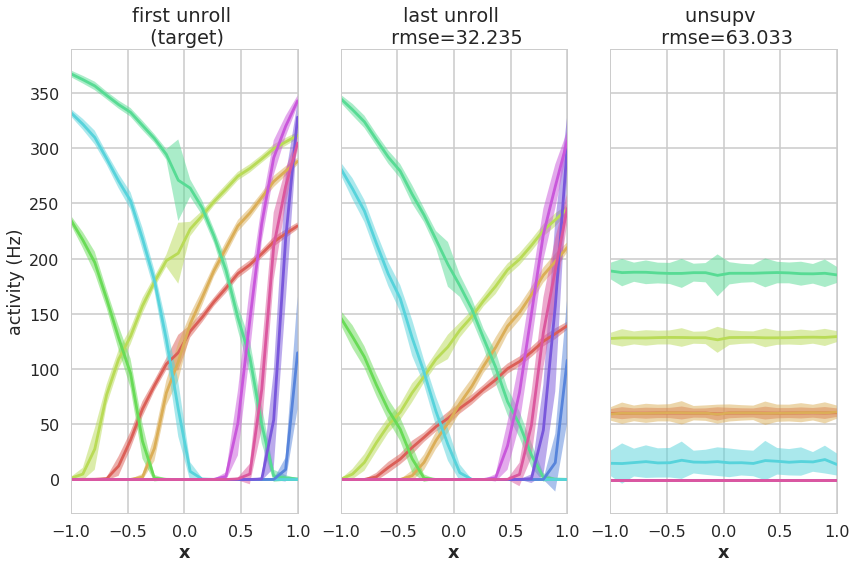

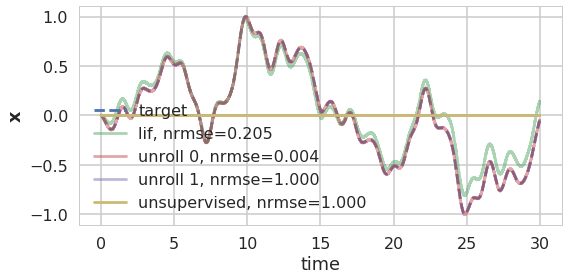

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

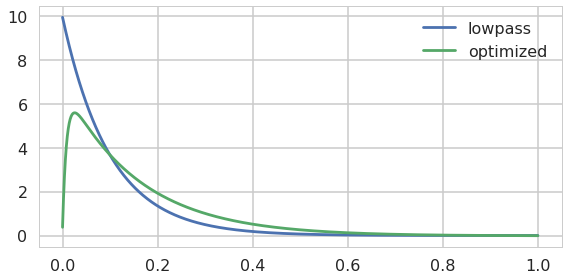

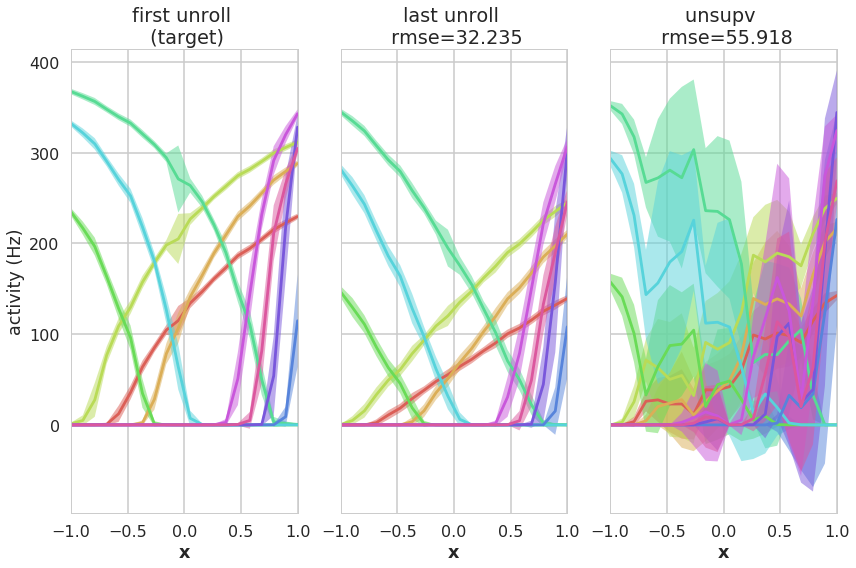

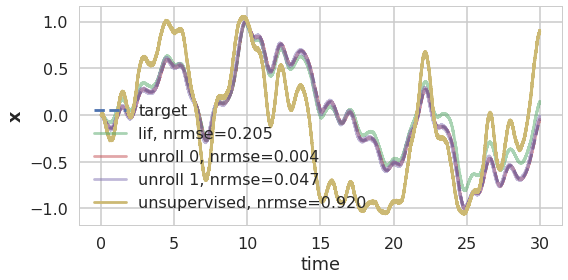

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

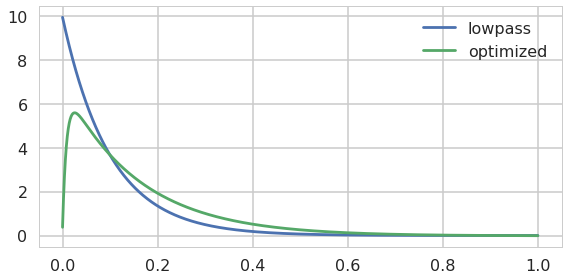

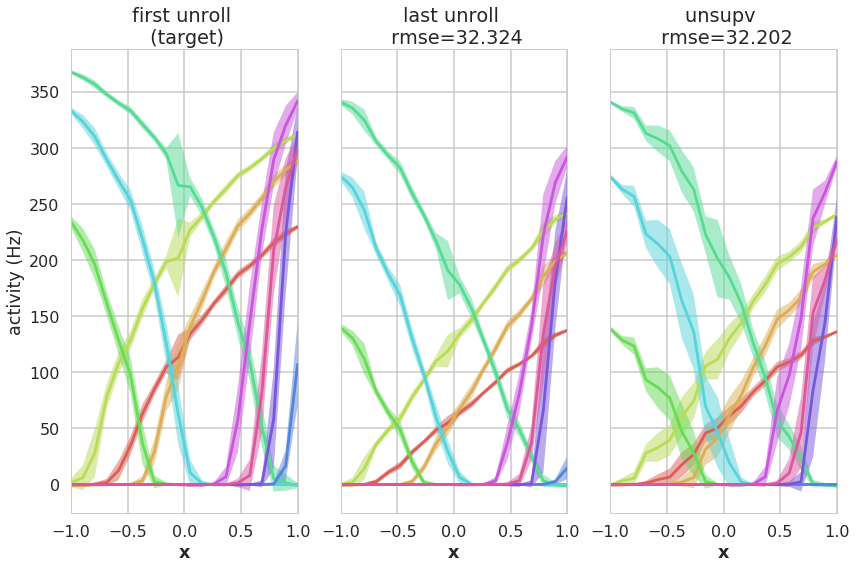

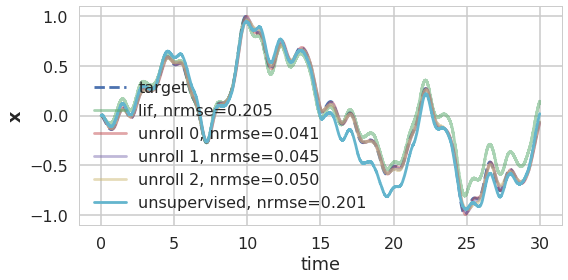

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

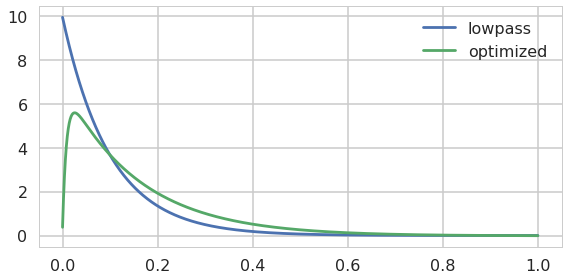

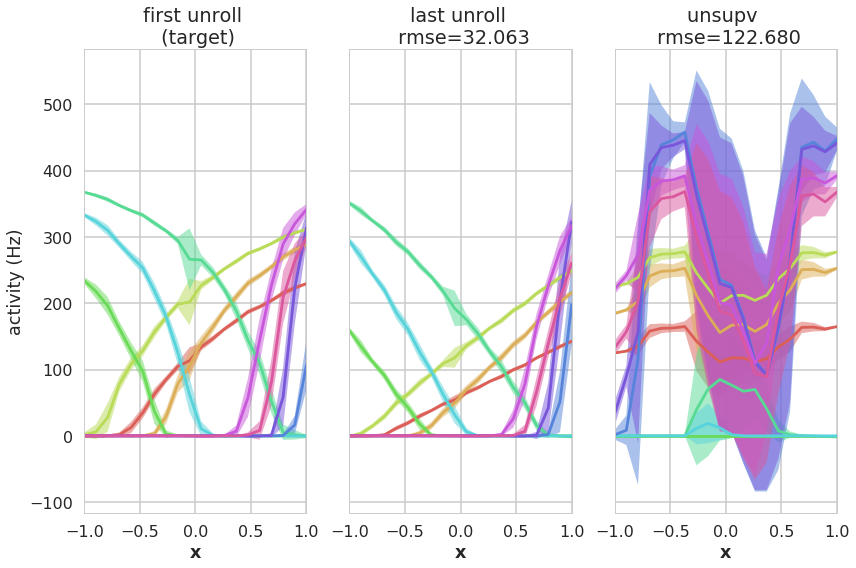

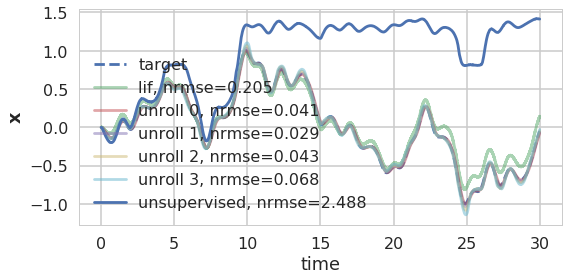

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

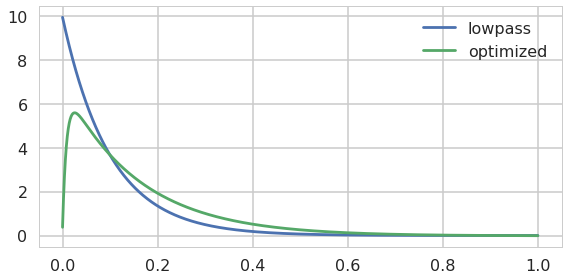

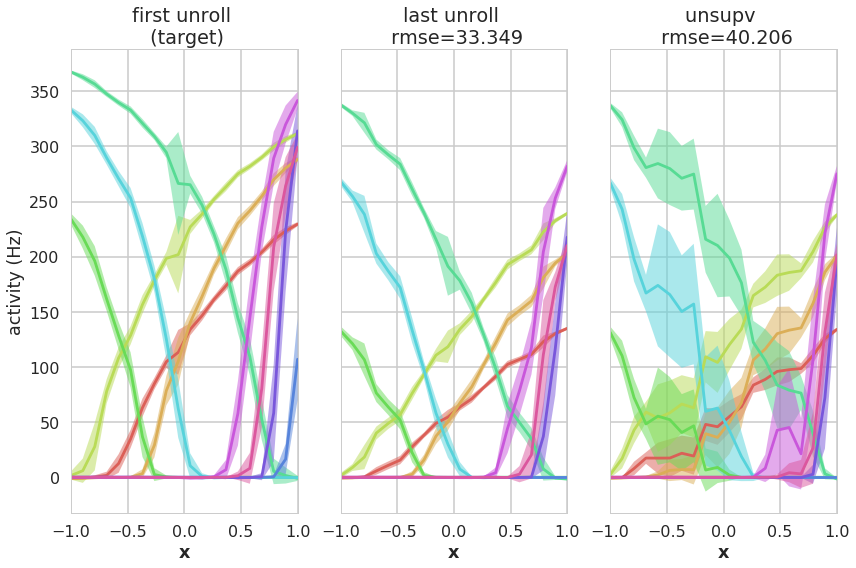

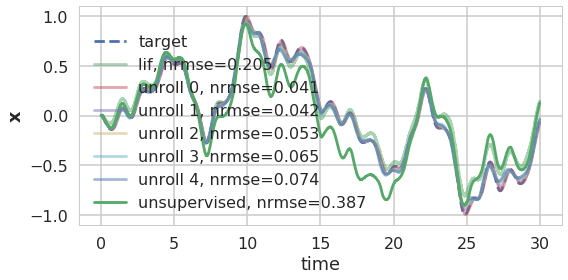

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

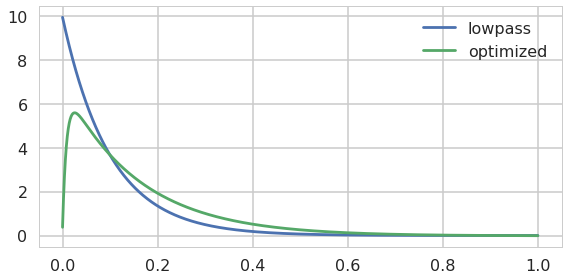

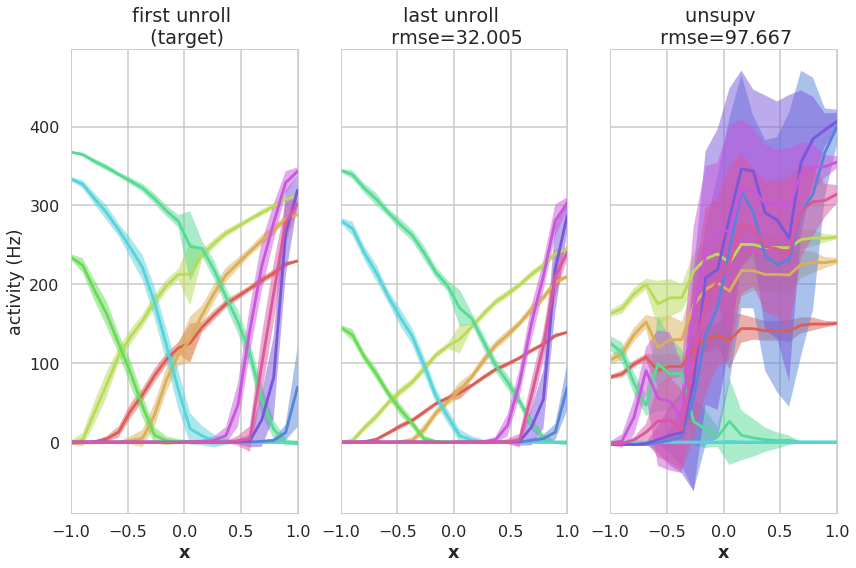

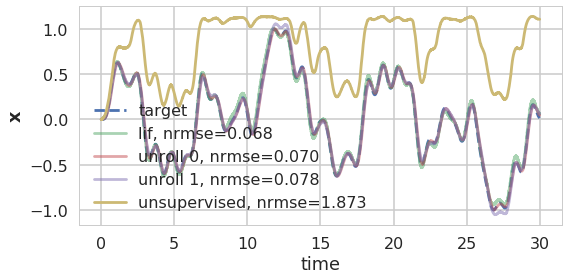

In [23]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Default,
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-6,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'h', 'r', 'd_last', 'r', 'd_last', 'r', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### lower max_rates

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

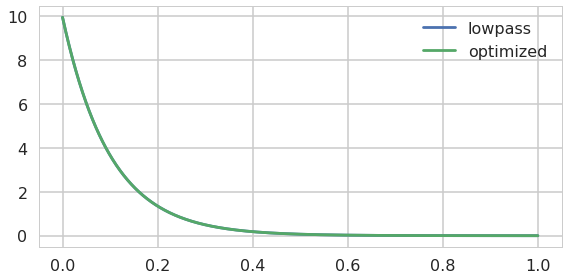

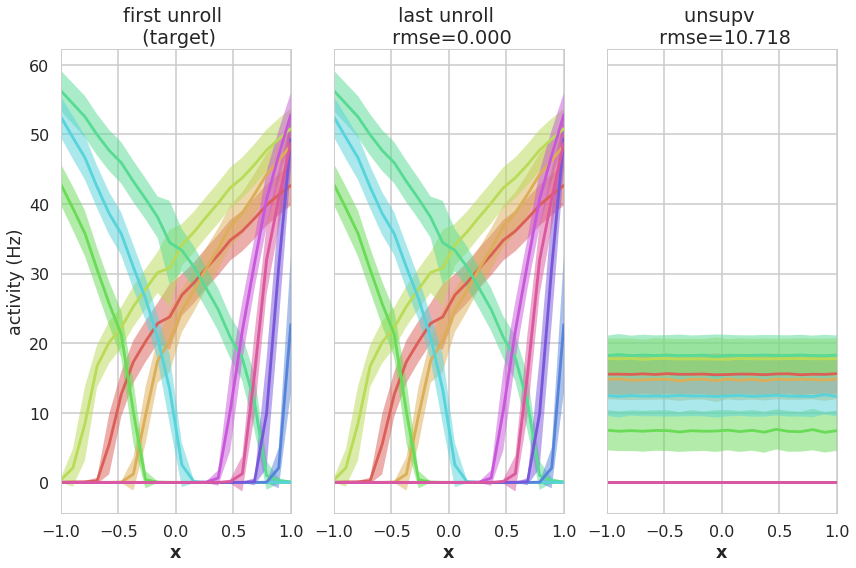

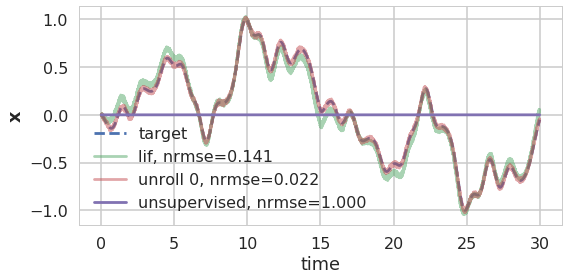

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

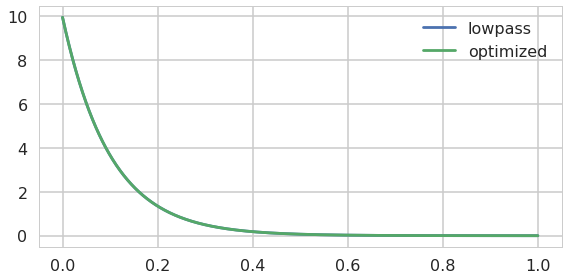

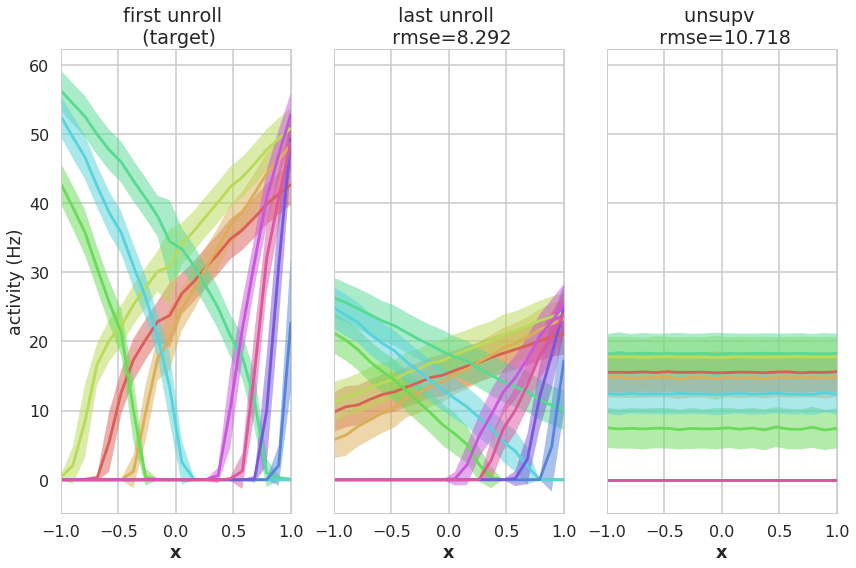

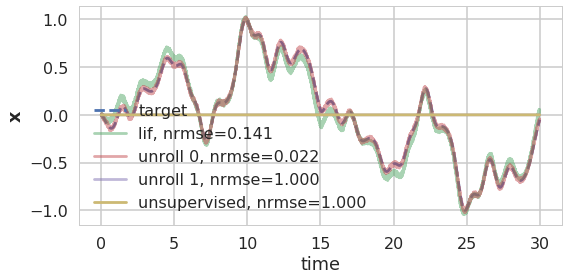

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

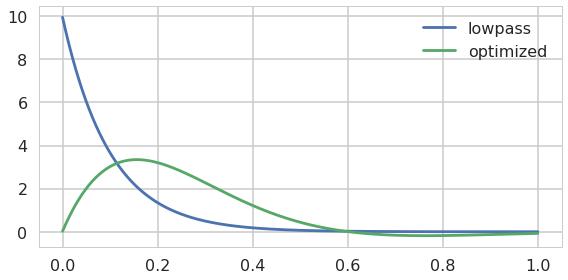

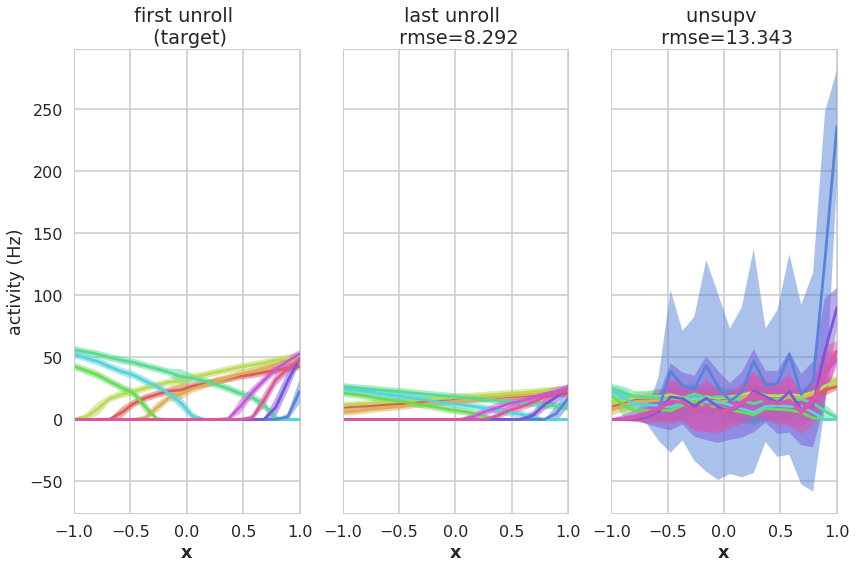

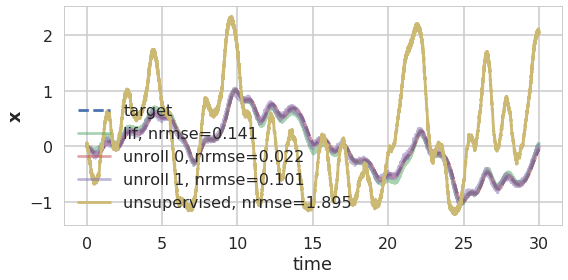

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

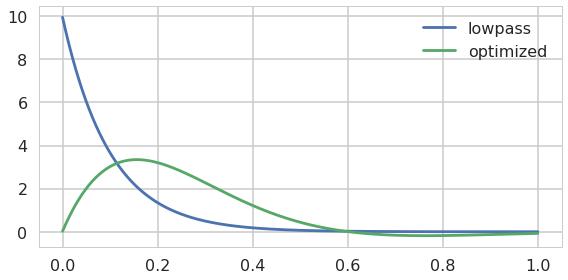

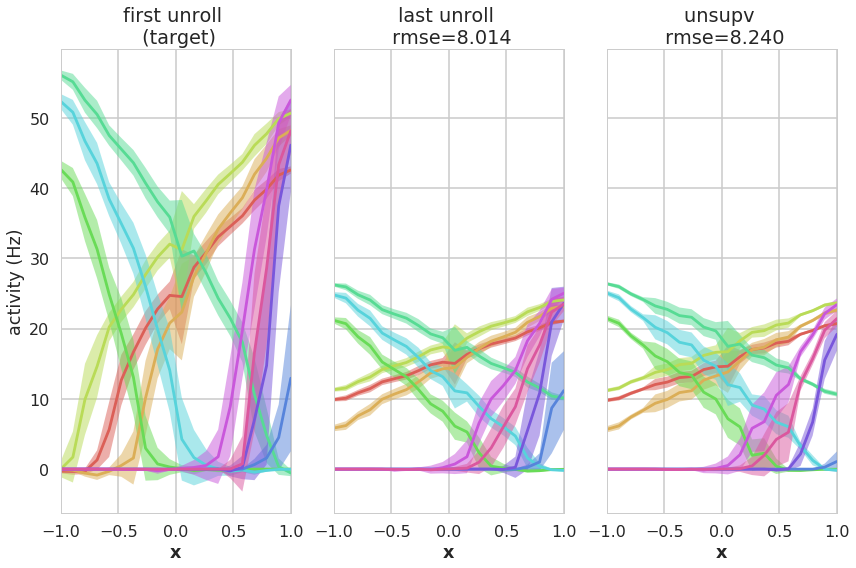

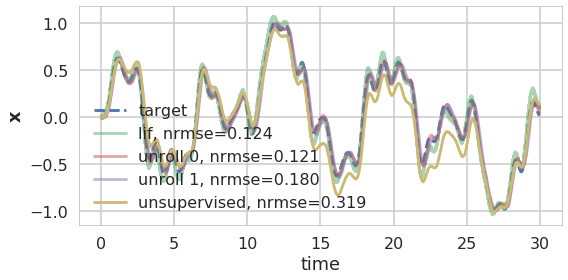

In [95]:
kwargs = dict(
    t=30,
    dt=0.001,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=2,
    beta=2,
    max_rates=Uniform(40, 60),
    neuron_type=nengo.AdaptiveLIF(tau_n=0.1, inc_n=0.1),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'h']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

## Wilson Neuron

### decoder

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

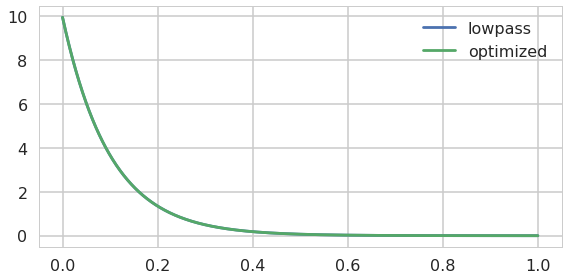

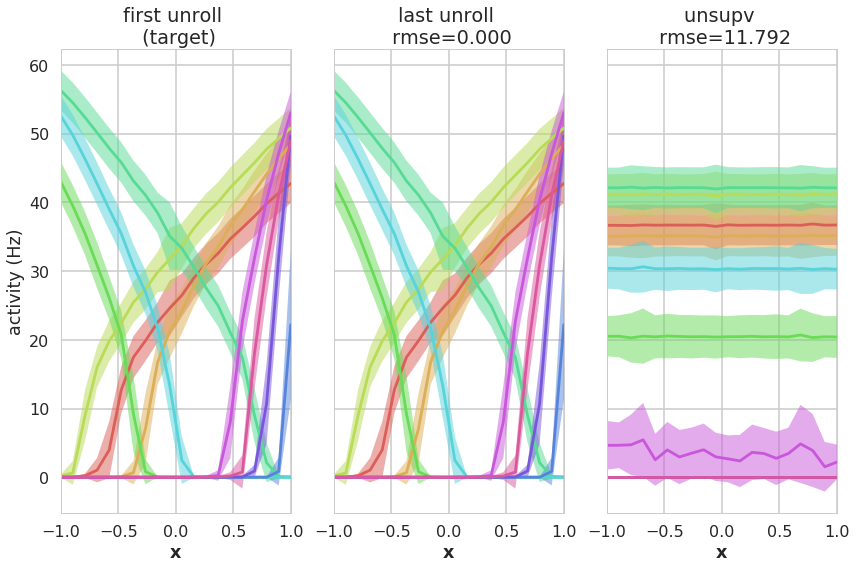

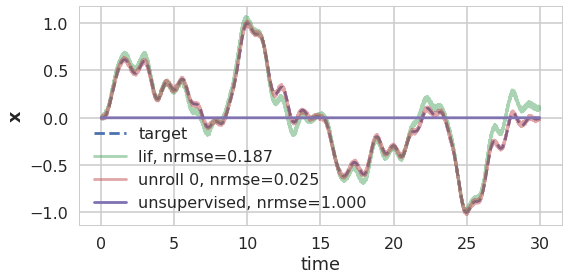

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

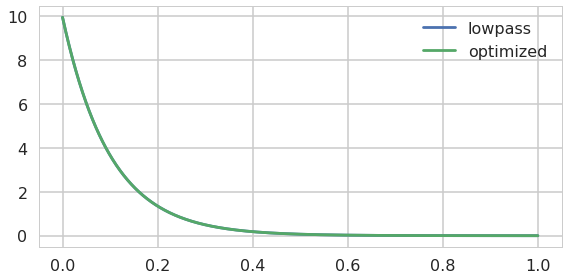

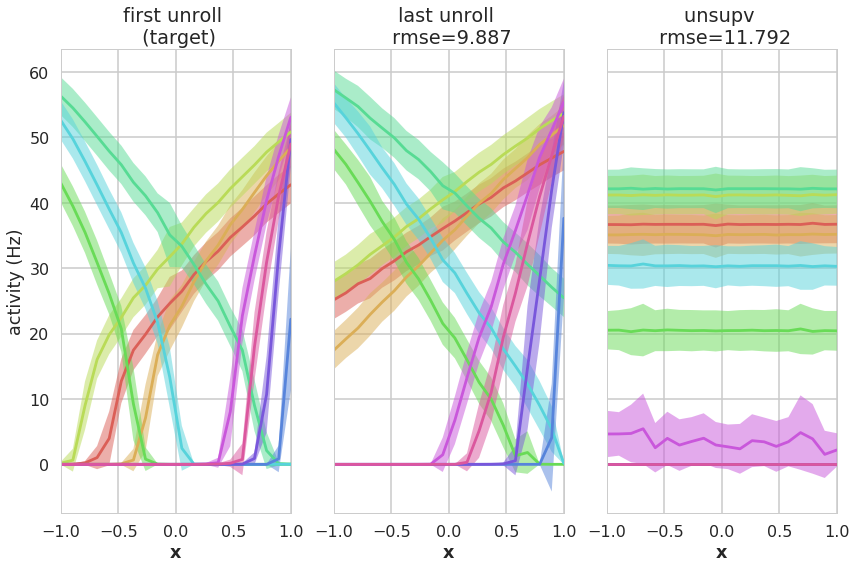

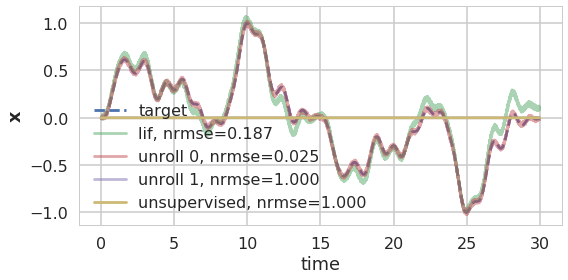

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

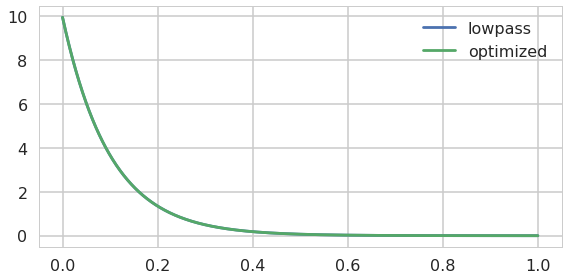

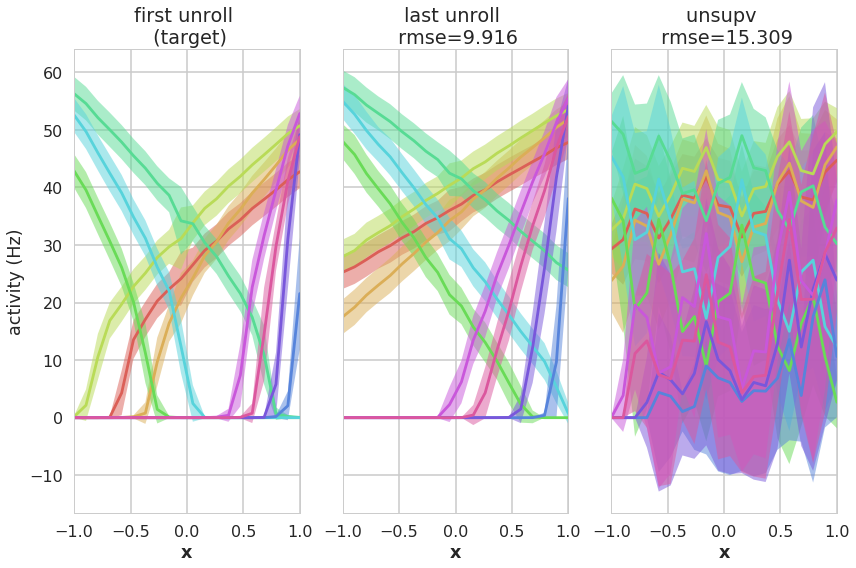

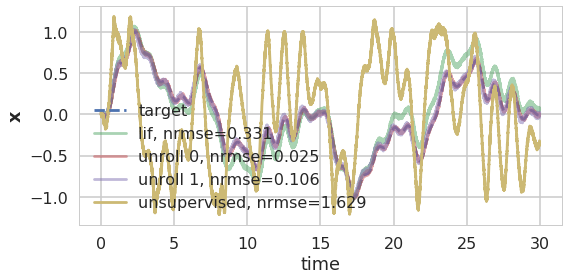

In [93]:
kwargs = dict(
    t=30,
    dt=0.00005,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Uniform(40, 60),
    neuron_type=WilsonNeuron(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### encoder

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

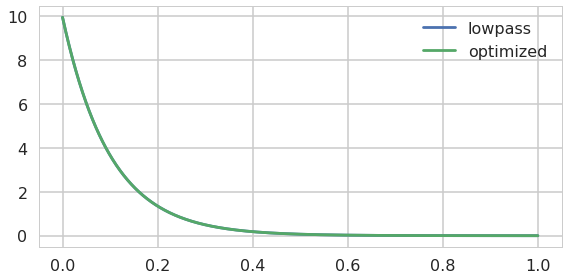

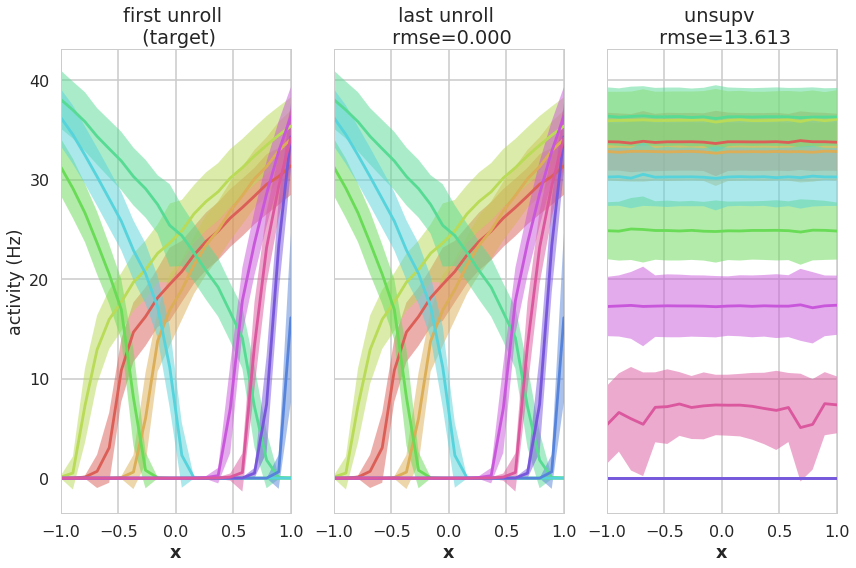

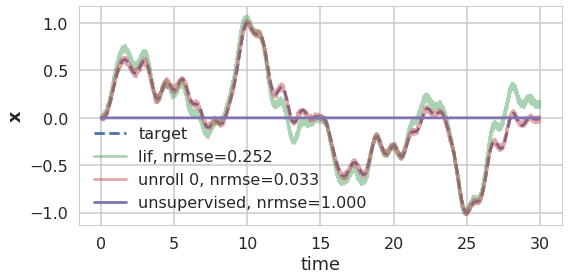

updating r
updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

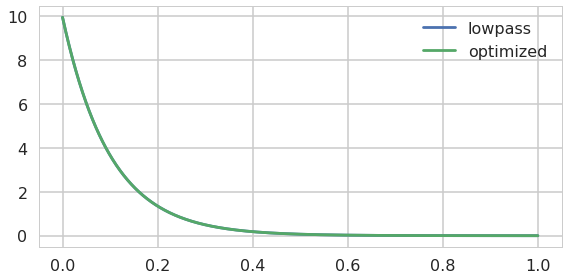

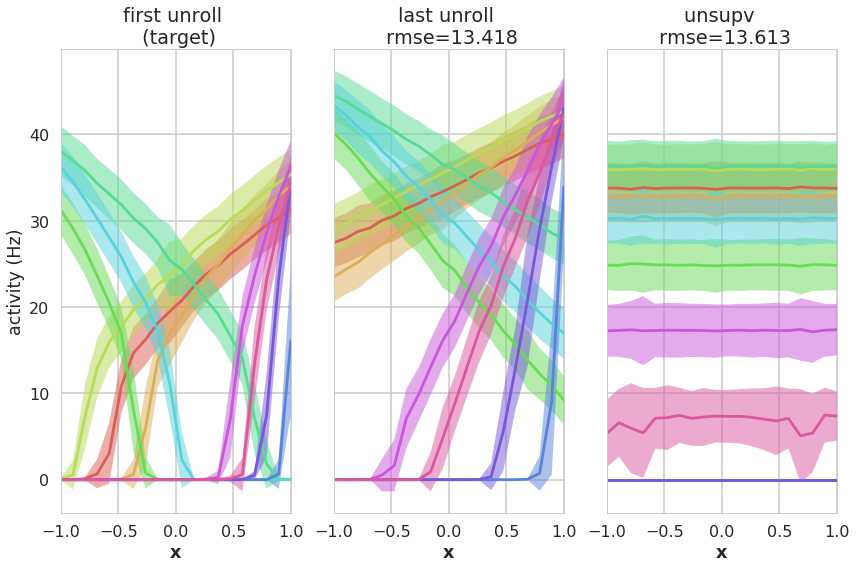

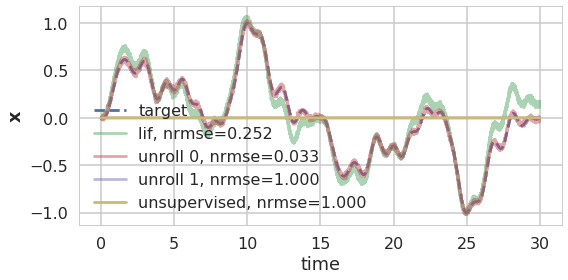

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

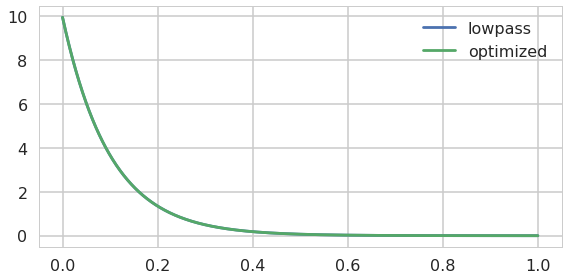

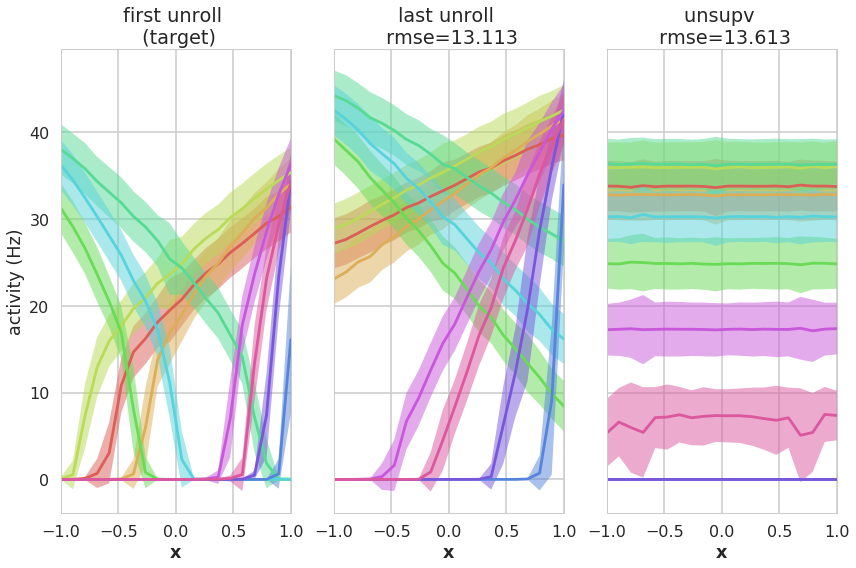

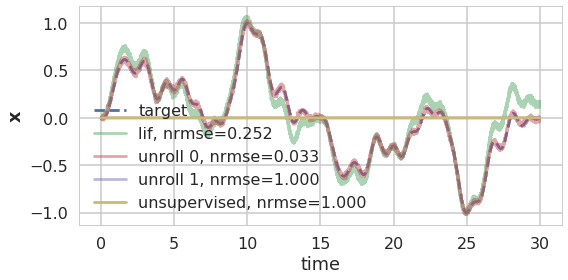

updating e_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

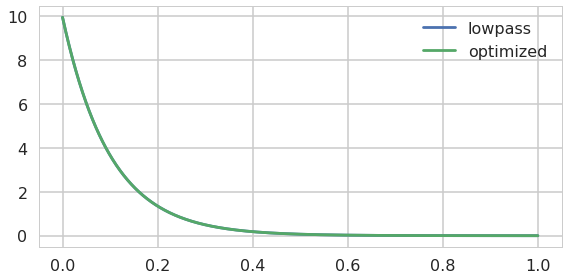

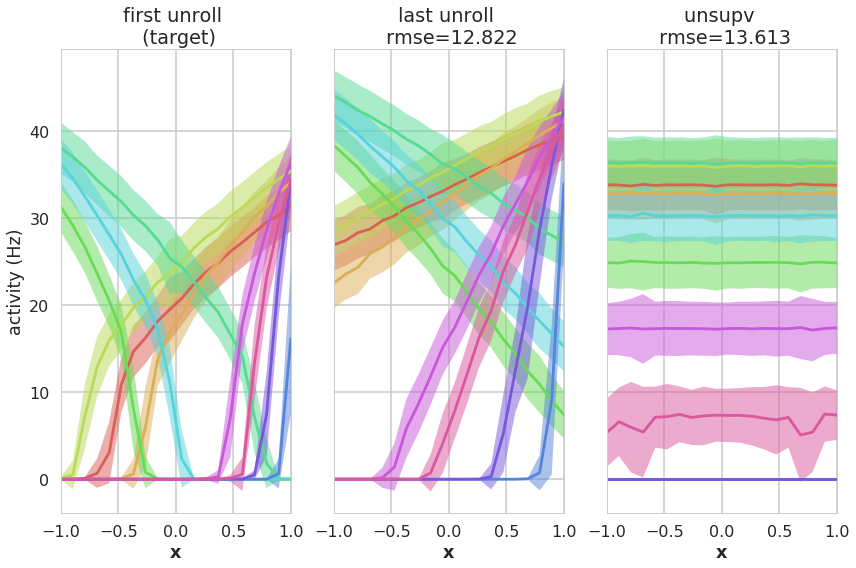

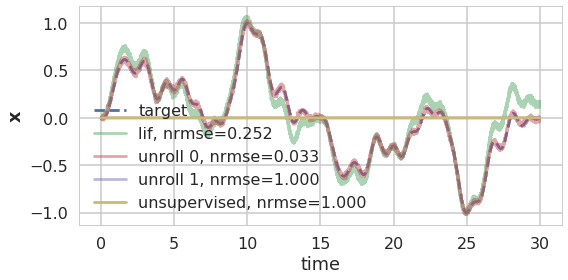

updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

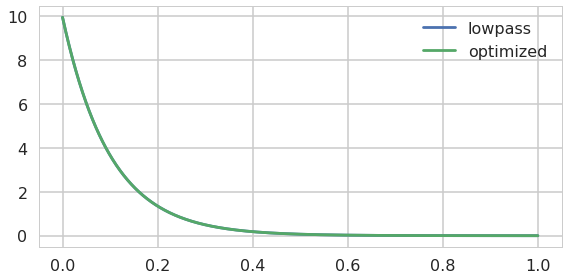

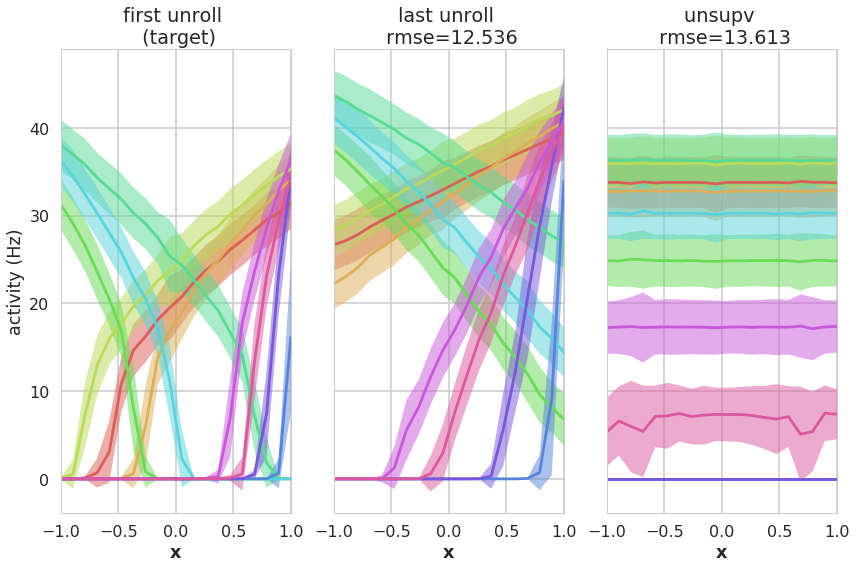

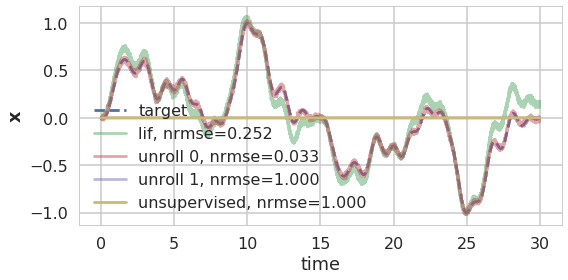

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

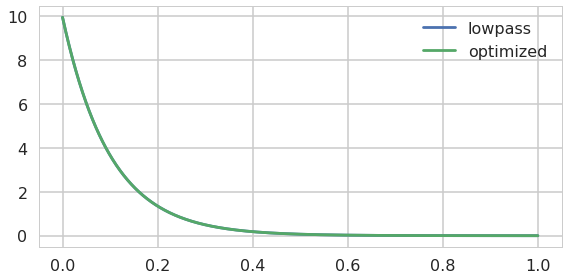

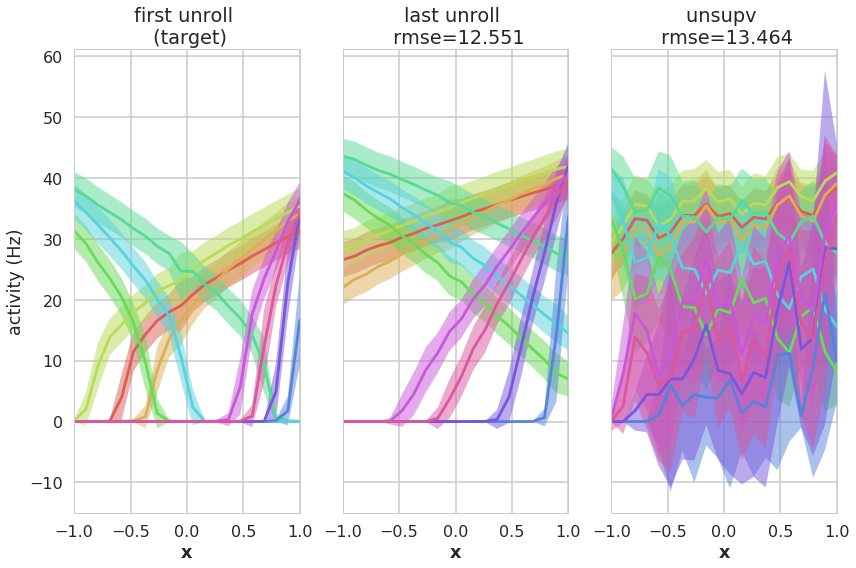

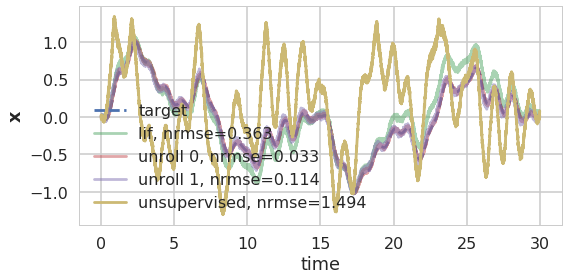

In [106]:
kwargs = dict(
    t=30,
    dt=0.00005,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Uniform(30, 40),
    neuron_type=WilsonNeuron(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=1e-6,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'e_last', 'e_last', 'e_last', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### filter

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

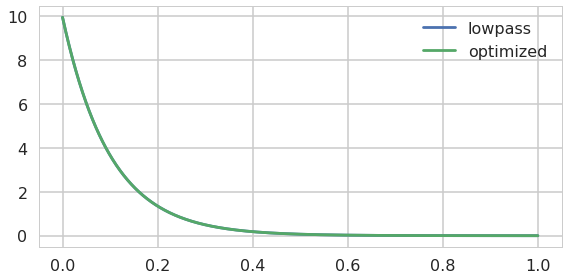

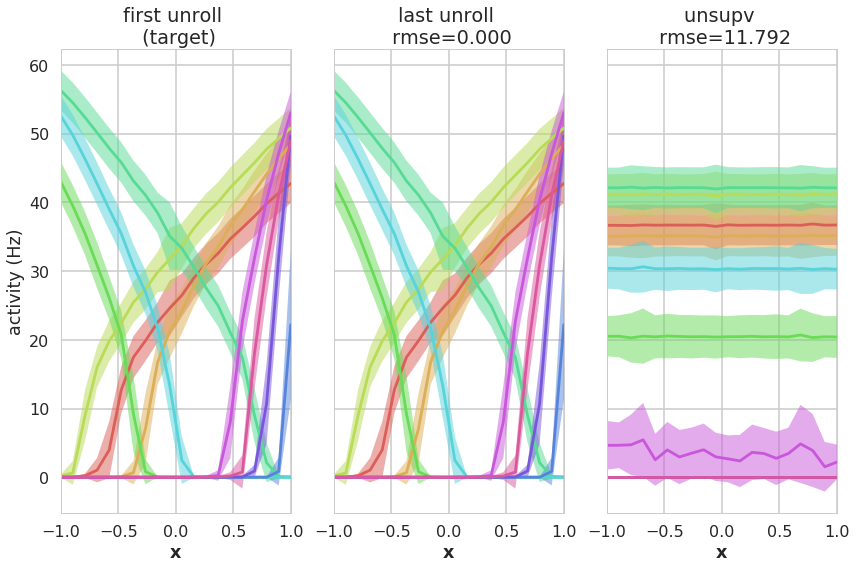

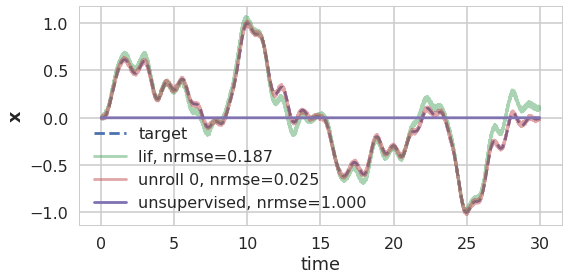

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

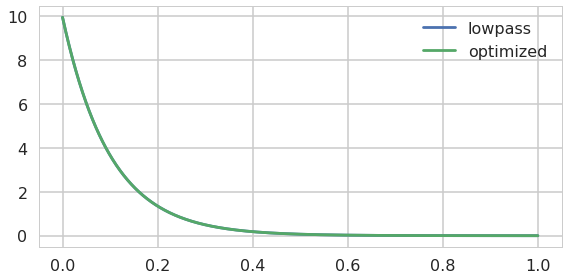

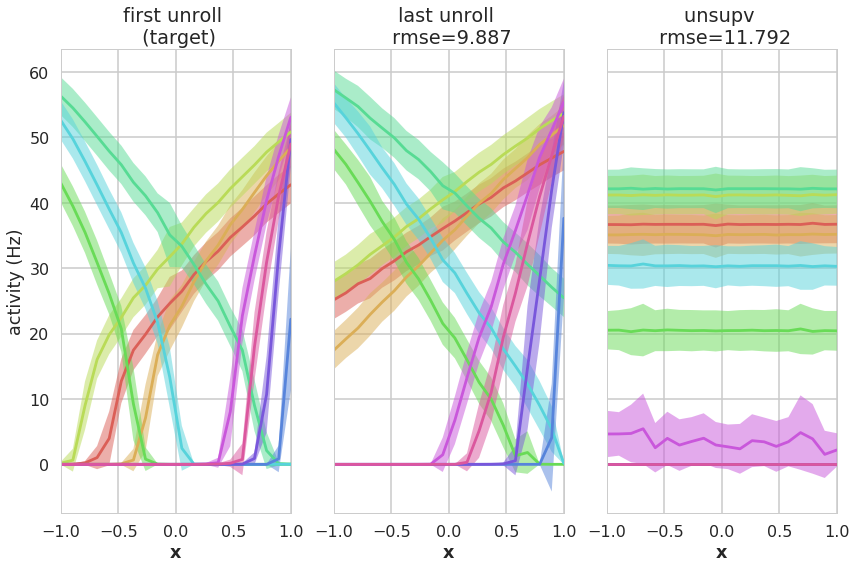

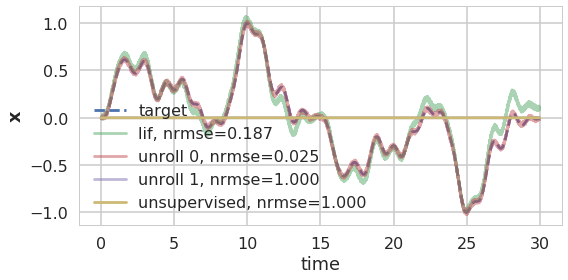

updating h


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

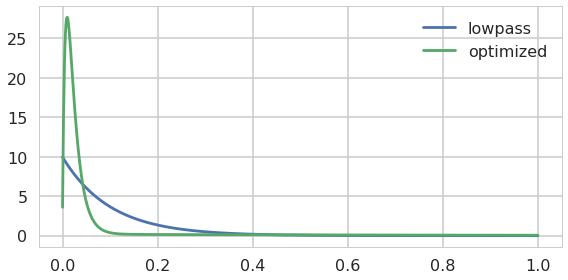

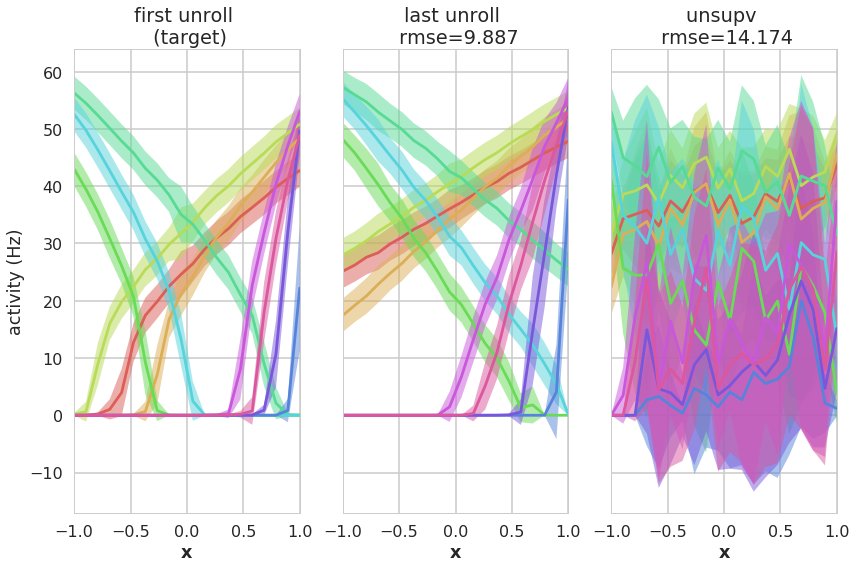

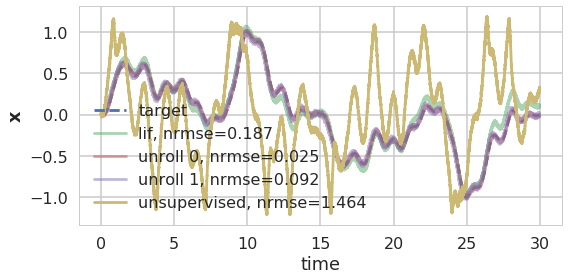

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

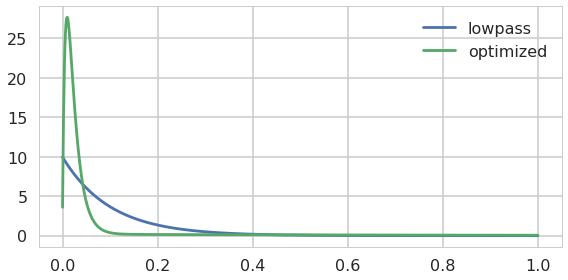

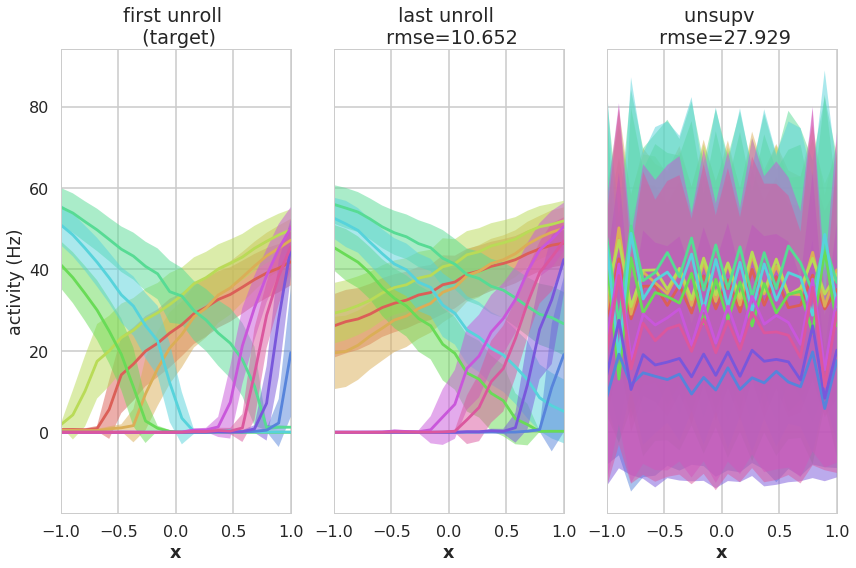

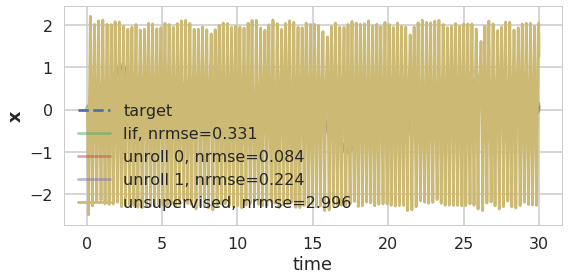

In [34]:
kwargs = dict(
    t=30,
    dt=0.00005,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Uniform(40, 60),
    neuron_type=WilsonNeuron(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'h']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)

### decoder and unroll

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

updating d_last


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

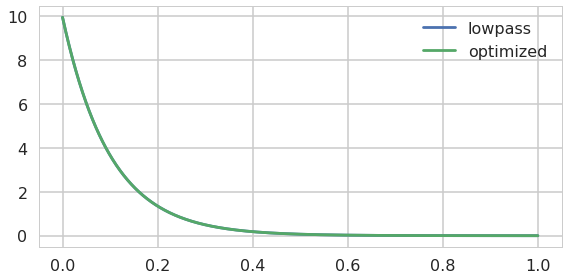

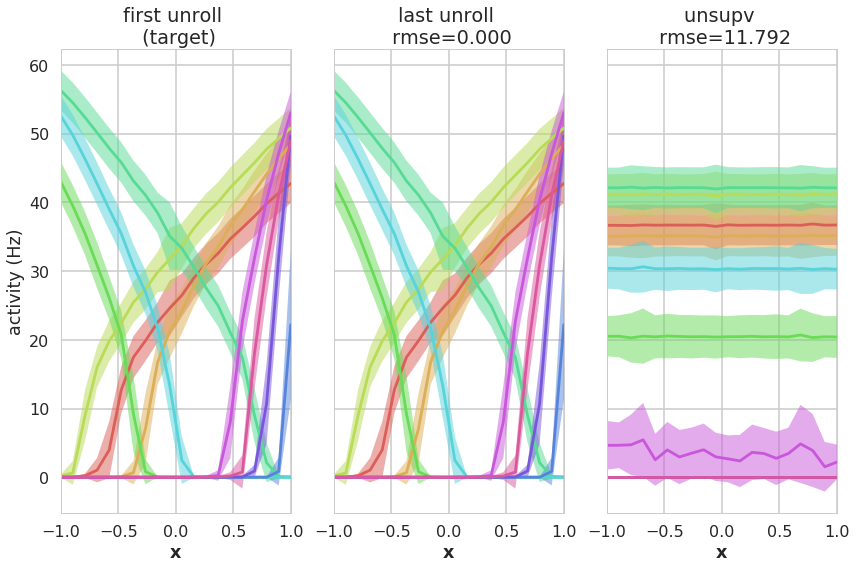

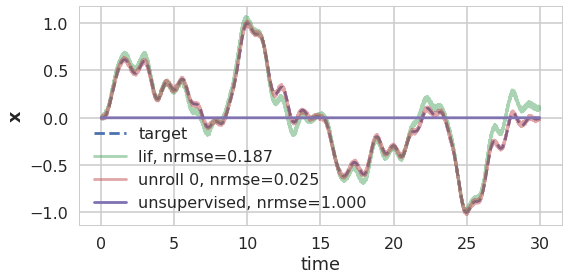

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

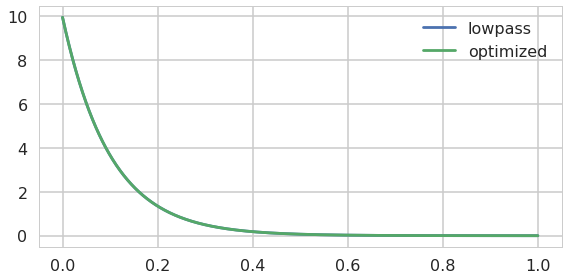

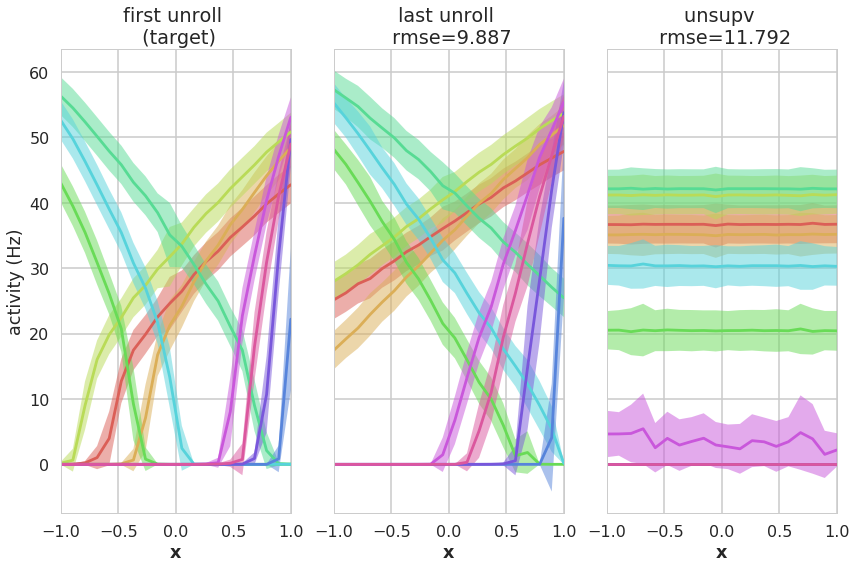

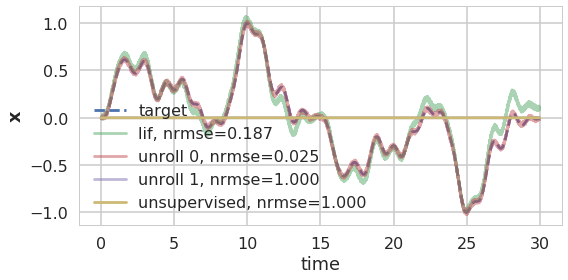

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

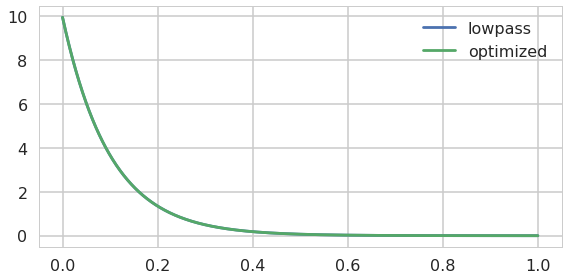

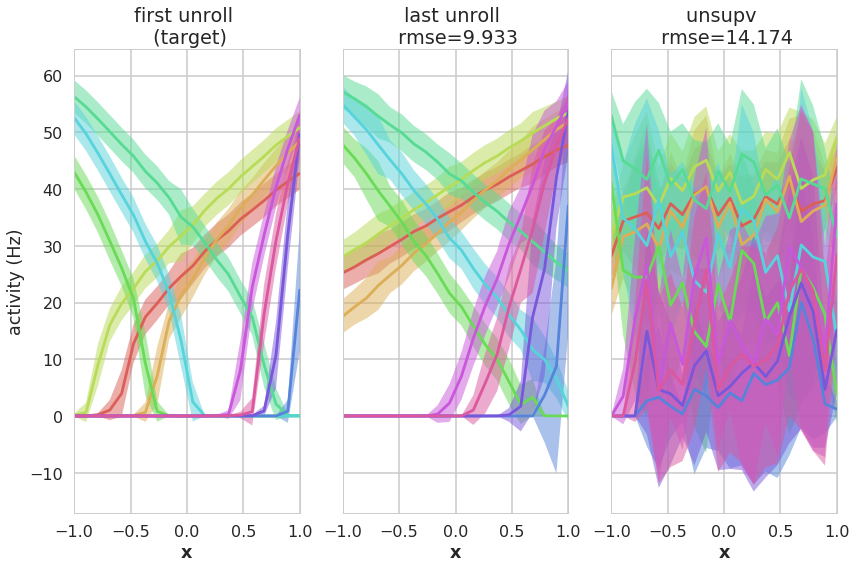

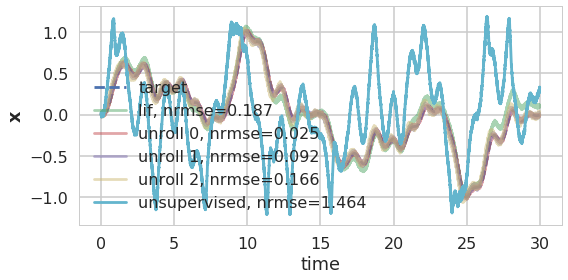

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

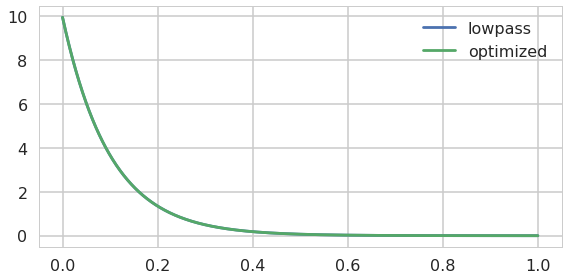

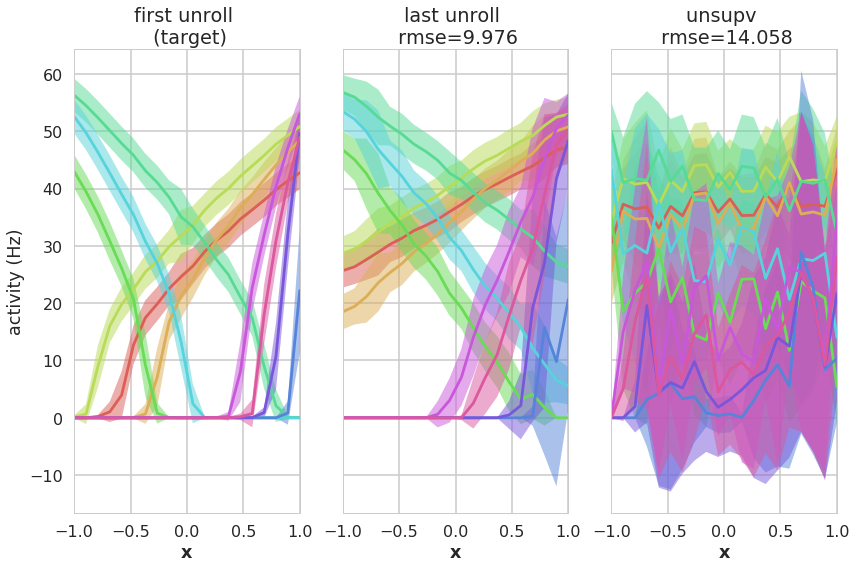

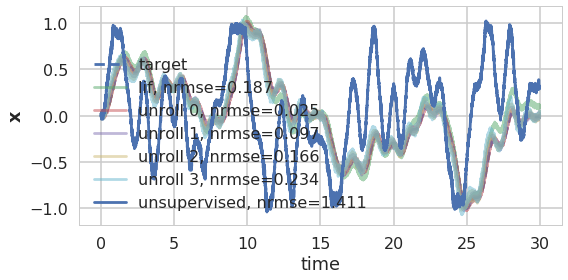

updating r
updating d_last


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

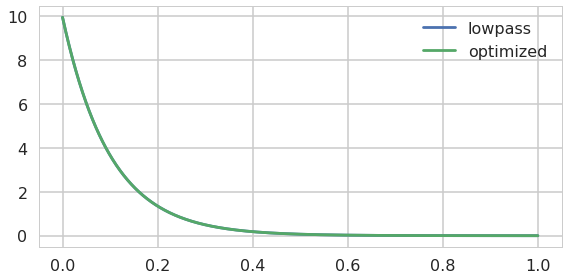

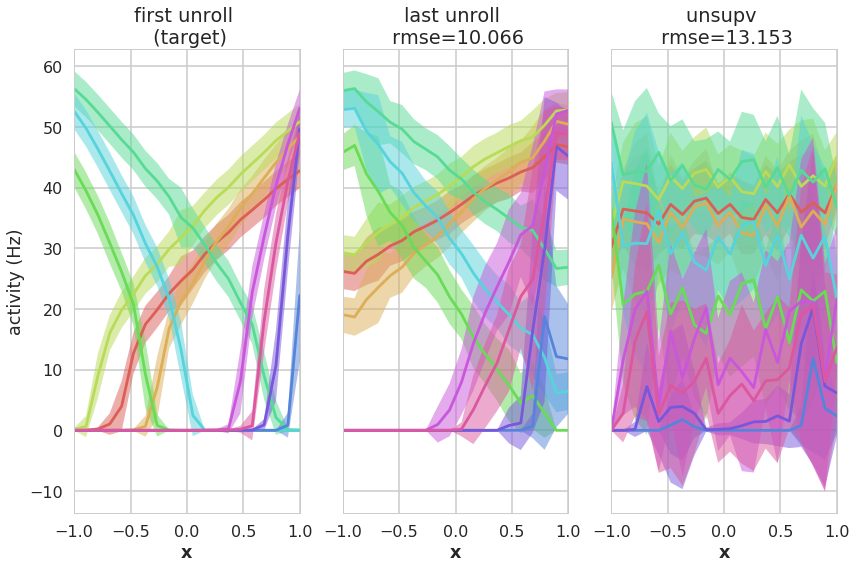

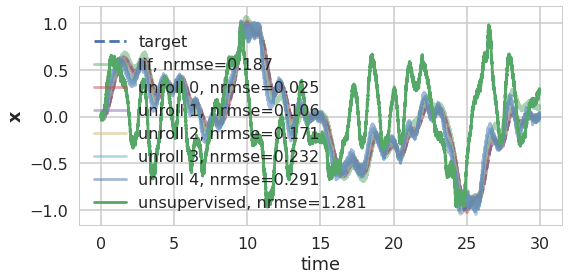

testing


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

<IPython.core.display.Javascript object>

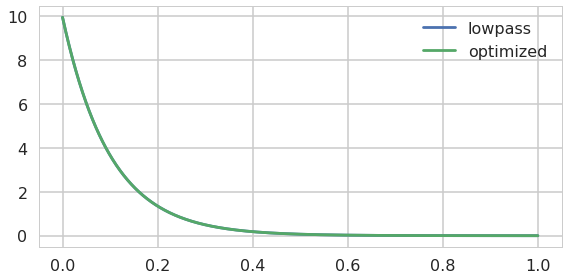

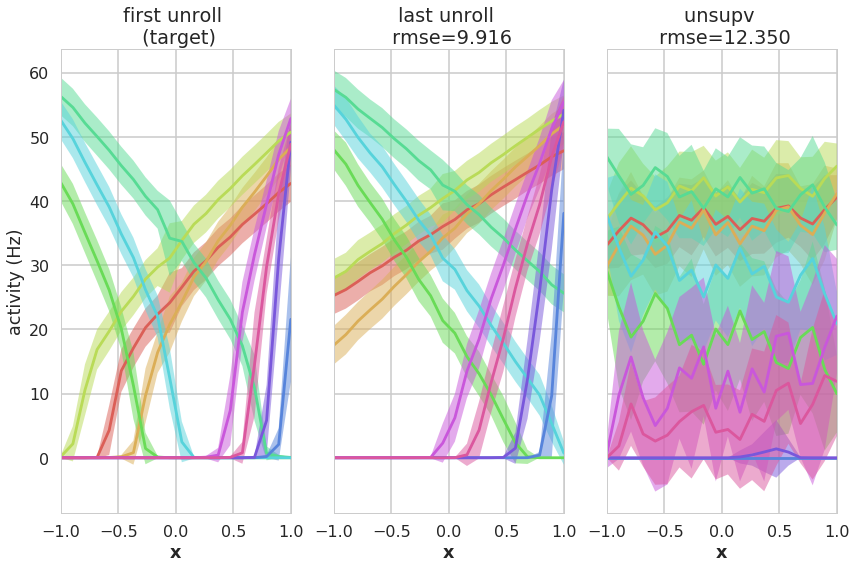

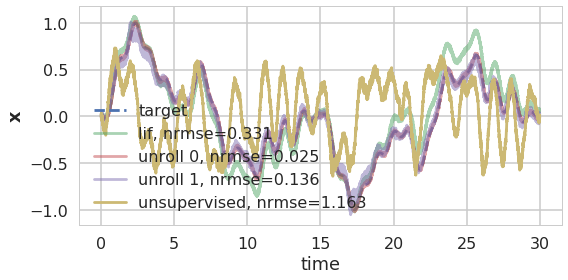

In [117]:
kwargs = dict(
    t=30,
    dt=0.00005,
    dt_sample=0.001,
    n_neurons=100,
    freq=1,
    amp=1,
    alpha=1,
    beta=1,
    max_rates=Uniform(40, 60),
    neuron_type=WilsonNeuron(),
    taus={'network': 0.1, 'readout': 0.1},
    seeds={'ns': 1, 'ss':2, 'es': 3, 'cs': 4, 'ls': 5},
    reg=1e-2,
    eta=0e-4,
    jl_mag=0e-6,
    n_num=1, 
    n_den=3,
    num_min=0,
    num_max=1,
    den_min=0,
    den_max=1,
    max_evals=1000)

updates = ['d_last', 'r', 'd_last', 'r', 'd_last', 'r', 'd_last', 'r', 'd_last']

d, d_pre, e, w, w_pre, h = run(updates, plot=True, signal='white_noise', **kwargs)